In [12]:
%load_ext autoreload 
%autoreload 2
%load_ext autoreload 
%autoreload 2
from remotedb import DB


from image_processor import    ltm_img_processor ,     real_images_processor
from models import ltm_predictor, discriminator
from tcng import fake_images_generator
#from  modelsUtils import fake_images_generator
import numpy as np
import tensorflow as tf
#import keras
#from keras import backend as k
import datetime
import matplotlib.pyplot as plt

try:
    from google_drive_downloader import GoogleDriveDownloader as gdd
    
except ImportError:
    !pip install googledrivedownloader
    from google_drive_downloader import GoogleDriveDownloader as gdd



# Add the ptdraft folder path to the sys.path list
##sys.path.append('/tensorify-handwriting/experiments/src/')
#from utils.toolkit import maybeCreateWorkspace


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [6]:
db_pars={"maxL":70,"hwprlabel":"lower","workspace_dir":"./data/workspace/",
         "google_file_id":"1l6sQMu4lOTGxHKqBhY9mXpI4Pd-Z6E_N",
         "google_file":"data/Approved_1_2_3_labled_v3.zip","dataset":"data/Approved_1_2_3_labled_v3/Approved",
         "p":.92,"hl":750,"wl":1600,"cl":1}
batch_size=2
db = DB(db_pars)
train_gen = db.main_generator(tr=True, batch_size=batch_size, double=True)



#train_gen =  main_generator(batch_size=10,db=train_db,h=750,w=1600)

Total # of images in the dataset:  1492
Go for training 1372
Go for validating 120


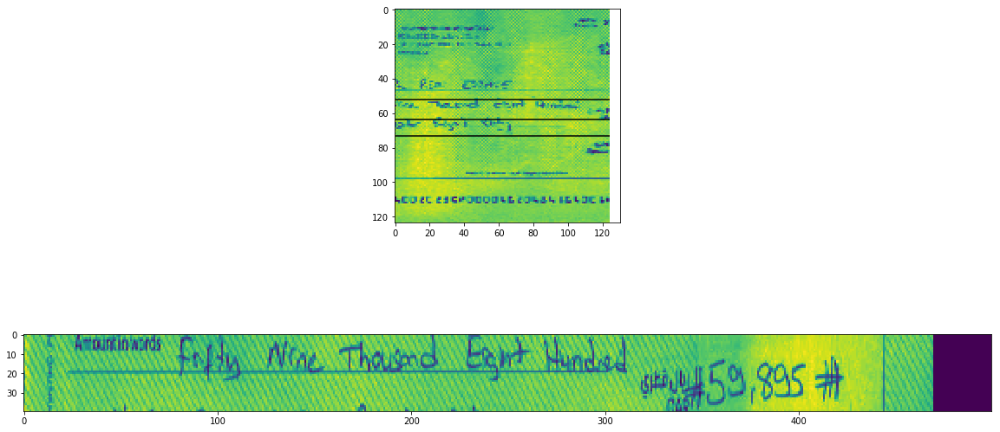

In [8]:
# test ltm_images and real images
(images, heights, widths, lines,labels,seq_lens), _ = next(train_gen)

ltm_images, l_true = ltm_img_processor(images, heights, widths,lines,double=False)
real_images =  real_images_processor(images, lines,double=False)



plt.figure(figsize=[20,10])

shape1 = ltm_images[0].shape
plt.subplot(2,1,1)
plt.imshow(np.squeeze(ltm_images[0]))
plt.hlines(shape1[0]*l_true[0,0], 0,shape1[1])
plt.hlines(shape1[0]*l_true[0,1], 0,shape1[1])
plt.hlines(shape1[0]*l_true[0,2], 0,shape1[1])


plt.subplot(2,1,2)
plt.imshow(np.squeeze(real_images[0]))





Total # of images in the dataset:  1492
Go for training 1372
Go for validating 120
images_1.shape (4, 40, 500, 1)


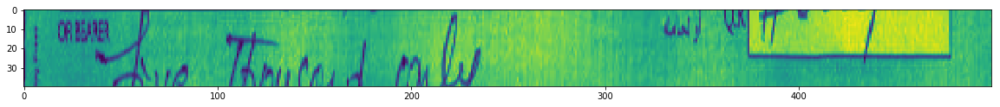

In [2]:
# test fake_images_generator() using untrained ltm_predictor()
import tensorflow as tf
import numpy as np
import  matplotlib.pylab as plt
from remotedb import DB
from image_processor import    ltm_img_processor ,     real_images_processor
from models import ltm_predictor, discriminator
from tcng import fake_images_generator

db_pars={"maxL":70,"hwprlabel":"lower","workspace_dir":"./data/workspace/",
         "google_file_id":"1l6sQMu4lOTGxHKqBhY9mXpI4Pd-Z6E_N",
         "google_file":"data/Approved_1_2_3_labled_v3.zip","dataset":"data/Approved_1_2_3_labled_v3/Approved",
         "p":.92,"hl":750,"wl":1600,"cl":1}
batch_size=2
db = DB(db_pars)
train_gen = db.main_generator(tr=True, batch_size=batch_size, double=True)

tf.reset_default_graph()

images_ph =tf.placeholder(tf.float32,[None, 750,1600,1])
heights_ph =tf.placeholder(tf.int32,[None, 1])
widths_ph =tf.placeholder(tf.int32,[None, 1])

ltm_images_ph = tf.placeholder(tf.float32,[None, 124,124,1])
l_pred = ltm_predictor(ltm_images_ph)


images_ph =tf.placeholder(tf.float32,[None, 750,1600,1])
fake_images =fake_images_generator(images_ph,heights_ph, widths_ph,l_pred, batch_size,nlines=False)

(images, heights, widths, lines,labels,seq_lens), _ = next(train_gen)

ltm_images, l_true = ltm_img_processor(images, heights, widths,lines,double=False)


ops = tf.global_variables_initializer()
with tf.Session() as sess:
    sess.run(ops)
    images_1, l_pred = sess.run(fake_images, feed_dict={ltm_images_ph:ltm_images,images_ph:images,
                                                        heights_ph:heights,widths_ph:widths})
   
print("images_1.shape",images_1.shape)
plt.figure(figsize=[20,10])
plt.subplot(2,1,1)
plt.imshow(np.squeeze(images_1[0]))



In [10]:
#Test dscriminator function with real and fake images
import tensorflow as tf
import numpy as np
import  matplotlib.pylab as plt
from remotedb import DB
from image_processor import    ltm_img_processor ,     real_images_processor
from models import ltm_predictor, discriminator
from tcng import fake_images_generator


db_pars={"maxL":70,"hwprlabel":"lower","workspace_dir":"./data/workspace/",
         "google_file_id":"1l6sQMu4lOTGxHKqBhY9mXpI4Pd-Z6E_N",
         "google_file":"data/Approved_1_2_3_labled_v3.zip","dataset":"data/Approved_1_2_3_labled_v3/Approved",
         "p":.92,"hl":750,"wl":1600,"cl":1}
batch_size=2
db = DB(db_pars)
train_gen = db.main_generator(tr=True, batch_size=batch_size, double=True)




tf.reset_default_graph()

#images, lines , ids = next(train_gen)
(images, heights, widths, lines,labels,seq_lens), _ = next(train_gen)

#ltm_images, l_true = ltm_img_processor(images,lines)

ltm_images, l_true = ltm_img_processor(images, heights, widths,lines,double=False)

#real_images =  real_images_processor(images, lines)

real_images =  real_images_processor(images, lines,double=False)






ltm_images_ph = tf.placeholder(tf.float32,[None, 124,124,1])
l_pred = ltm_predictor(ltm_images_ph)


images_ph =tf.placeholder(tf.float32,[None, 750,1600,1])
images_ph =tf.placeholder(tf.float32,[None, 750,1600,1])
heights_ph =tf.placeholder(tf.int32,[None, 1])
widths_ph =tf.placeholder(tf.int32,[None, 1])
l_true_ph =tf.placeholder(tf.float32,[None, 3])

fake_images , _ =fake_images_generator(images_ph,heights_ph, widths_ph,l_pred, batch_size,nlines=False)
real_images_gen , _ =fake_images_generator(images_ph,heights_ph, widths_ph,l_true_ph, batch_size,nlines=False)

real_images_ph = tf.placeholder(tf.float32,[None, 40,500,1])



#Dr = discriminator(real_images_ph)
Dr = discriminator(real_images_gen)
Df = discriminator(fake_images,reuse=True)
ops = tf.global_variables_initializer()

with tf.Session() as sess:
    sess.run(ops)
    
    dr, df = sess.run([Dr,Df], feed_dict={real_images_ph:real_images,images_ph:images,heights_ph:heights,
                                          widths_ph:widths,ltm_images_ph:ltm_images,l_true_ph:lines})
    print(dr, df)
    



Total # of images in the dataset:  1492
Go for training 1372
Go for validating 120
[[ 5.0756953e-06]
 [ 0.0000000e+00]
 [-7.9709753e-06]
 [ 3.3743891e-05]] [[0.01349515]
 [0.01288954]
 [0.01651192]
 [0.02137221]]


In [2]:
import tensorflow as tf
import numpy as np
import  matplotlib.pylab as plt
from remotedb import DB
from image_processor import    ltm_img_processor ,     real_images_processor
from models import ltm_predictor, discriminator
from tcng import fake_images_generator


tf.reset_default_graph()
batch_size= 2

#ltm ltm_predictor placeholders
ltm_images_ph = tf.placeholder(tf.float32,[None, 124,124,1])
l_true_ph = tf.placeholder(tf.float32,[None, 3])

#ltm_images_valid_ph = tf.placeholder(tf.float32,[None, 124,124,1])
#l_true_valid_ph = tf.placeholder(tf.float32,[None, 3])


#discriminator placeholders
real_images_ph = tf.placeholder(tf.float32,[None, 40,500,1])
images_ph =tf.placeholder(tf.float32,[None, 750,1600,1])

#with tf.variable_scope(tf.get_variable_scope(),reuse=tf.AUTO_REUSE) as scope:
 

l_pred = ltm_predictor(ltm_images_ph)
#l_pred_valid = ltm_predictor(ltm_images_valid_ph, reuse=True)

fake_images, _  = fake_images_generator(images_ph,l_pred,batch_size)
Dr = discriminator(real_images_ph)
Df = discriminator(fake_images, reuse=True)

Instructions for updating:
Use the retry module or similar alternatives.


In [3]:
d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=Dr,labels=tf.ones_like(Dr)))
d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=Df,labels=tf.zeros_like(Df)))


p_d_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=Df,labels=tf.ones_like(Df)), name='p_d_loss')
p_mse_loss = tf.reduce_mean(tf.losses.mean_squared_error(labels=l_true_ph, predictions=l_pred,weights=1.0), name='p_mse_loss')
#p_mse_loss_valid = tf.reduce_mean(tf.losses.mean_squared_error(labels=l_true_valid_ph, predictions=l_pred_valid,weights=1.0), name='p_mse_loss_valid')
p_mse_metric = tf.reduce_mean(tf.metrics.mean_squared_error(labels=l_true_ph, predictions=l_pred,weights=1.0), name='p_mse_metric')
p_total_loss = tf.add(p_d_loss, p_mse_loss, name='p_total_loss')

tvars = tf.trainable_variables()

d_vars = [var for var in tvars if 'd_' in var.name]
p_vars = [var for var in tvars if 'p_' in var.name]

#print(d_vars)
#print(p_vars)



with tf.variable_scope(tf.get_variable_scope(),reuse=tf.AUTO_REUSE) as scope:
    
    # discriminator train optimizer
    d_trainer_real= tf.train.AdamOptimizer(0.0003).minimize(d_loss_real,var_list=d_vars)
    d_trainer_fake= tf.train.AdamOptimizer(0.0003).minimize(d_loss_fake,var_list=d_vars)
    #tf.get_variable_scope().reuse_variables()


    # generator train optimizer
    p_trainer = tf.train.AdamOptimizer(0.0001).minimize(p_total_loss,var_list=p_vars)
    p_mse_trainer = tf.train.AdamOptimizer(0.0001).minimize(p_mse_loss,var_list=p_vars)


In [4]:

#tf.summary.scalar('discriminator_loss_fake',d_loss_fake)
#tf.summary.scalar('discriminator_loss_real',d_loss_real)
#tf.summary.scalar('predictor_discriminator_loss',p_d_loss)
tf.summary.scalar('predictor_mse_loss_train',p_mse_loss)

#images_for_tensorboard, _ = fake_images_generator(images_ph,l_pred,batch_size)
tf.summary.image('generated_images',fake_images,5)

merged = tf.summary.merge_all()
p_mse_loss_valid_summary = tf.summary.scalar('predictor_mse_loss_valid',p_mse_loss)
p_mse_metric_valid_summary = tf.summary.scalar('predictor_mse_metric_valid',p_mse_metric)
merged_valid = tf.summary.merge([p_mse_loss_valid_summary,p_mse_metric_valid_summary])


logdir = "tensorboard/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + "/"


In [5]:
sess = tf.Session()
sess.run(tf.global_variables_initializer())
sess.run(tf.local_variables_initializer())
writer =tf.summary.FileWriter(logdir,sess.graph)


db,  train_db, valid_db = load_dataset()
train_gen = main_generator(batch_size=batch_size,db=train_db)
valid_gen = main_generator(batch_size=batch_size,db=valid_db)

"""
# Pre-train discriminator
for i in range(300):
    
    images, lines , ids = next(gen)
    images = np.array(images)
    ltm_images, l_true = ltm_img_processor(images,lines)
    real_images =  real_images_processor(images, lines)
    
    _, __, dLossReal, dLossFake = sess.run([d_trainer_real, d_trainer_fake, d_loss_real, d_loss_fake],
                                           {real_images_ph:real_images ,images_ph:images, ltm_images_ph:ltm_images })
                                           

    if(i % 100 == 0):
        print("dLossReal:", dLossReal, "dLossFake:", dLossFake)
"""

Total # of images in the dataset:  1492
Go for training 1372
Go for validating 120


'\n# Pre-train discriminator\nfor i in range(300):\n    \n    images, lines , ids = next(gen)\n    images = np.array(images)\n    ltm_images, l_true = ltm_img_processor(images,lines)\n    real_images =  real_images_processor(images, lines)\n    \n    _, __, dLossReal, dLossFake = sess.run([d_trainer_real, d_trainer_fake, d_loss_real, d_loss_fake],\n                                           {real_images_ph:real_images ,images_ph:images, ltm_images_ph:ltm_images })\n                                           \n\n    if(i % 100 == 0):\n        print("dLossReal:", dLossReal, "dLossFake:", dLossFake)\n'

Iteration: 0 at 2019-04-11 12:16:45.720584


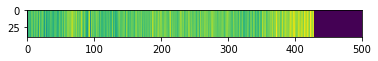

Iteration: 50 at 2019-04-11 12:16:52.874915


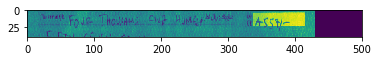

Iteration: 100 at 2019-04-11 12:17:00.044660


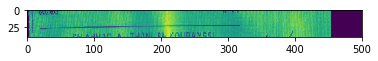

Iteration: 150 at 2019-04-11 12:17:07.173225


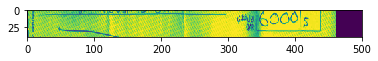

Iteration: 200 at 2019-04-11 12:17:14.282192


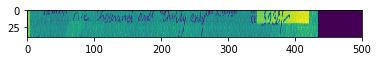

Iteration: 250 at 2019-04-11 12:17:21.337317


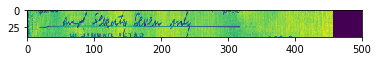

Iteration: 300 at 2019-04-11 12:17:28.440348


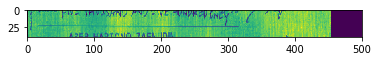

Iteration: 350 at 2019-04-11 12:17:35.448427


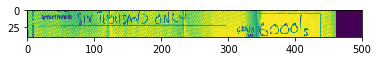

Iteration: 400 at 2019-04-11 12:17:42.776069


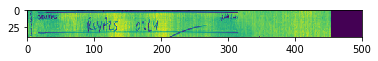

Iteration: 450 at 2019-04-11 12:17:50.037572


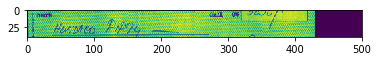

Iteration: 500 at 2019-04-11 12:17:57.365347


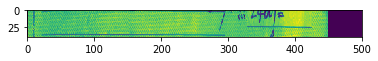

Iteration: 550 at 2019-04-11 12:18:04.597948


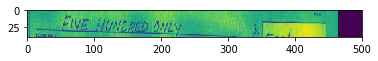

Iteration: 600 at 2019-04-11 12:18:11.935331


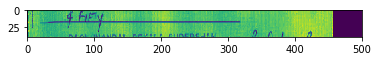

Iteration: 650 at 2019-04-11 12:18:19.144677


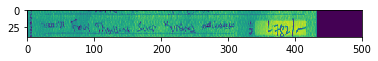

Iteration: 700 at 2019-04-11 12:18:26.344585


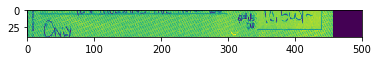

Iteration: 750 at 2019-04-11 12:18:33.398941


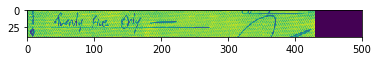

Iteration: 800 at 2019-04-11 12:18:40.665420


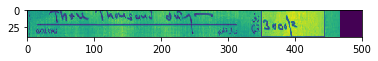

Iteration: 850 at 2019-04-11 12:18:47.716767


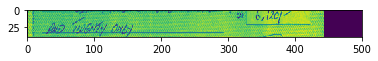

Iteration: 900 at 2019-04-11 12:18:54.921070


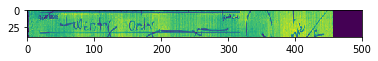

Iteration: 950 at 2019-04-11 12:19:02.314658


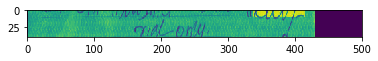

Iteration: 1000 at 2019-04-11 12:19:09.879779


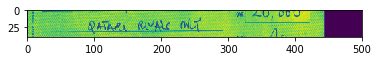

Iteration: 1050 at 2019-04-11 12:19:17.256808


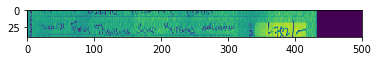

Iteration: 1100 at 2019-04-11 12:19:24.437927


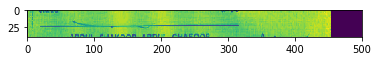

Iteration: 1150 at 2019-04-11 12:19:31.545119


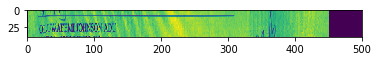

Iteration: 1200 at 2019-04-11 12:19:38.752791


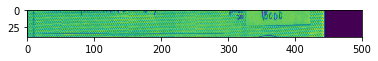

Iteration: 1250 at 2019-04-11 12:19:46.003861


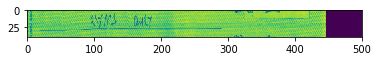

Iteration: 1300 at 2019-04-11 12:19:53.435602


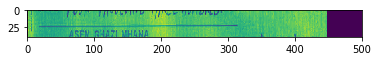

Iteration: 1350 at 2019-04-11 12:20:00.860824


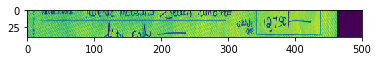

Iteration: 1400 at 2019-04-11 12:20:08.105425


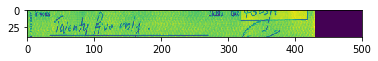

Iteration: 1450 at 2019-04-11 12:20:15.626102


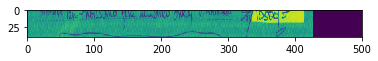

Iteration: 1500 at 2019-04-11 12:20:22.985275


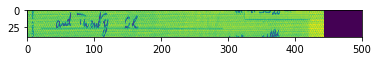

Iteration: 1550 at 2019-04-11 12:20:30.331443


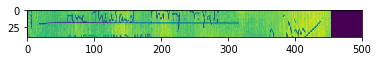

Iteration: 1600 at 2019-04-11 12:20:37.379399


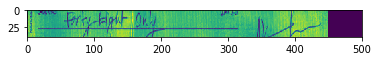

Iteration: 1650 at 2019-04-11 12:20:44.437970


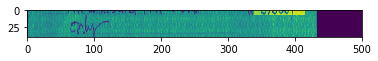

Iteration: 1700 at 2019-04-11 12:20:51.871813


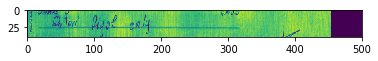

Iteration: 1750 at 2019-04-11 12:20:59.244596


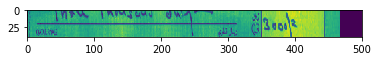

Iteration: 1800 at 2019-04-11 12:21:06.552397


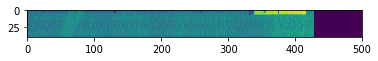

Iteration: 1850 at 2019-04-11 12:21:13.827998


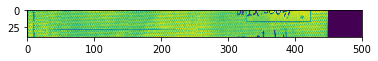

Iteration: 1900 at 2019-04-11 12:21:21.205809


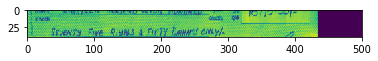

Iteration: 1950 at 2019-04-11 12:21:28.322543


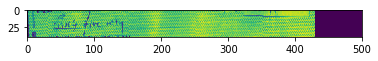

Iteration: 2000 at 2019-04-11 12:21:35.424175


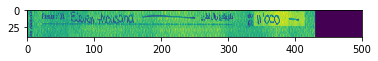

Iteration: 2050 at 2019-04-11 12:21:42.575819


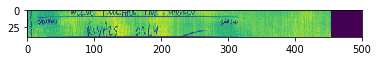

Iteration: 2100 at 2019-04-11 12:21:49.786992


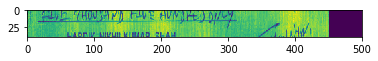

Iteration: 2150 at 2019-04-11 12:21:57.004881


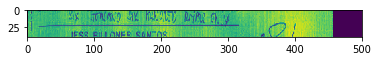

Iteration: 2200 at 2019-04-11 12:22:04.124427


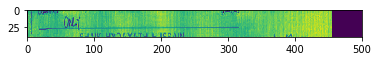

Iteration: 2250 at 2019-04-11 12:22:11.516860


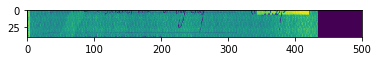

Iteration: 2300 at 2019-04-11 12:22:18.920843


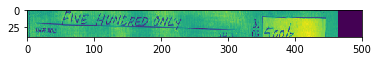

Iteration: 2350 at 2019-04-11 12:22:26.195061


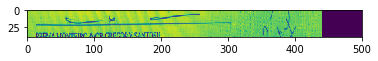

Iteration: 2400 at 2019-04-11 12:22:33.517451


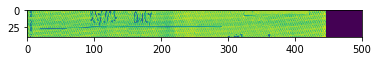

Iteration: 2450 at 2019-04-11 12:22:40.676400


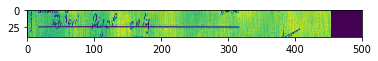

Iteration: 2500 at 2019-04-11 12:22:47.895410


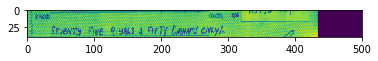

Iteration: 2550 at 2019-04-11 12:22:55.164096


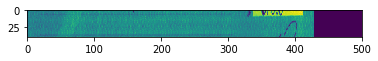

Iteration: 2600 at 2019-04-11 12:23:02.510932


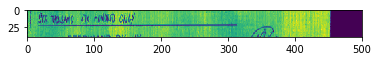

Iteration: 2650 at 2019-04-11 12:23:09.744842


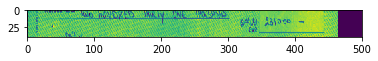

Iteration: 2700 at 2019-04-11 12:23:16.919354


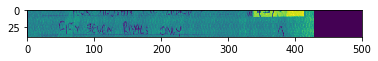

Iteration: 2750 at 2019-04-11 12:23:24.091289


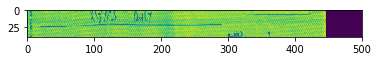

Iteration: 2800 at 2019-04-11 12:23:31.385583


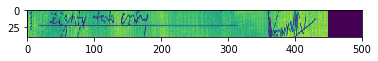

Iteration: 2850 at 2019-04-11 12:23:38.749427


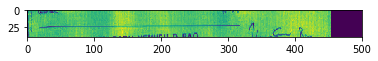

Iteration: 2900 at 2019-04-11 12:23:46.099744


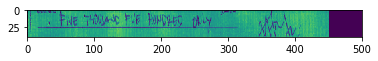

Iteration: 2950 at 2019-04-11 12:23:53.286141


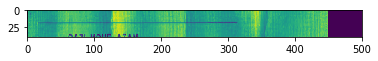

Iteration: 3000 at 2019-04-11 12:24:00.711620


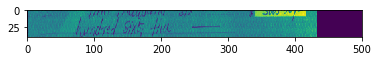

Iteration: 3050 at 2019-04-11 12:24:08.027959


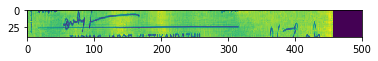

Iteration: 3100 at 2019-04-11 12:24:15.116061


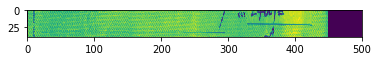

Iteration: 3150 at 2019-04-11 12:24:22.330688


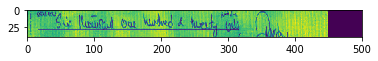

Iteration: 3200 at 2019-04-11 12:24:29.675142


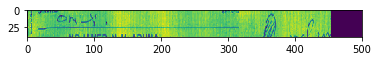

Iteration: 3250 at 2019-04-11 12:24:36.851709


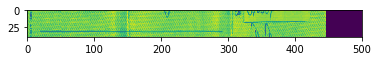

Iteration: 3300 at 2019-04-11 12:24:44.175118


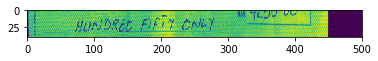

Iteration: 3350 at 2019-04-11 12:24:51.664078


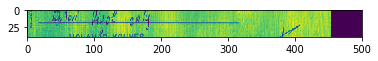

Iteration: 3400 at 2019-04-11 12:24:58.930074


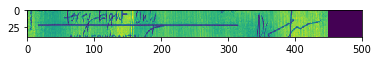

Iteration: 3450 at 2019-04-11 12:25:06.308387


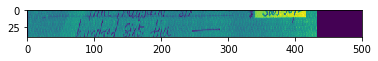

Iteration: 3500 at 2019-04-11 12:25:13.717939


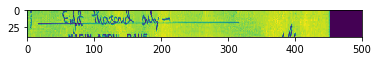

Iteration: 3550 at 2019-04-11 12:25:20.955092


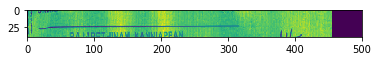

Iteration: 3600 at 2019-04-11 12:25:28.229434


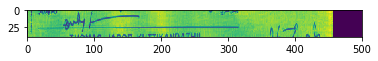

Iteration: 3650 at 2019-04-11 12:25:35.756320


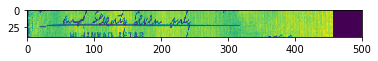

Iteration: 3700 at 2019-04-11 12:25:43.254515


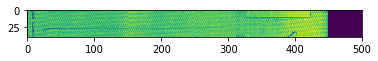

Iteration: 3750 at 2019-04-11 12:25:50.923620


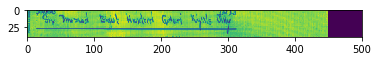

Iteration: 3800 at 2019-04-11 12:25:58.556204


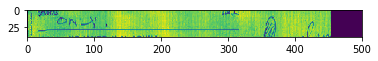

Iteration: 3850 at 2019-04-11 12:26:06.059722


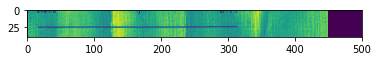

Iteration: 3900 at 2019-04-11 12:26:13.420237


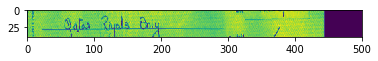

Iteration: 3950 at 2019-04-11 12:26:20.716637


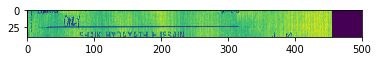

Iteration: 4000 at 2019-04-11 12:26:28.110743


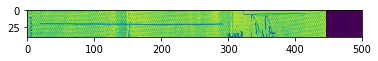

Iteration: 4050 at 2019-04-11 12:26:35.434253


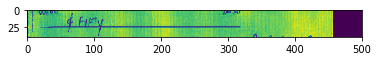

Iteration: 4100 at 2019-04-11 12:26:42.727883


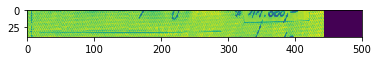

Iteration: 4150 at 2019-04-11 12:26:50.103069


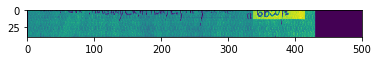

Iteration: 4200 at 2019-04-11 12:26:57.437920


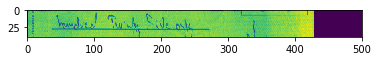

Iteration: 4250 at 2019-04-11 12:27:04.687658


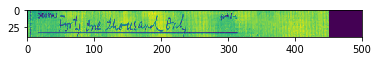

Iteration: 4300 at 2019-04-11 12:27:11.924784


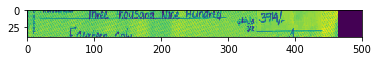

Iteration: 4350 at 2019-04-11 12:27:19.277425


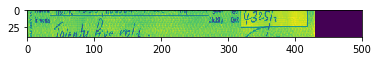

Iteration: 4400 at 2019-04-11 12:27:26.569933


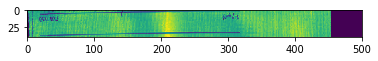

Iteration: 4450 at 2019-04-11 12:27:34.110015


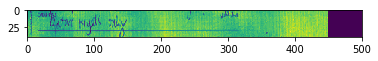

Iteration: 4500 at 2019-04-11 12:27:41.388363


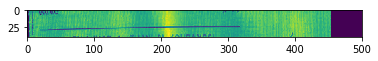

Iteration: 4550 at 2019-04-11 12:27:48.738806


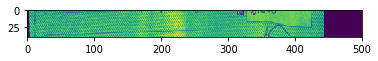

Iteration: 4600 at 2019-04-11 12:27:56.393813


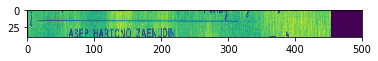

Iteration: 4650 at 2019-04-11 12:28:03.745247


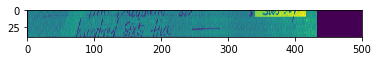

Iteration: 4700 at 2019-04-11 12:28:11.055458


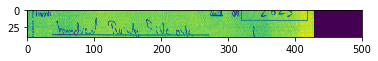

Iteration: 4750 at 2019-04-11 12:28:18.406378


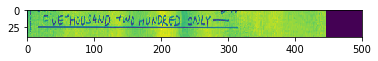

Iteration: 4800 at 2019-04-11 12:28:25.789510


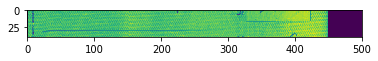

Iteration: 4850 at 2019-04-11 12:28:33.153870


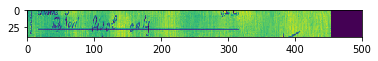

Iteration: 4900 at 2019-04-11 12:28:40.759852


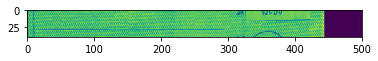

Iteration: 4950 at 2019-04-11 12:28:48.376295


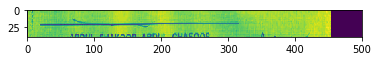

Iteration: 5000 at 2019-04-11 12:28:55.967258


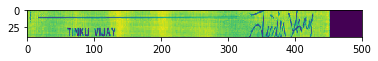

Iteration: 5050 at 2019-04-11 12:29:03.525140


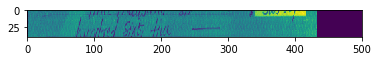

Iteration: 5100 at 2019-04-11 12:29:10.922185


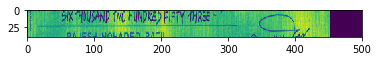

Iteration: 5150 at 2019-04-11 12:29:18.307803


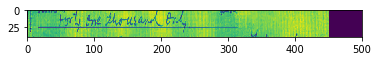

Iteration: 5200 at 2019-04-11 12:29:25.676308


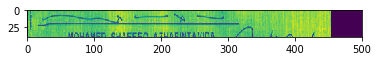

Iteration: 5250 at 2019-04-11 12:29:33.091070


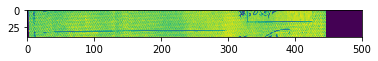

Iteration: 5300 at 2019-04-11 12:29:40.474783


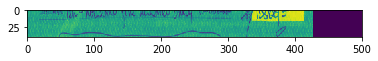

Iteration: 5350 at 2019-04-11 12:29:47.836505


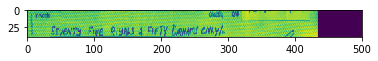

Iteration: 5400 at 2019-04-11 12:29:55.246157


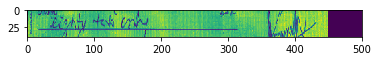

Iteration: 5450 at 2019-04-11 12:30:02.768420


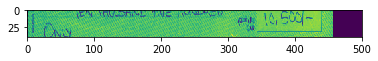

Iteration: 5500 at 2019-04-11 12:30:10.211085


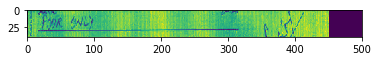

Iteration: 5550 at 2019-04-11 12:30:17.586369


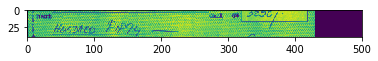

Iteration: 5600 at 2019-04-11 12:30:24.962496


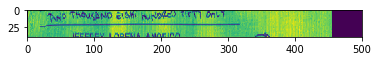

Iteration: 5650 at 2019-04-11 12:30:32.307030


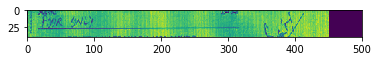

Iteration: 5700 at 2019-04-11 12:30:39.735857


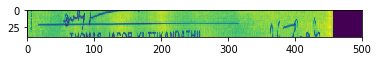

Iteration: 5750 at 2019-04-11 12:30:47.258598


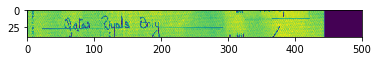

Iteration: 5800 at 2019-04-11 12:30:54.822418


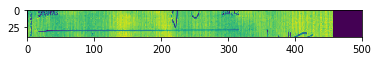

Iteration: 5850 at 2019-04-11 12:31:02.384311


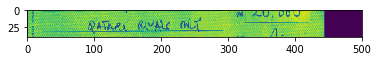

Iteration: 5900 at 2019-04-11 12:31:09.815306


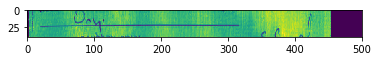

Iteration: 5950 at 2019-04-11 12:31:17.407944


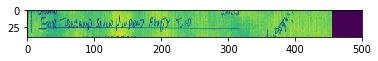

Iteration: 6000 at 2019-04-11 12:31:24.836446


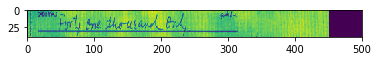

Iteration: 6050 at 2019-04-11 12:31:32.344259


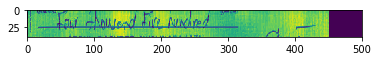

Iteration: 6100 at 2019-04-11 12:31:39.744203


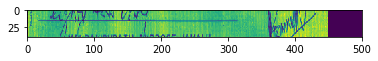

Iteration: 6150 at 2019-04-11 12:31:47.207070


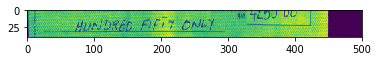

Iteration: 6200 at 2019-04-11 12:31:54.730403


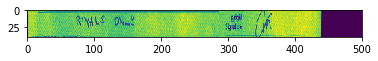

Iteration: 6250 at 2019-04-11 12:32:02.308376


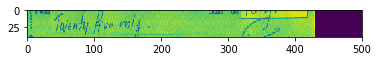

Iteration: 6300 at 2019-04-11 12:32:09.867486


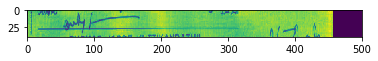

Iteration: 6350 at 2019-04-11 12:32:17.579841


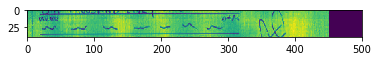

Iteration: 6400 at 2019-04-11 12:32:25.037130


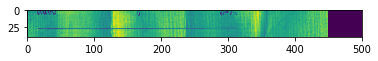

Iteration: 6450 at 2019-04-11 12:32:32.447659


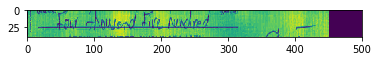

Iteration: 6500 at 2019-04-11 12:32:39.927241


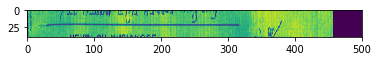

Iteration: 6550 at 2019-04-11 12:32:47.498554


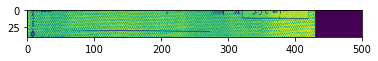

Iteration: 6600 at 2019-04-11 12:32:54.947449


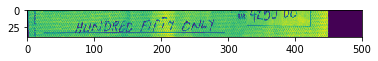

Iteration: 6650 at 2019-04-11 12:33:02.426325


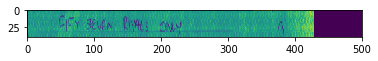

Iteration: 6700 at 2019-04-11 12:33:09.892485


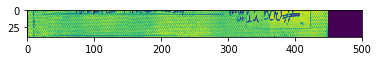

Iteration: 6750 at 2019-04-11 12:33:17.443852


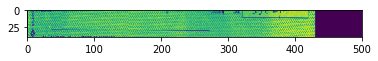

Iteration: 6800 at 2019-04-11 12:33:24.944204


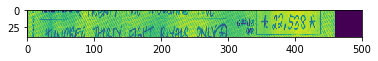

Iteration: 6850 at 2019-04-11 12:33:32.474757


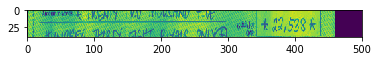

Iteration: 6900 at 2019-04-11 12:33:39.898538


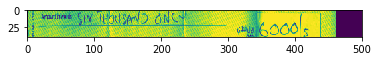

Iteration: 6950 at 2019-04-11 12:33:47.284813


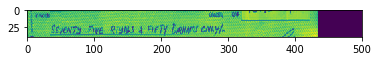

Iteration: 7000 at 2019-04-11 12:33:54.701954


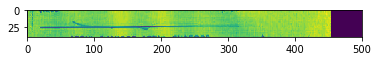

Iteration: 7050 at 2019-04-11 12:34:02.315642


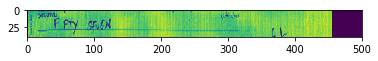

Iteration: 7100 at 2019-04-11 12:34:09.749230


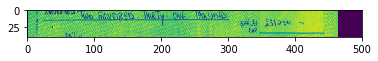

Iteration: 7150 at 2019-04-11 12:34:17.255067


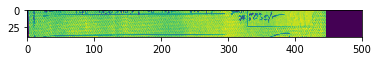

Iteration: 7200 at 2019-04-11 12:34:24.620918


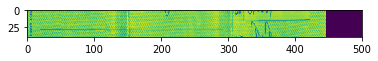

Iteration: 7250 at 2019-04-11 12:34:32.122035


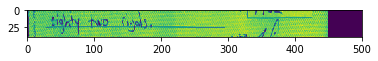

Iteration: 7300 at 2019-04-11 12:34:39.624322


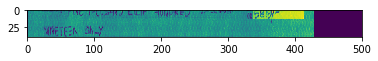

Iteration: 7350 at 2019-04-11 12:34:47.139844


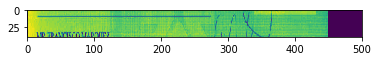

Iteration: 7400 at 2019-04-11 12:34:54.796367


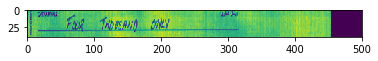

Iteration: 7450 at 2019-04-11 12:35:02.527584


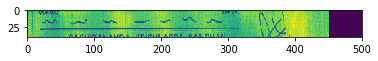

Iteration: 7500 at 2019-04-11 12:35:10.286419


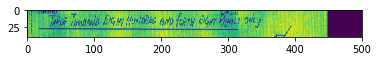

Iteration: 7550 at 2019-04-11 12:35:17.891397


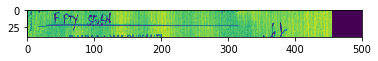

Iteration: 7600 at 2019-04-11 12:35:25.411691


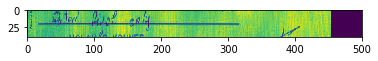

Iteration: 7650 at 2019-04-11 12:35:32.824635


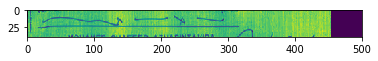

Iteration: 7700 at 2019-04-11 12:35:40.304875


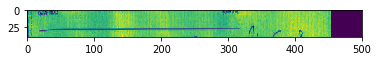

Iteration: 7750 at 2019-04-11 12:35:47.775940


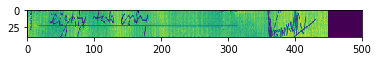

Iteration: 7800 at 2019-04-11 12:35:55.233907


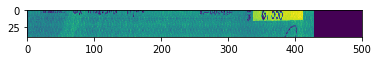

Iteration: 7850 at 2019-04-11 12:36:02.935578


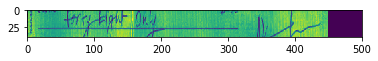

Iteration: 7900 at 2019-04-11 12:36:10.376454


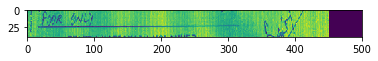

Iteration: 7950 at 2019-04-11 12:36:17.833815


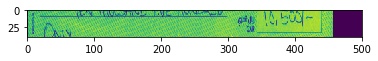

Iteration: 8000 at 2019-04-11 12:36:25.663567


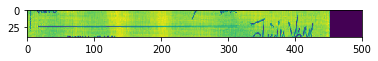

Iteration: 8050 at 2019-04-11 12:36:33.191246


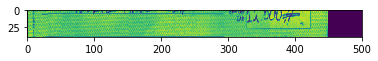

Iteration: 8100 at 2019-04-11 12:36:40.816304


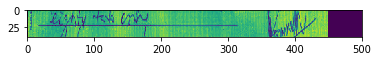

Iteration: 8150 at 2019-04-11 12:36:48.288755


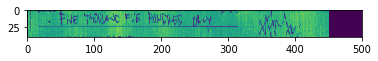

Iteration: 8200 at 2019-04-11 12:36:55.778254


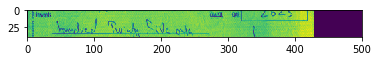

Iteration: 8250 at 2019-04-11 12:37:03.231897


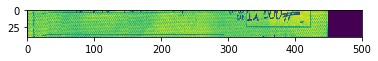

Iteration: 8300 at 2019-04-11 12:37:10.907206


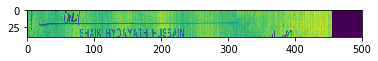

Iteration: 8350 at 2019-04-11 12:37:18.318983


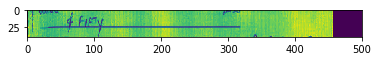

Iteration: 8400 at 2019-04-11 12:37:25.826651


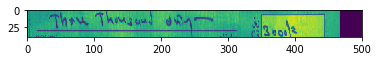

Iteration: 8450 at 2019-04-11 12:37:33.347940


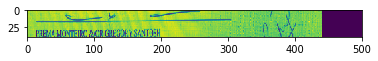

Iteration: 8500 at 2019-04-11 12:37:40.807045


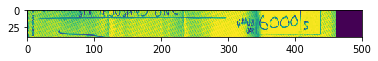

Iteration: 8550 at 2019-04-11 12:37:48.324391


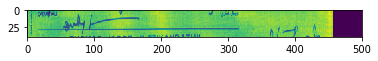

Iteration: 8600 at 2019-04-11 12:37:55.932934


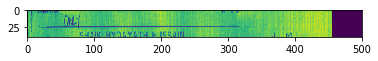

Iteration: 8650 at 2019-04-11 12:38:03.584914


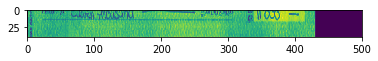

Iteration: 8700 at 2019-04-11 12:38:11.099152


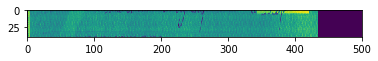

Iteration: 8750 at 2019-04-11 12:38:18.599029


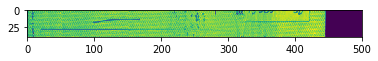

Iteration: 8800 at 2019-04-11 12:38:26.114040


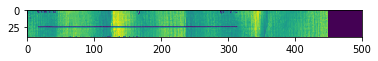

Iteration: 8850 at 2019-04-11 12:38:33.617373


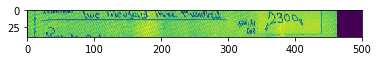

Iteration: 8900 at 2019-04-11 12:38:41.232676


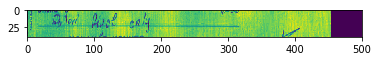

Iteration: 8950 at 2019-04-11 12:38:48.873662


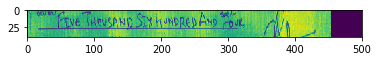

Iteration: 9000 at 2019-04-11 12:38:56.567080


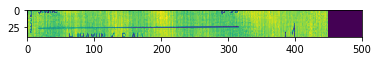

Iteration: 9050 at 2019-04-11 12:39:04.179796


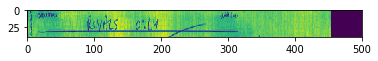

Iteration: 9100 at 2019-04-11 12:39:11.616165


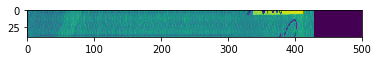

Iteration: 9150 at 2019-04-11 12:39:19.061950


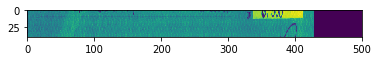

Iteration: 9200 at 2019-04-11 12:39:26.459274


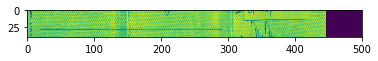

Iteration: 9250 at 2019-04-11 12:39:33.891426


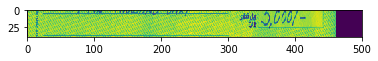

Iteration: 9300 at 2019-04-11 12:39:41.457047


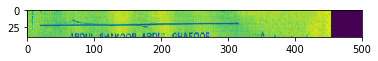

Iteration: 9350 at 2019-04-11 12:39:48.881646


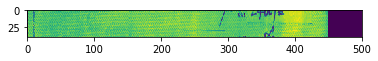

Iteration: 9400 at 2019-04-11 12:39:56.472223


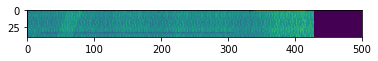

Iteration: 9450 at 2019-04-11 12:40:04.177849


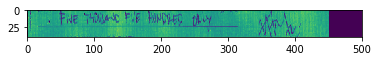

Iteration: 9500 at 2019-04-11 12:40:11.778141


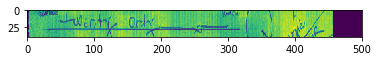

Iteration: 9550 at 2019-04-11 12:40:19.183800


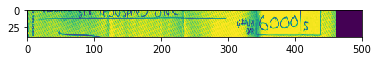

Iteration: 9600 at 2019-04-11 12:40:26.643667


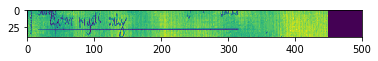

Iteration: 9650 at 2019-04-11 12:40:34.104482


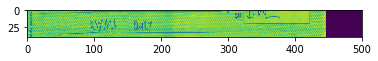

Iteration: 9700 at 2019-04-11 12:40:41.671346


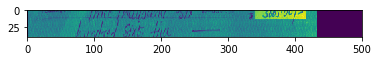

Iteration: 9750 at 2019-04-11 12:40:49.121442


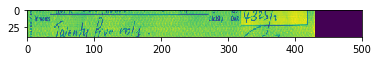

Iteration: 9800 at 2019-04-11 12:40:56.687705


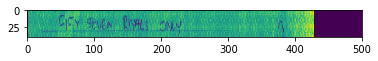

Iteration: 9850 at 2019-04-11 12:41:04.195204


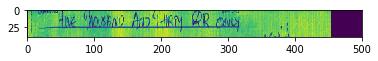

Iteration: 9900 at 2019-04-11 12:41:11.696944


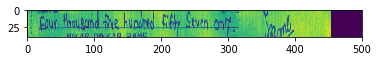

Iteration: 9950 at 2019-04-11 12:41:19.251320


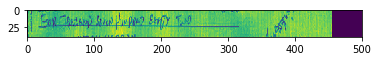

Iteration: 10000 at 2019-04-11 12:41:26.713078


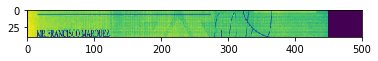

Iteration: 10050 at 2019-04-11 12:41:34.183403


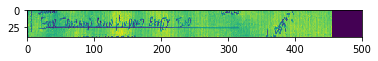

Iteration: 10100 at 2019-04-11 12:41:41.694053


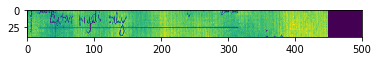

Iteration: 10150 at 2019-04-11 12:41:49.210416


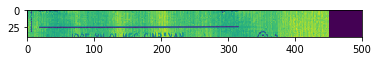

Iteration: 10200 at 2019-04-11 12:41:56.733323


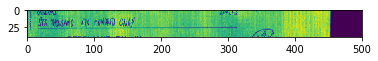

Iteration: 10250 at 2019-04-11 12:42:04.399887


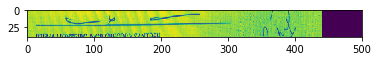

Iteration: 10300 at 2019-04-11 12:42:11.825561


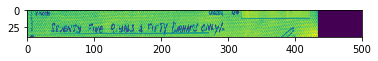

Iteration: 10350 at 2019-04-11 12:42:19.308721


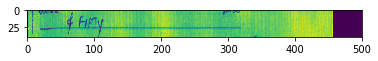

Iteration: 10400 at 2019-04-11 12:42:26.761149


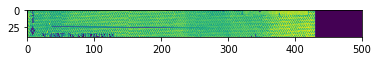

Iteration: 10450 at 2019-04-11 12:42:34.317141


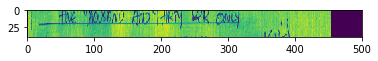

Iteration: 10500 at 2019-04-11 12:42:42.297049


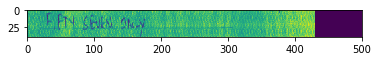

Iteration: 10550 at 2019-04-11 12:42:49.826055


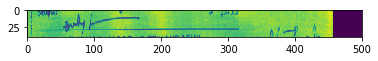

Iteration: 10600 at 2019-04-11 12:42:57.326773


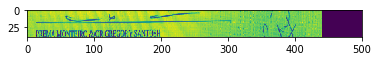

Iteration: 10650 at 2019-04-11 12:43:04.833038


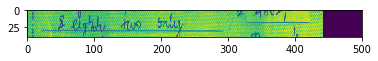

Iteration: 10700 at 2019-04-11 12:43:12.313477


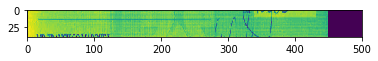

Iteration: 10750 at 2019-04-11 12:43:19.808665


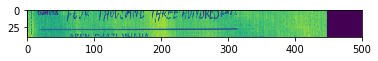

Iteration: 10800 at 2019-04-11 12:43:27.431327


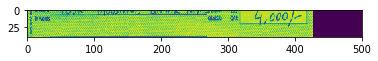

Iteration: 10850 at 2019-04-11 12:43:35.088029


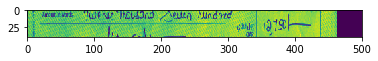

Iteration: 10900 at 2019-04-11 12:43:42.844232


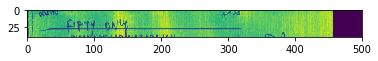

Iteration: 10950 at 2019-04-11 12:43:50.440406


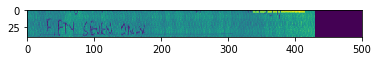

Iteration: 11000 at 2019-04-11 12:43:58.062285


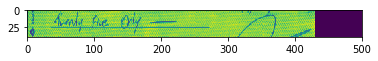

Iteration: 11050 at 2019-04-11 12:44:05.749678


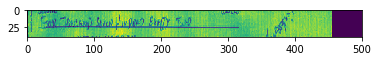

Iteration: 11100 at 2019-04-11 12:44:13.242862


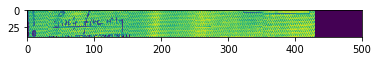

Iteration: 11150 at 2019-04-11 12:44:20.785035


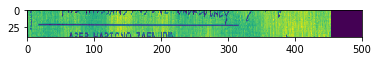

Iteration: 11200 at 2019-04-11 12:44:28.300477


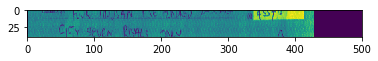

Iteration: 11250 at 2019-04-11 12:44:35.878722


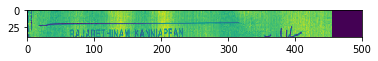

Iteration: 11300 at 2019-04-11 12:44:43.524701


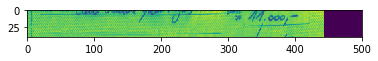

Iteration: 11350 at 2019-04-11 12:44:51.138530


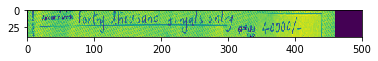

Iteration: 11400 at 2019-04-11 12:44:58.767538


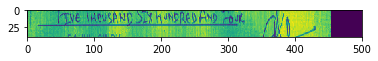

Iteration: 11450 at 2019-04-11 12:45:06.355846


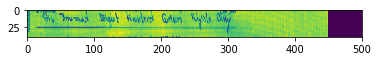

Iteration: 11500 at 2019-04-11 12:45:13.980029


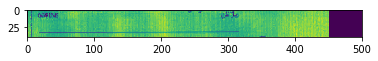

Iteration: 11550 at 2019-04-11 12:45:21.517418


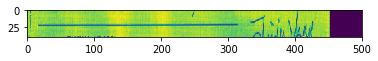

Iteration: 11600 at 2019-04-11 12:45:29.144227


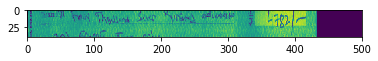

Iteration: 11650 at 2019-04-11 12:45:36.721867


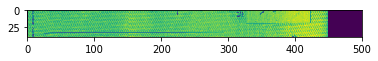

Iteration: 11700 at 2019-04-11 12:45:44.359927


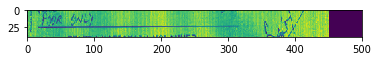

Iteration: 11750 at 2019-04-11 12:45:51.945583


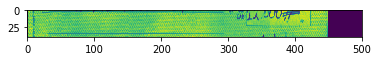

Iteration: 11800 at 2019-04-11 12:45:59.769567


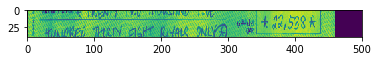

Iteration: 11850 at 2019-04-11 12:46:07.528284


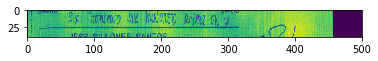

Iteration: 11900 at 2019-04-11 12:46:15.582277


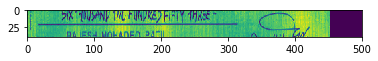

Iteration: 11950 at 2019-04-11 12:46:23.699475


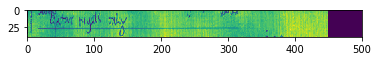

Iteration: 12000 at 2019-04-11 12:46:31.517578


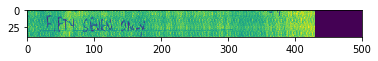

Iteration: 12050 at 2019-04-11 12:46:39.508828


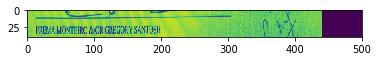

Iteration: 12100 at 2019-04-11 12:46:47.583233


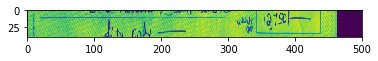

Iteration: 12150 at 2019-04-11 12:46:55.622771


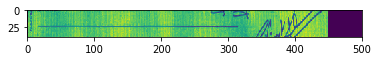

Iteration: 12200 at 2019-04-11 12:47:03.692184


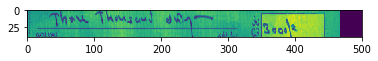

Iteration: 12250 at 2019-04-11 12:47:11.798013


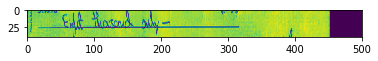

Iteration: 12300 at 2019-04-11 12:47:19.767923


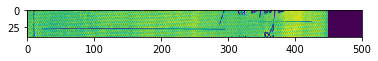

Iteration: 12350 at 2019-04-11 12:47:27.840999


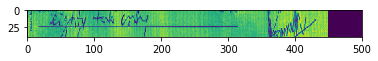

Iteration: 12400 at 2019-04-11 12:47:35.872022


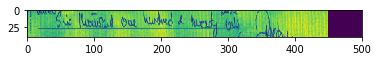

Iteration: 12450 at 2019-04-11 12:47:43.859963


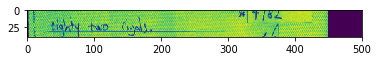

Iteration: 12500 at 2019-04-11 12:47:51.973314


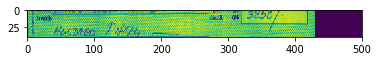

Iteration: 12550 at 2019-04-11 12:48:00.227937


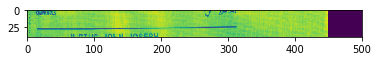

Iteration: 12600 at 2019-04-11 12:48:08.429624


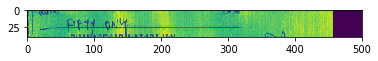

Iteration: 12650 at 2019-04-11 12:48:16.413728


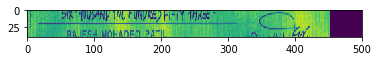

Iteration: 12700 at 2019-04-11 12:48:24.576352


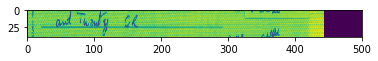

Iteration: 12750 at 2019-04-11 12:48:32.664067


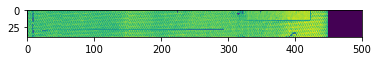

Iteration: 12800 at 2019-04-11 12:48:40.715945


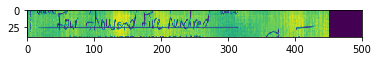

Iteration: 12850 at 2019-04-11 12:48:48.958121


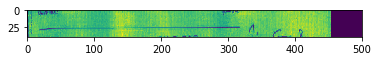

Iteration: 12900 at 2019-04-11 12:48:57.244884


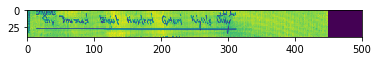

Iteration: 12950 at 2019-04-11 12:49:05.493652


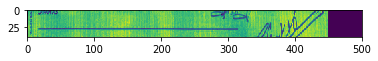

Iteration: 13000 at 2019-04-11 12:49:13.830784


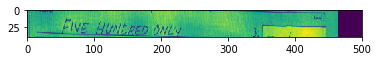

Iteration: 13050 at 2019-04-11 12:49:21.908891


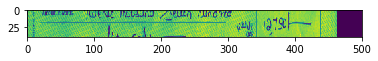

Iteration: 13100 at 2019-04-11 12:49:29.960530


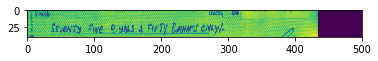

Iteration: 13150 at 2019-04-11 12:49:37.980422


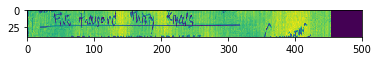

Iteration: 13200 at 2019-04-11 12:49:46.005915


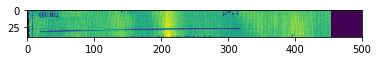

Iteration: 13250 at 2019-04-11 12:49:54.057875


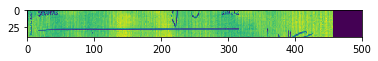

Iteration: 13300 at 2019-04-11 12:50:02.252756


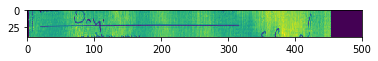

Iteration: 13350 at 2019-04-11 12:50:10.420717


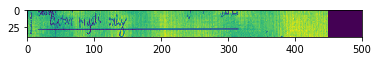

Iteration: 13400 at 2019-04-11 12:50:18.458482


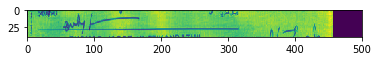

Iteration: 13450 at 2019-04-11 12:50:26.606431


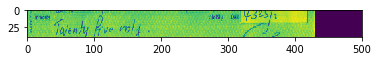

Iteration: 13500 at 2019-04-11 12:50:34.688011


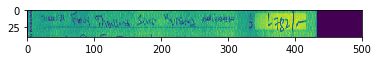

Iteration: 13550 at 2019-04-11 12:50:42.683562


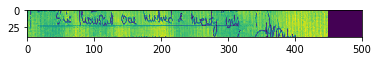

Iteration: 13600 at 2019-04-11 12:50:50.792805


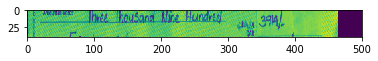

Iteration: 13650 at 2019-04-11 12:50:58.845719


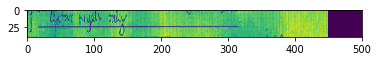

Iteration: 13700 at 2019-04-11 12:51:06.865258


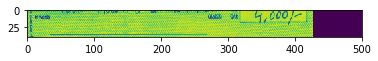

Iteration: 13750 at 2019-04-11 12:51:14.922900


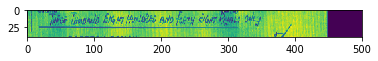

Iteration: 13800 at 2019-04-11 12:51:22.935976


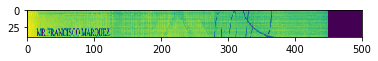

Iteration: 13850 at 2019-04-11 12:51:31.075327


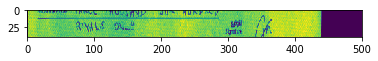

Iteration: 13900 at 2019-04-11 12:51:39.202535


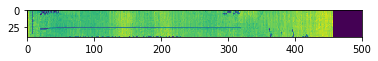

Iteration: 13950 at 2019-04-11 12:51:47.181951


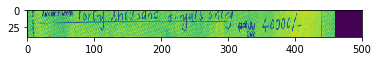

Iteration: 14000 at 2019-04-11 12:51:55.214868


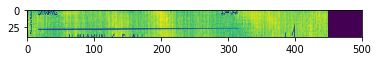

Iteration: 14050 at 2019-04-11 12:52:03.638646


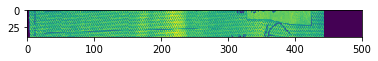

Iteration: 14100 at 2019-04-11 12:52:11.838239


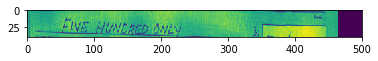

Iteration: 14150 at 2019-04-11 12:52:19.989066


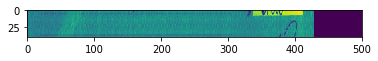

Iteration: 14200 at 2019-04-11 12:52:28.189502


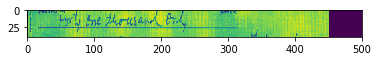

Iteration: 14250 at 2019-04-11 12:52:36.165467


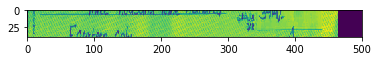

Iteration: 14300 at 2019-04-11 12:52:44.272868


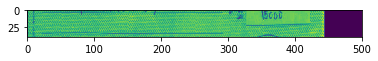

Iteration: 14350 at 2019-04-11 12:52:52.326529


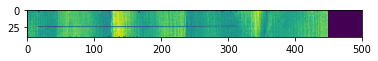

Iteration: 14400 at 2019-04-11 12:53:00.352746


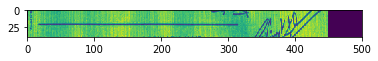

Iteration: 14450 at 2019-04-11 12:53:08.343500


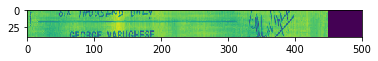

Iteration: 14500 at 2019-04-11 12:53:16.547546


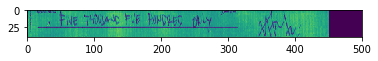

Iteration: 14550 at 2019-04-11 12:53:24.693393


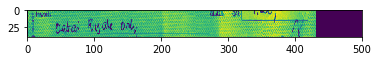

Iteration: 14600 at 2019-04-11 12:53:32.876986


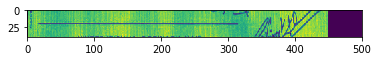

Iteration: 14650 at 2019-04-11 12:53:40.966301


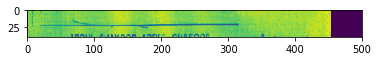

Iteration: 14700 at 2019-04-11 12:53:48.934860


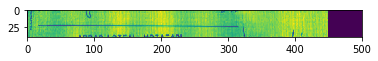

Iteration: 14750 at 2019-04-11 12:53:57.144303


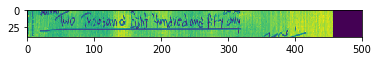

Iteration: 14800 at 2019-04-11 12:54:05.329871


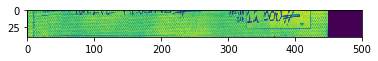

Iteration: 14850 at 2019-04-11 12:54:13.377129


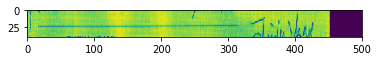

Iteration: 14900 at 2019-04-11 12:54:21.507104


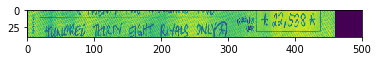

Iteration: 14950 at 2019-04-11 12:54:29.552652


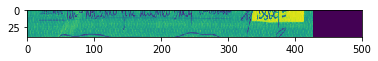

Iteration: 15000 at 2019-04-11 12:54:37.640241


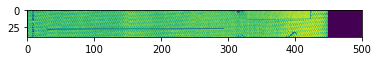

Iteration: 15050 at 2019-04-11 12:54:45.755331


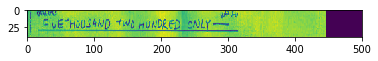

Iteration: 15100 at 2019-04-11 12:54:53.774407


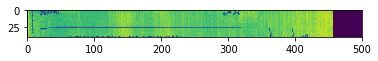

Iteration: 15150 at 2019-04-11 12:55:01.771717


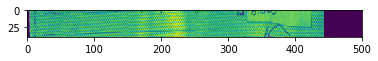

Iteration: 15200 at 2019-04-11 12:55:09.827523


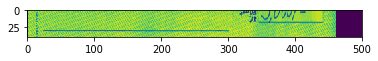

Iteration: 15250 at 2019-04-11 12:55:17.747592


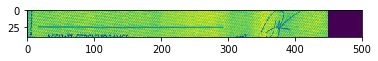

Iteration: 15300 at 2019-04-11 12:55:25.890853


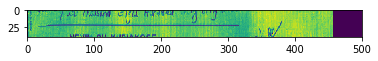

Iteration: 15350 at 2019-04-11 12:55:33.947797


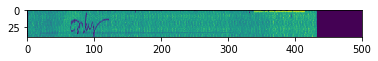

Iteration: 15400 at 2019-04-11 12:55:41.982879


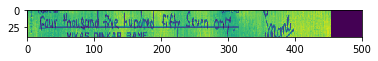

Iteration: 15450 at 2019-04-11 12:55:50.054836


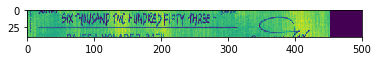

Iteration: 15500 at 2019-04-11 12:55:58.256938


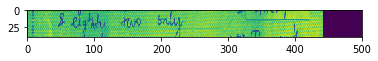

Iteration: 15550 at 2019-04-11 12:56:06.255284


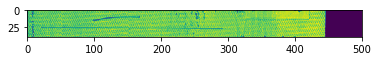

Iteration: 15600 at 2019-04-11 12:56:14.271270


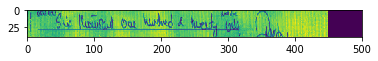

Iteration: 15650 at 2019-04-11 12:56:22.429538


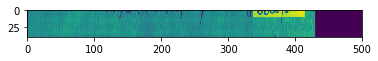

Iteration: 15700 at 2019-04-11 12:56:30.623298


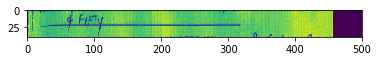

Iteration: 15750 at 2019-04-11 12:56:38.691291


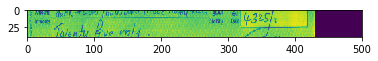

Iteration: 15800 at 2019-04-11 12:56:46.748665


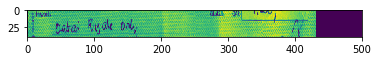

Iteration: 15850 at 2019-04-11 12:56:55.269250


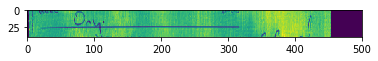

Iteration: 15900 at 2019-04-11 12:57:03.457393


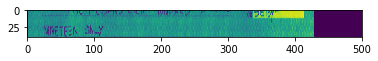

Iteration: 15950 at 2019-04-11 12:57:11.455273


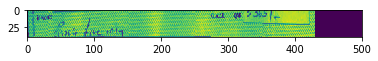

Iteration: 16000 at 2019-04-11 12:57:19.551256


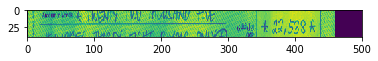

Iteration: 16050 at 2019-04-11 12:57:27.649615


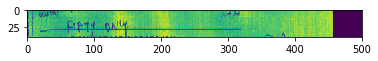

Iteration: 16100 at 2019-04-11 12:57:35.805957


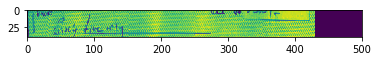

Iteration: 16150 at 2019-04-11 12:57:43.965584


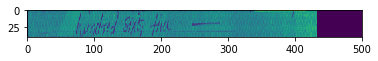

Iteration: 16200 at 2019-04-11 12:57:52.126362


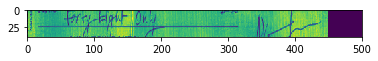

Iteration: 16250 at 2019-04-11 12:58:00.325350


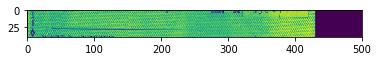

Iteration: 16300 at 2019-04-11 12:58:08.441570


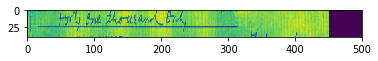

Iteration: 16350 at 2019-04-11 12:58:16.554239


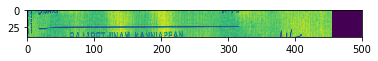

Iteration: 16400 at 2019-04-11 12:58:24.606869


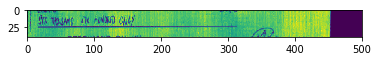

Iteration: 16450 at 2019-04-11 12:58:32.654373


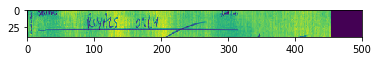

Iteration: 16500 at 2019-04-11 12:58:40.719667


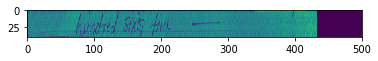

Iteration: 16550 at 2019-04-11 12:58:49.006550


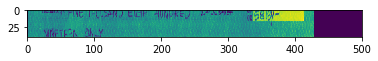

Iteration: 16600 at 2019-04-11 12:58:57.272115


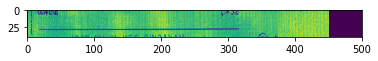

Iteration: 16650 at 2019-04-11 12:59:05.429310


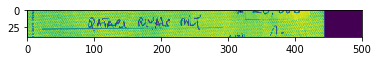

Iteration: 16700 at 2019-04-11 12:59:13.582981


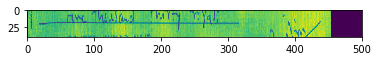

Iteration: 16750 at 2019-04-11 12:59:21.662853


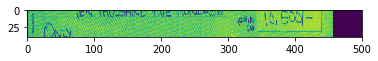

Iteration: 16800 at 2019-04-11 12:59:29.829311


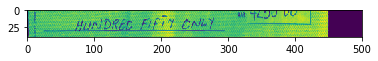

Iteration: 16850 at 2019-04-11 12:59:38.000492


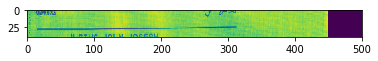

Iteration: 16900 at 2019-04-11 12:59:46.062086


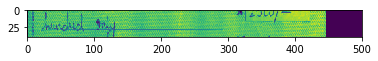

Iteration: 16950 at 2019-04-11 12:59:54.252065


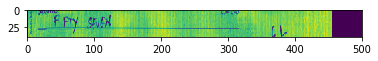

Iteration: 17000 at 2019-04-11 13:00:02.516891


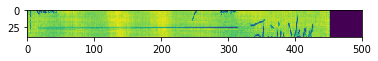

Iteration: 17050 at 2019-04-11 13:00:10.645235


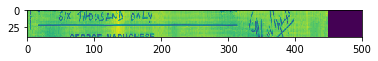

Iteration: 17100 at 2019-04-11 13:00:18.810164


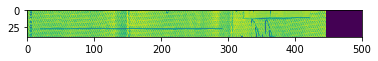

Iteration: 17150 at 2019-04-11 13:00:26.938231


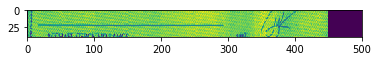

Iteration: 17200 at 2019-04-11 13:00:35.050578


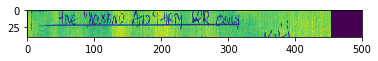

Iteration: 17250 at 2019-04-11 13:00:43.169413


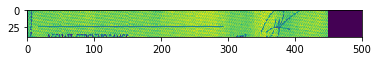

Iteration: 17300 at 2019-04-11 13:00:51.361580


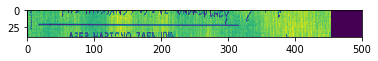

Iteration: 17350 at 2019-04-11 13:00:59.490367


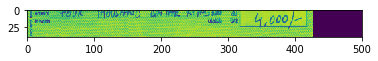

Iteration: 17400 at 2019-04-11 13:01:07.613127


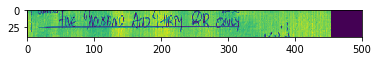

Iteration: 17450 at 2019-04-11 13:01:15.777576


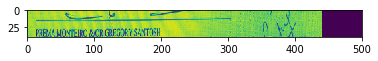

Iteration: 17500 at 2019-04-11 13:01:23.970357


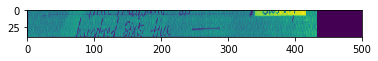

Iteration: 17550 at 2019-04-11 13:01:32.159153


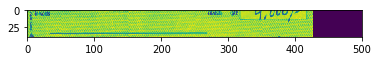

Iteration: 17600 at 2019-04-11 13:01:40.496014


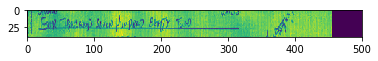

Iteration: 17650 at 2019-04-11 13:01:48.812582


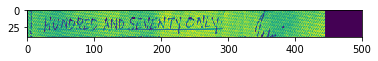

Iteration: 17700 at 2019-04-11 13:01:57.039107


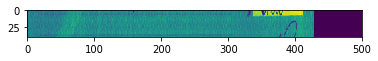

Iteration: 17750 at 2019-04-11 13:02:05.324276


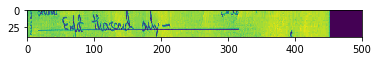

Iteration: 17800 at 2019-04-11 13:02:13.482021


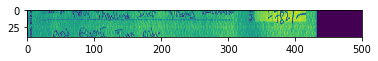

Iteration: 17850 at 2019-04-11 13:02:21.600343


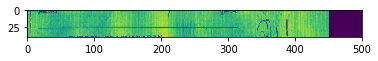

Iteration: 17900 at 2019-04-11 13:02:29.699259


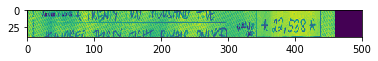

Iteration: 17950 at 2019-04-11 13:02:37.860892


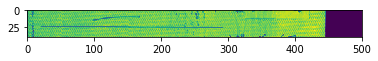

Iteration: 18000 at 2019-04-11 13:02:46.045184


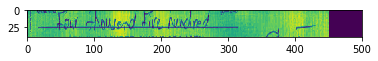

Iteration: 18050 at 2019-04-11 13:02:54.377467


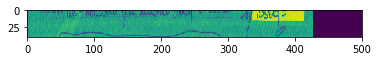

Iteration: 18100 at 2019-04-11 13:03:02.669424


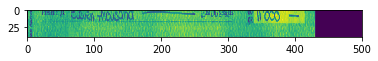

Iteration: 18150 at 2019-04-11 13:03:11.413676


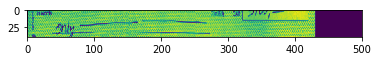

Iteration: 18200 at 2019-04-11 13:03:19.590359


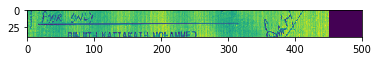

Iteration: 18250 at 2019-04-11 13:03:27.718731


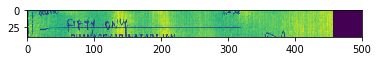

Iteration: 18300 at 2019-04-11 13:03:35.834708


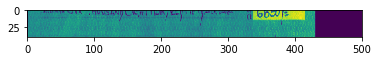

Iteration: 18350 at 2019-04-11 13:03:44.052918


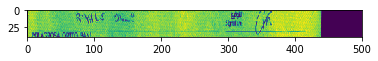

Iteration: 18400 at 2019-04-11 13:03:52.118822


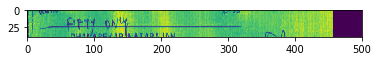

Iteration: 18450 at 2019-04-11 13:04:00.372482


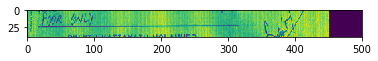

Iteration: 18500 at 2019-04-11 13:04:08.588216


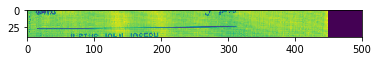

Iteration: 18550 at 2019-04-11 13:04:16.795845


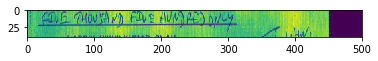

Iteration: 18600 at 2019-04-11 13:04:24.835221


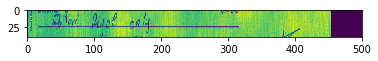

Iteration: 18650 at 2019-04-11 13:04:32.958689


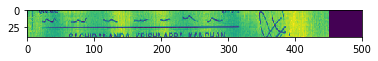

Iteration: 18700 at 2019-04-11 13:04:41.028689


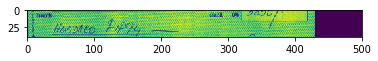

Iteration: 18750 at 2019-04-11 13:04:49.144459


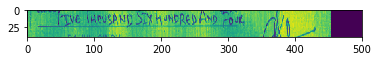

Iteration: 18800 at 2019-04-11 13:04:57.210452


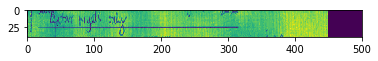

Iteration: 18850 at 2019-04-11 13:05:05.380880


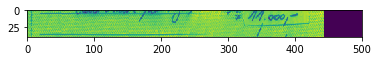

Iteration: 18900 at 2019-04-11 13:05:13.578932


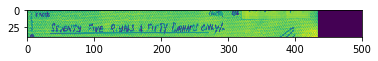

Iteration: 18950 at 2019-04-11 13:05:21.681342


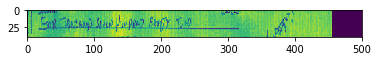

Iteration: 19000 at 2019-04-11 13:05:29.932471


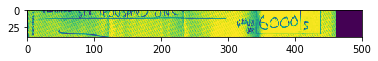

Iteration: 19050 at 2019-04-11 13:05:38.555746


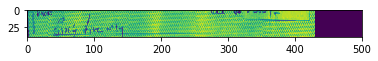

Iteration: 19100 at 2019-04-11 13:05:46.902852


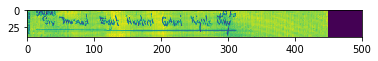

Iteration: 19150 at 2019-04-11 13:05:55.145546


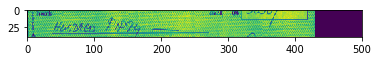

Iteration: 19200 at 2019-04-11 13:06:03.559509


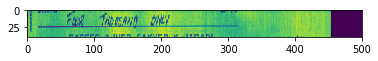

Iteration: 19250 at 2019-04-11 13:06:11.860010


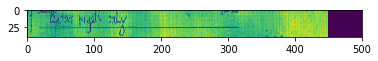

Iteration: 19300 at 2019-04-11 13:06:20.172684


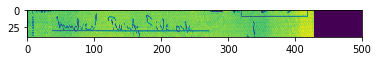

Iteration: 19350 at 2019-04-11 13:06:28.520092


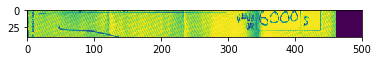

Iteration: 19400 at 2019-04-11 13:06:36.555851


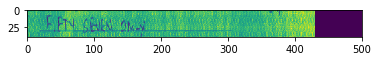

Iteration: 19450 at 2019-04-11 13:06:44.645131


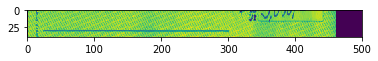

Iteration: 19500 at 2019-04-11 13:06:52.808666


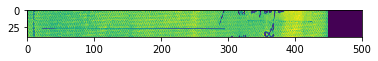

Iteration: 19550 at 2019-04-11 13:07:01.050005


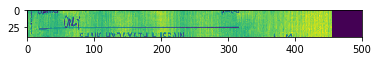

Iteration: 19600 at 2019-04-11 13:07:09.177783


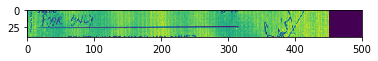

Iteration: 19650 at 2019-04-11 13:07:17.271108


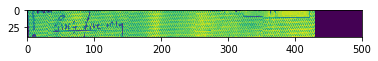

Iteration: 19700 at 2019-04-11 13:07:25.611042


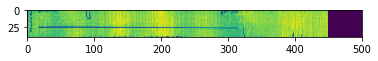

Iteration: 19750 at 2019-04-11 13:07:34.110702


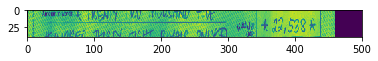

Iteration: 19800 at 2019-04-11 13:07:42.313234


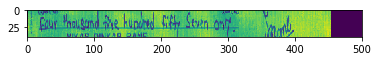

Iteration: 19850 at 2019-04-11 13:07:50.447712


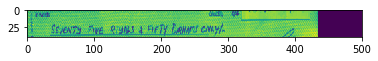

Iteration: 19900 at 2019-04-11 13:07:58.521713


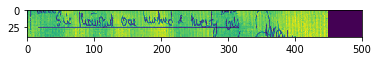

Iteration: 19950 at 2019-04-11 13:08:06.647586


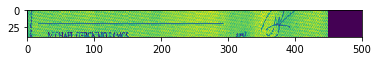

Iteration: 20000 at 2019-04-11 13:08:14.715011


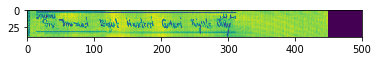

Iteration: 20050 at 2019-04-11 13:08:22.850246


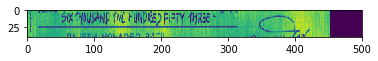

Iteration: 20100 at 2019-04-11 13:08:31.187589


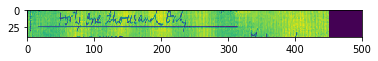

Iteration: 20150 at 2019-04-11 13:08:39.343698


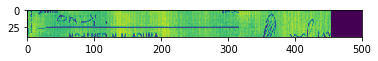

Iteration: 20200 at 2019-04-11 13:08:47.496857


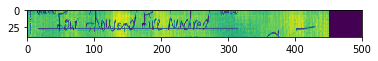

Iteration: 20250 at 2019-04-11 13:08:55.710339


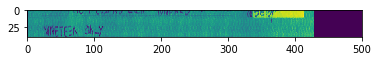

Iteration: 20300 at 2019-04-11 13:09:03.902872


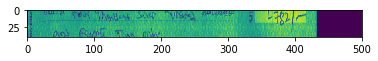

Iteration: 20350 at 2019-04-11 13:09:12.010635


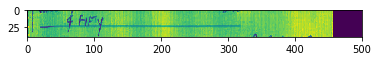

Iteration: 20400 at 2019-04-11 13:09:20.251213


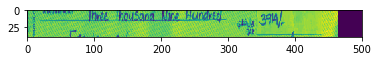

Iteration: 20450 at 2019-04-11 13:09:28.535688


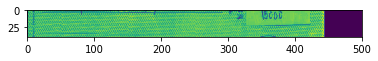

Iteration: 20500 at 2019-04-11 13:09:36.677493


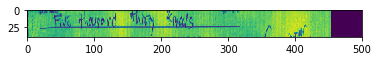

Iteration: 20550 at 2019-04-11 13:09:44.918395


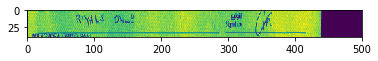

Iteration: 20600 at 2019-04-11 13:09:53.060132


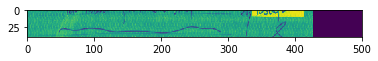

Iteration: 20650 at 2019-04-11 13:10:01.241781


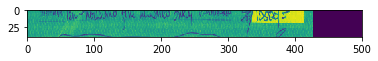

Iteration: 20700 at 2019-04-11 13:10:09.445976


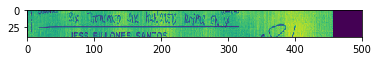

Iteration: 20750 at 2019-04-11 13:10:17.677887


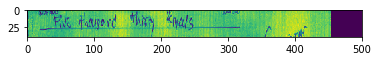

Iteration: 20800 at 2019-04-11 13:10:26.005362


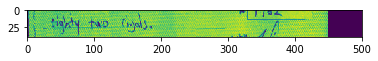

Iteration: 20850 at 2019-04-11 13:10:34.125295


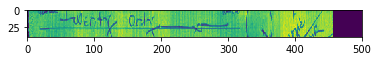

Iteration: 20900 at 2019-04-11 13:10:41.731100


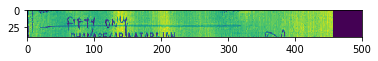

Iteration: 20950 at 2019-04-11 13:10:49.454946


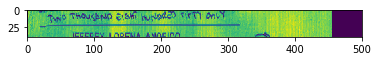

Iteration: 21000 at 2019-04-11 13:10:57.279733


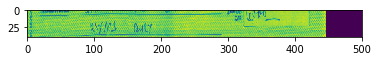

Iteration: 21050 at 2019-04-11 13:11:05.019254


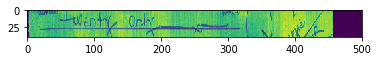

Iteration: 21100 at 2019-04-11 13:11:12.539303


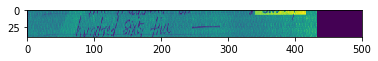

Iteration: 21150 at 2019-04-11 13:11:20.133079


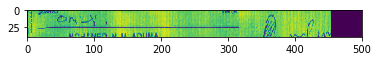

Iteration: 21200 at 2019-04-11 13:11:27.735654


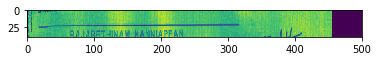

Iteration: 21250 at 2019-04-11 13:11:35.355031


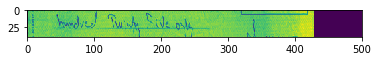

Iteration: 21300 at 2019-04-11 13:11:43.075553


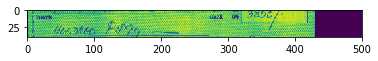

Iteration: 21350 at 2019-04-11 13:11:51.152389


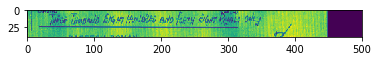

Iteration: 21400 at 2019-04-11 13:11:58.910132


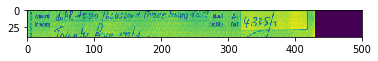

Iteration: 21450 at 2019-04-11 13:12:06.711840


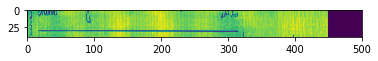

Iteration: 21500 at 2019-04-11 13:12:14.524738


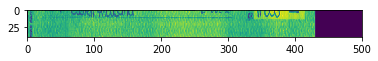

Iteration: 21550 at 2019-04-11 13:12:22.375222


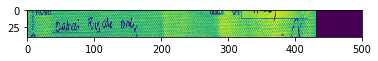

Iteration: 21600 at 2019-04-11 13:12:30.191624


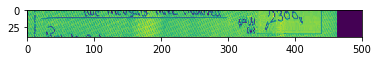

Iteration: 21650 at 2019-04-11 13:12:37.945559


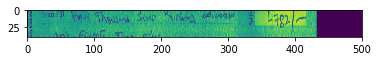

Iteration: 21700 at 2019-04-11 13:12:45.623015


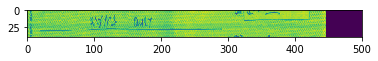

Iteration: 21750 at 2019-04-11 13:12:53.386023


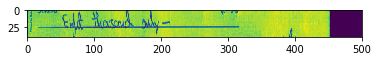

Iteration: 21800 at 2019-04-11 13:13:01.166319


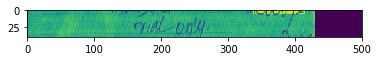

Iteration: 21850 at 2019-04-11 13:13:08.866594


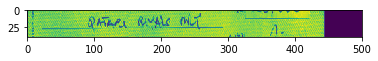

Iteration: 21900 at 2019-04-11 13:13:16.671435


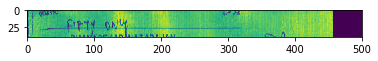

Iteration: 21950 at 2019-04-11 13:13:24.587189


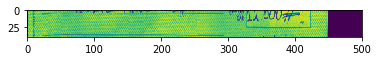

Iteration: 22000 at 2019-04-11 13:13:32.184007


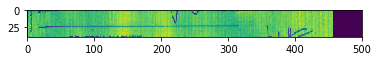

Iteration: 22050 at 2019-04-11 13:13:39.861483


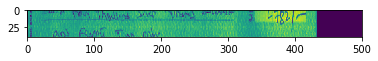

Iteration: 22100 at 2019-04-11 13:13:47.459962


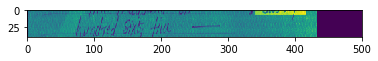

Iteration: 22150 at 2019-04-11 13:13:55.046394


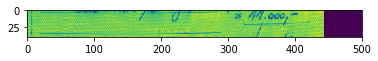

Iteration: 22200 at 2019-04-11 13:14:02.733752


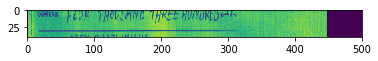

Iteration: 22250 at 2019-04-11 13:14:10.433649


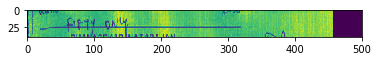

Iteration: 22300 at 2019-04-11 13:14:18.049038


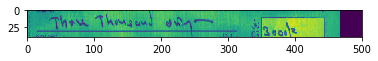

Iteration: 22350 at 2019-04-11 13:14:25.794301


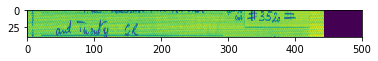

Iteration: 22400 at 2019-04-11 13:14:33.618505


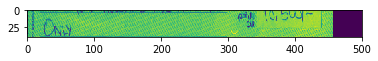

Iteration: 22450 at 2019-04-11 13:14:41.411043


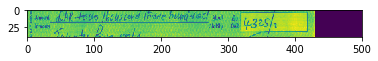

Iteration: 22500 at 2019-04-11 13:14:49.256927


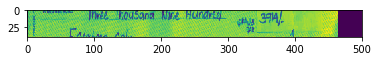

Iteration: 22550 at 2019-04-11 13:14:57.001191


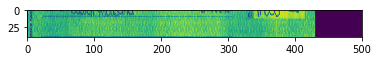

Iteration: 22600 at 2019-04-11 13:15:04.731714


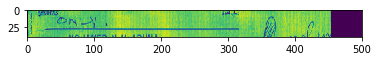

Iteration: 22650 at 2019-04-11 13:15:12.850511


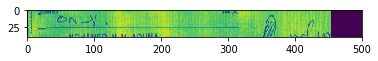

Iteration: 22700 at 2019-04-11 13:15:20.461559


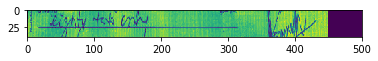

Iteration: 22750 at 2019-04-11 13:15:28.152509


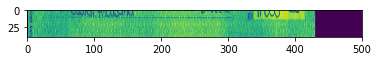

Iteration: 22800 at 2019-04-11 13:15:35.985204


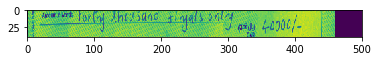

Iteration: 22850 at 2019-04-11 13:15:43.640510


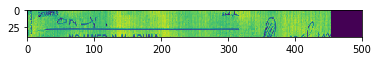

Iteration: 22900 at 2019-04-11 13:15:51.351994


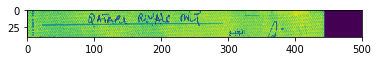

Iteration: 22950 at 2019-04-11 13:15:59.122565


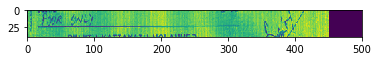

Iteration: 23000 at 2019-04-11 13:16:07.123047


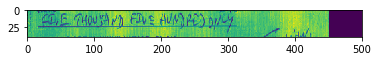

Iteration: 23050 at 2019-04-11 13:16:15.049730


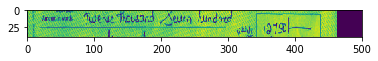

Iteration: 23100 at 2019-04-11 13:16:22.762519


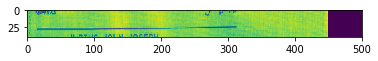

Iteration: 23150 at 2019-04-11 13:16:30.573967


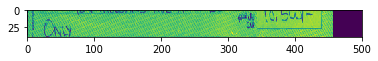

Iteration: 23200 at 2019-04-11 13:16:38.480650


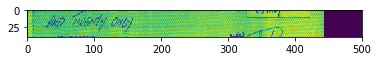

Iteration: 23250 at 2019-04-11 13:16:46.129307


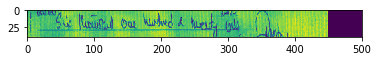

Iteration: 23300 at 2019-04-11 13:16:53.802800


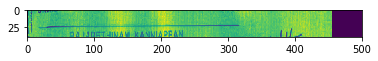

Iteration: 23350 at 2019-04-11 13:17:01.615517


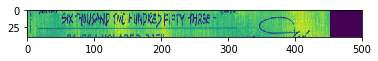

Iteration: 23400 at 2019-04-11 13:17:09.399693


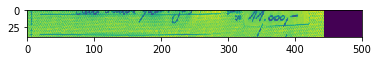

Iteration: 23450 at 2019-04-11 13:17:17.143159


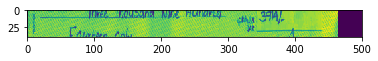

Iteration: 23500 at 2019-04-11 13:17:24.961350


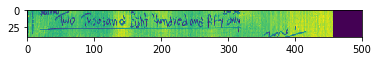

Iteration: 23550 at 2019-04-11 13:17:32.642929


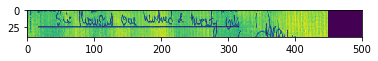

Iteration: 23600 at 2019-04-11 13:17:40.363848


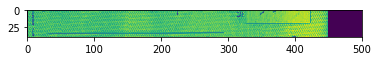

Iteration: 23650 at 2019-04-11 13:17:48.086038


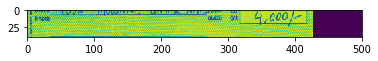

Iteration: 23700 at 2019-04-11 13:17:55.822485


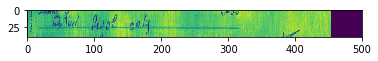

Iteration: 23750 at 2019-04-11 13:18:03.545454


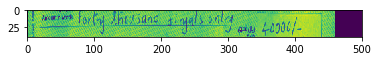

Iteration: 23800 at 2019-04-11 13:18:11.339088


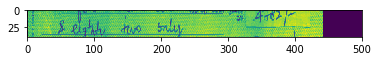

Iteration: 23850 at 2019-04-11 13:18:19.077771


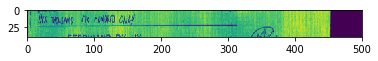

Iteration: 23900 at 2019-04-11 13:18:26.927082


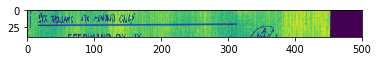

Iteration: 23950 at 2019-04-11 13:18:34.645336


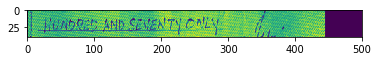

Iteration: 24000 at 2019-04-11 13:18:42.398969


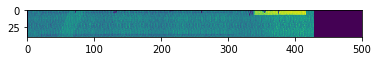

Iteration: 24050 at 2019-04-11 13:18:50.149985


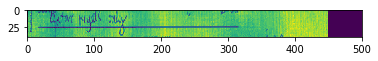

Iteration: 24100 at 2019-04-11 13:18:57.871548


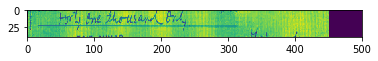

Iteration: 24150 at 2019-04-11 13:19:05.616979


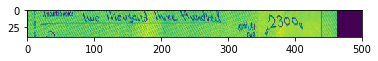

Iteration: 24200 at 2019-04-11 13:19:13.289919


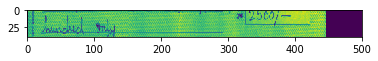

Iteration: 24250 at 2019-04-11 13:19:21.065477


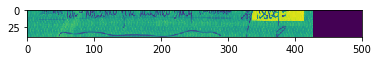

Iteration: 24300 at 2019-04-11 13:19:28.839285


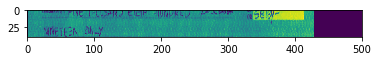

Iteration: 24350 at 2019-04-11 13:19:36.536348


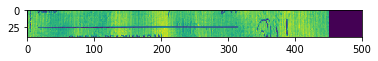

Iteration: 24400 at 2019-04-11 13:19:44.474197


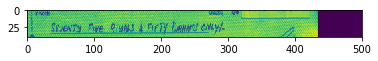

Iteration: 24450 at 2019-04-11 13:19:52.958732


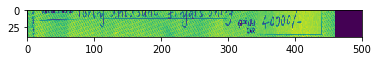

Iteration: 24500 at 2019-04-11 13:20:01.105206


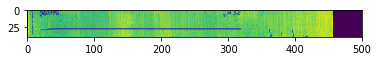

Iteration: 24550 at 2019-04-11 13:20:09.238712


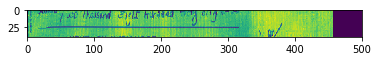

Iteration: 24600 at 2019-04-11 13:20:17.478544


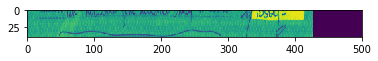

Iteration: 24650 at 2019-04-11 13:20:25.903726


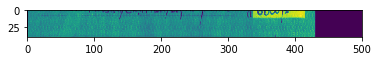

Iteration: 24700 at 2019-04-11 13:20:34.412283


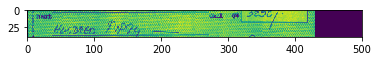

Iteration: 24750 at 2019-04-11 13:20:42.662945


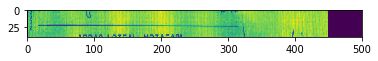

Iteration: 24800 at 2019-04-11 13:20:50.940779


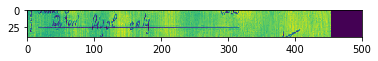

Iteration: 24850 at 2019-04-11 13:20:59.382659


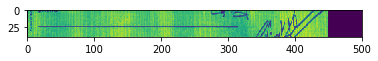

Iteration: 24900 at 2019-04-11 13:21:07.678636


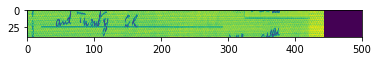

Iteration: 24950 at 2019-04-11 13:21:16.017015


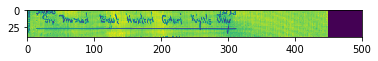

Iteration: 25000 at 2019-04-11 13:21:24.310762


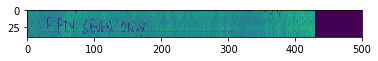

Iteration: 25050 at 2019-04-11 13:21:32.574476


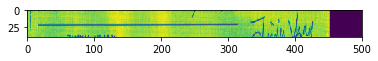

Iteration: 25100 at 2019-04-11 13:21:40.866339


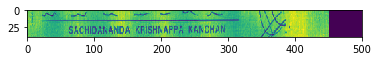

Iteration: 25150 at 2019-04-11 13:21:49.141151


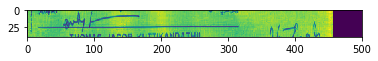

Iteration: 25200 at 2019-04-11 13:21:57.530060


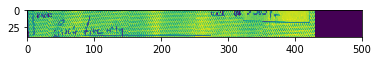

Iteration: 25250 at 2019-04-11 13:22:05.725446


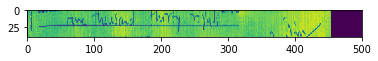

Iteration: 25300 at 2019-04-11 13:22:13.964430


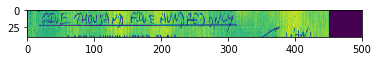

Iteration: 25350 at 2019-04-11 13:22:22.267075


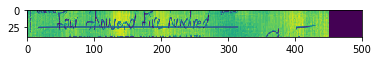

Iteration: 25400 at 2019-04-11 13:22:30.661662


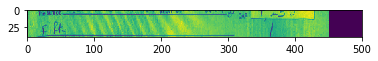

Iteration: 25450 at 2019-04-11 13:22:38.992905


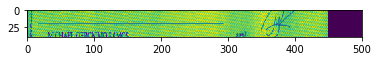

Iteration: 25500 at 2019-04-11 13:22:47.286047


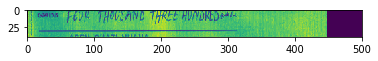

Iteration: 25550 at 2019-04-11 13:22:55.585190


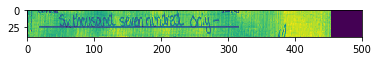

Iteration: 25600 at 2019-04-11 13:23:03.858291


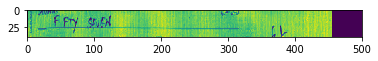

Iteration: 25650 at 2019-04-11 13:23:12.097689


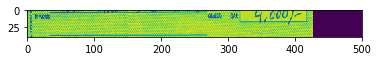

Iteration: 25700 at 2019-04-11 13:23:20.322448


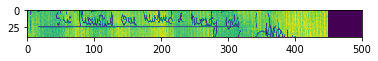

Iteration: 25750 at 2019-04-11 13:23:28.598769


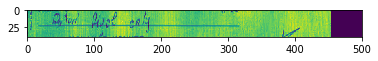

Iteration: 25800 at 2019-04-11 13:23:36.853610


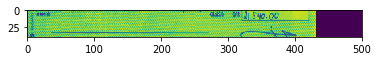

Iteration: 25850 at 2019-04-11 13:23:45.096163


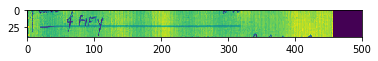

Iteration: 25900 at 2019-04-11 13:23:53.363433


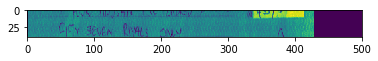

Iteration: 25950 at 2019-04-11 13:24:01.736246


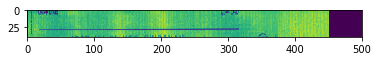

Iteration: 26000 at 2019-04-11 13:24:10.066938


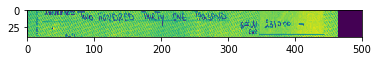

Iteration: 26050 at 2019-04-11 13:24:18.400364


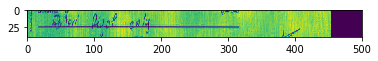

Iteration: 26100 at 2019-04-11 13:24:26.640793


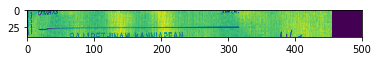

Iteration: 26150 at 2019-04-11 13:24:34.916390


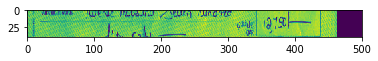

Iteration: 26200 at 2019-04-11 13:24:43.253573


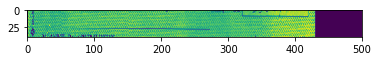

Iteration: 26250 at 2019-04-11 13:24:51.898109


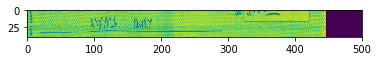

Iteration: 26300 at 2019-04-11 13:25:00.414259


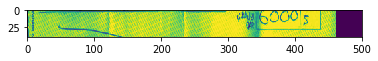

Iteration: 26350 at 2019-04-11 13:25:08.907750


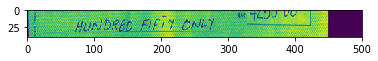

Iteration: 26400 at 2019-04-11 13:25:17.489007


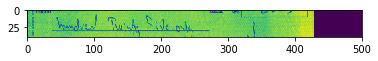

Iteration: 26450 at 2019-04-11 13:25:25.959499


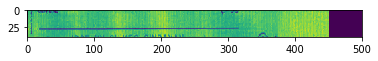

Iteration: 26500 at 2019-04-11 13:25:34.243742


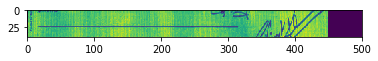

Iteration: 26550 at 2019-04-11 13:25:42.512070


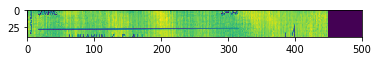

Iteration: 26600 at 2019-04-11 13:25:50.826281


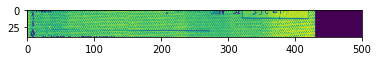

Iteration: 26650 at 2019-04-11 13:25:59.095358


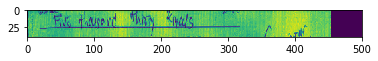

Iteration: 26700 at 2019-04-11 13:26:07.371536


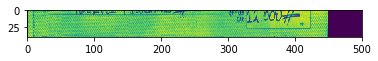

Iteration: 26750 at 2019-04-11 13:26:16.303150


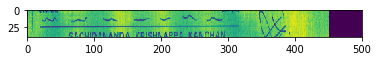

Iteration: 26800 at 2019-04-11 13:26:24.750266


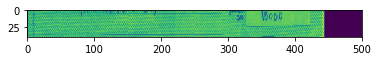

Iteration: 26850 at 2019-04-11 13:26:33.143840


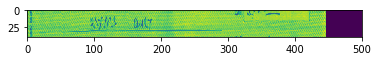

Iteration: 26900 at 2019-04-11 13:26:41.623873


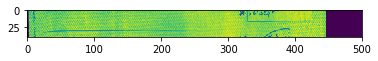

Iteration: 26950 at 2019-04-11 13:26:49.995899


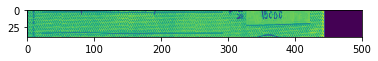

Iteration: 27000 at 2019-04-11 13:26:58.397123


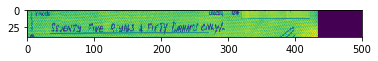

Iteration: 27050 at 2019-04-11 13:27:06.678929


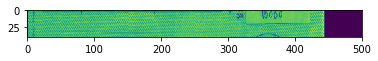

Iteration: 27100 at 2019-04-11 13:27:15.318801


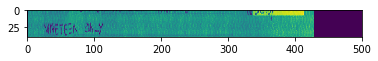

Iteration: 27150 at 2019-04-11 13:27:23.873080


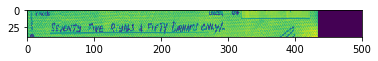

Iteration: 27200 at 2019-04-11 13:27:32.371789


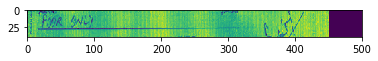

Iteration: 27250 at 2019-04-11 13:27:40.803809


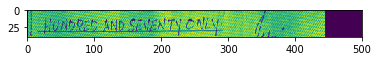

Iteration: 27300 at 2019-04-11 13:27:49.469788


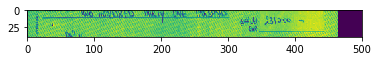

Iteration: 27350 at 2019-04-11 13:27:57.853719


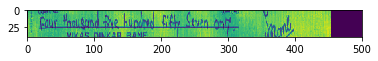

Iteration: 27400 at 2019-04-11 13:28:06.308085


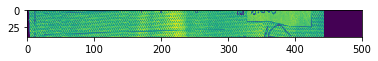

Iteration: 27450 at 2019-04-11 13:28:14.542975


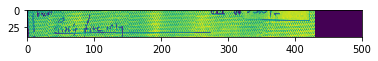

Iteration: 27500 at 2019-04-11 13:28:22.873995


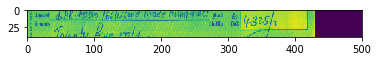

Iteration: 27550 at 2019-04-11 13:28:31.288387


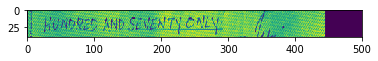

Iteration: 27600 at 2019-04-11 13:28:39.716339


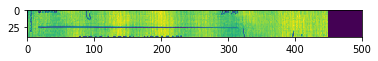

Iteration: 27650 at 2019-04-11 13:28:48.005889


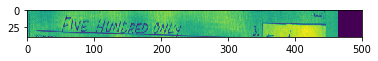

Iteration: 27700 at 2019-04-11 13:28:56.353908


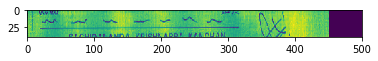

Iteration: 27750 at 2019-04-11 13:29:04.800932


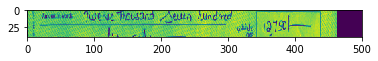

Iteration: 27800 at 2019-04-11 13:29:13.441542


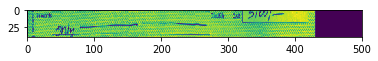

Iteration: 27850 at 2019-04-11 13:29:21.848504


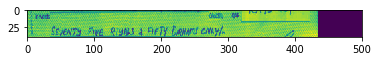

Iteration: 27900 at 2019-04-11 13:29:30.226369


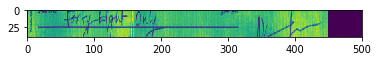

Iteration: 27950 at 2019-04-11 13:29:38.560201


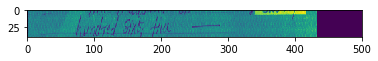

Iteration: 28000 at 2019-04-11 13:29:46.952036


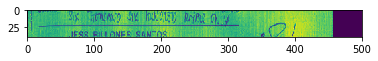

Iteration: 28050 at 2019-04-11 13:29:55.289735


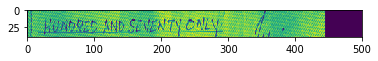

Iteration: 28100 at 2019-04-11 13:30:03.698699


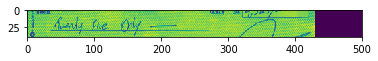

Iteration: 28150 at 2019-04-11 13:30:12.038294


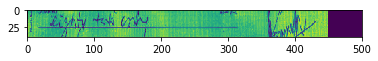

Iteration: 28200 at 2019-04-11 13:30:20.430692


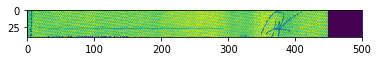

Iteration: 28250 at 2019-04-11 13:30:28.914176


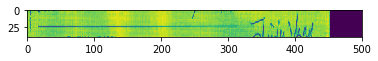

Iteration: 28300 at 2019-04-11 13:30:37.324742


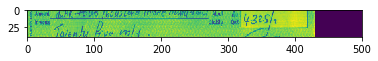

Iteration: 28350 at 2019-04-11 13:30:45.607697


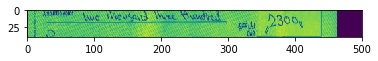

Iteration: 28400 at 2019-04-11 13:30:53.967757


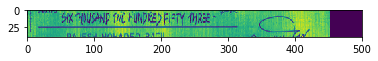

Iteration: 28450 at 2019-04-11 13:31:02.313007


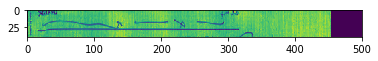

Iteration: 28500 at 2019-04-11 13:31:10.758214


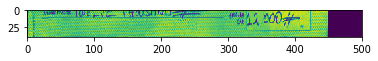

Iteration: 28550 at 2019-04-11 13:31:19.171115


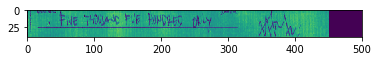

Iteration: 28600 at 2019-04-11 13:31:27.535957


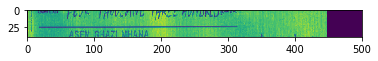

Iteration: 28650 at 2019-04-11 13:31:35.924391


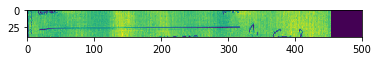

Iteration: 28700 at 2019-04-11 13:31:44.411792


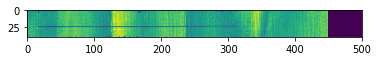

Iteration: 28750 at 2019-04-11 13:31:52.858102


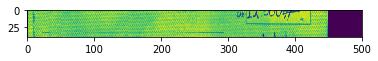

Iteration: 28800 at 2019-04-11 13:32:01.241239


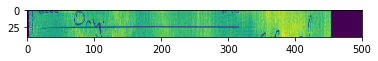

Iteration: 28850 at 2019-04-11 13:32:09.595594


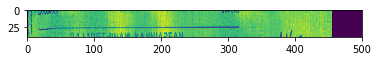

Iteration: 28900 at 2019-04-11 13:32:17.964104


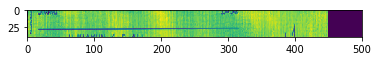

Iteration: 28950 at 2019-04-11 13:32:26.375386


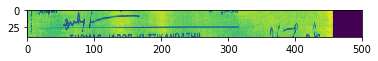

Iteration: 29000 at 2019-04-11 13:32:34.878467


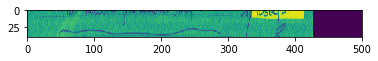

Iteration: 29050 at 2019-04-11 13:32:43.222769


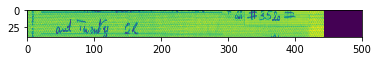

Iteration: 29100 at 2019-04-11 13:32:51.583470


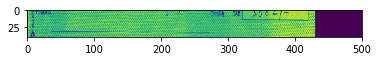

Iteration: 29150 at 2019-04-11 13:32:59.926655


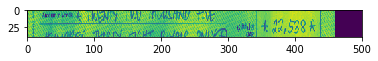

Iteration: 29200 at 2019-04-11 13:33:08.302991


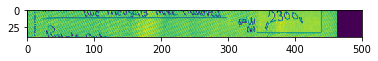

Iteration: 29250 at 2019-04-11 13:33:16.678105


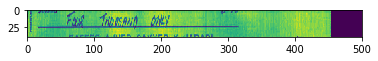

Iteration: 29300 at 2019-04-11 13:33:25.206739


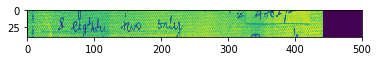

Iteration: 29350 at 2019-04-11 13:33:33.784204


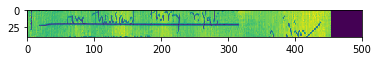

Iteration: 29400 at 2019-04-11 13:33:42.324249


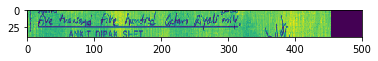

Iteration: 29450 at 2019-04-11 13:33:50.687660


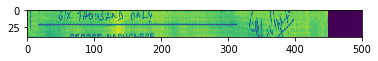

Iteration: 29500 at 2019-04-11 13:33:59.197720


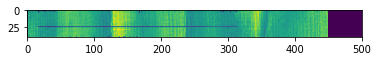

Iteration: 29550 at 2019-04-11 13:34:07.766781


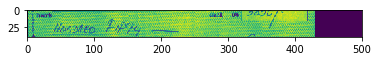

Iteration: 29600 at 2019-04-11 13:34:16.081537


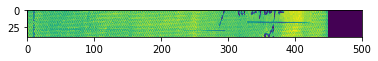

Iteration: 29650 at 2019-04-11 13:34:24.467698


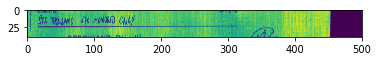

Iteration: 29700 at 2019-04-11 13:34:32.950840


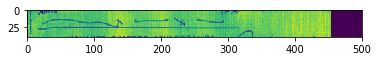

Iteration: 29750 at 2019-04-11 13:34:41.243331


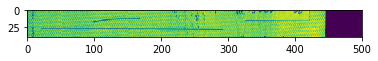

Iteration: 29800 at 2019-04-11 13:34:49.697421


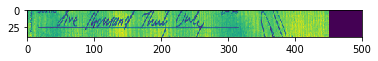

Iteration: 29850 at 2019-04-11 13:34:57.987632


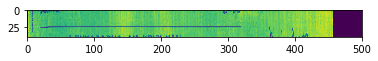

Iteration: 29900 at 2019-04-11 13:35:06.405483


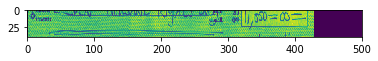

Iteration: 29950 at 2019-04-11 13:35:14.901589


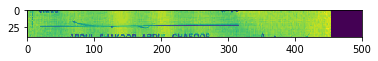

Iteration: 30000 at 2019-04-11 13:35:23.349446


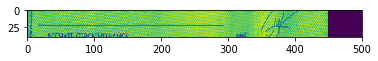

Iteration: 30050 at 2019-04-11 13:35:31.999805


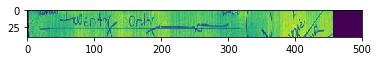

Iteration: 30100 at 2019-04-11 13:35:40.312362


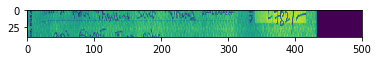

Iteration: 30150 at 2019-04-11 13:35:48.659736


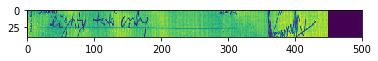

Iteration: 30200 at 2019-04-11 13:35:57.027072


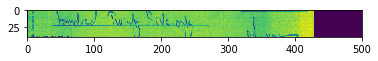

Iteration: 30250 at 2019-04-11 13:36:05.472541


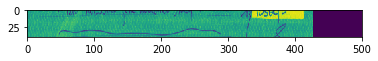

Iteration: 30300 at 2019-04-11 13:36:13.828600


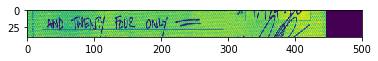

Iteration: 30350 at 2019-04-11 13:36:22.272992


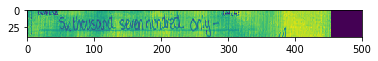

Iteration: 30400 at 2019-04-11 13:36:30.712202


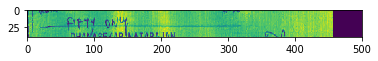

Iteration: 30450 at 2019-04-11 13:36:39.260773


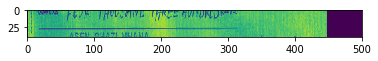

Iteration: 30500 at 2019-04-11 13:36:47.643114


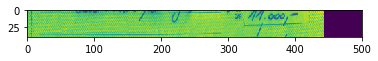

Iteration: 30550 at 2019-04-11 13:36:56.194314


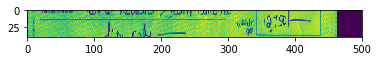

Iteration: 30600 at 2019-04-11 13:37:04.806043


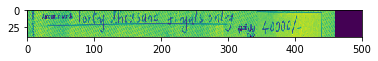

Iteration: 30650 at 2019-04-11 13:37:13.216012


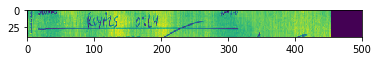

Iteration: 30700 at 2019-04-11 13:37:21.659451


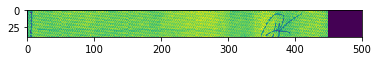

Iteration: 30750 at 2019-04-11 13:37:30.103403


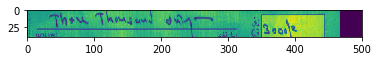

Iteration: 30800 at 2019-04-11 13:37:38.500493


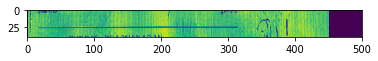

Iteration: 30850 at 2019-04-11 13:37:47.119544


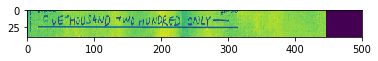

Iteration: 30900 at 2019-04-11 13:37:55.747994


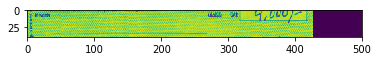

Iteration: 30950 at 2019-04-11 13:38:04.227837


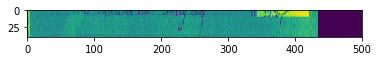

Iteration: 31000 at 2019-04-11 13:38:12.590563


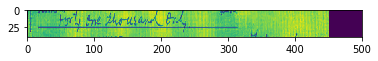

Iteration: 31050 at 2019-04-11 13:38:20.992181


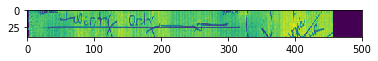

Iteration: 31100 at 2019-04-11 13:38:29.571012


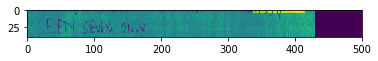

Iteration: 31150 at 2019-04-11 13:38:38.128046


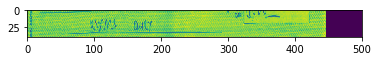

Iteration: 31200 at 2019-04-11 13:38:46.576490


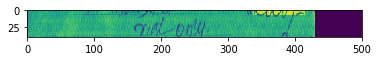

Iteration: 31250 at 2019-04-11 13:38:54.938132


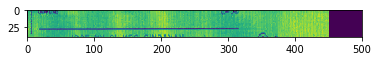

Iteration: 31300 at 2019-04-11 13:39:03.137327


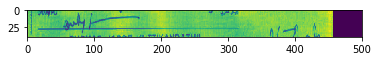

Iteration: 31350 at 2019-04-11 13:39:12.197062


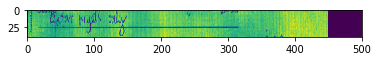

Iteration: 31400 at 2019-04-11 13:39:20.705264


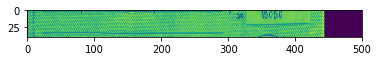

Iteration: 31450 at 2019-04-11 13:39:29.083987


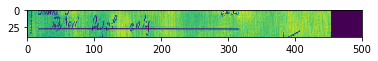

Iteration: 31500 at 2019-04-11 13:39:37.666184


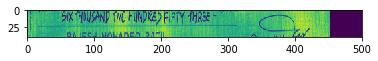

Iteration: 31550 at 2019-04-11 13:39:46.174523


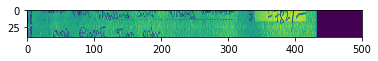

Iteration: 31600 at 2019-04-11 13:39:54.724441


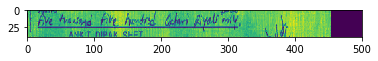

Iteration: 31650 at 2019-04-11 13:40:03.328924


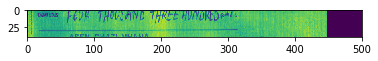

Iteration: 31700 at 2019-04-11 13:40:11.870607


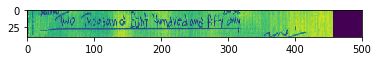

Iteration: 31750 at 2019-04-11 13:40:20.455739


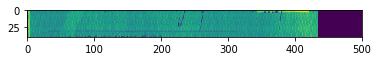

Iteration: 31800 at 2019-04-11 13:40:29.080578


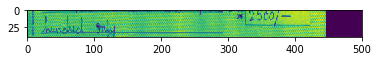

Iteration: 31850 at 2019-04-11 13:40:37.508209


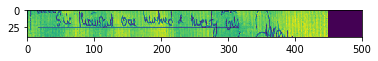

Iteration: 31900 at 2019-04-11 13:40:46.197925


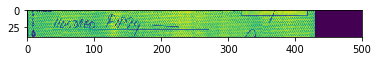

Iteration: 31950 at 2019-04-11 13:40:54.811252


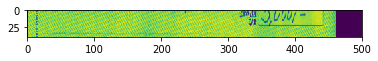

Iteration: 32000 at 2019-04-11 13:41:03.404742


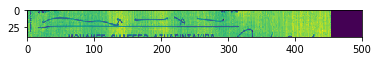

Iteration: 32050 at 2019-04-11 13:41:11.923130


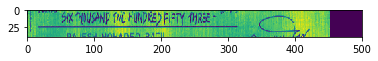

Iteration: 32100 at 2019-04-11 13:41:20.467079


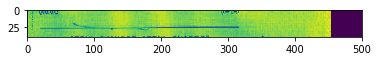

Iteration: 32150 at 2019-04-11 13:41:28.985147


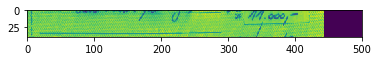

Iteration: 32200 at 2019-04-11 13:41:37.377460


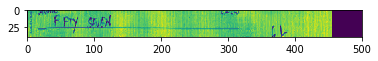

Iteration: 32250 at 2019-04-11 13:41:45.839179


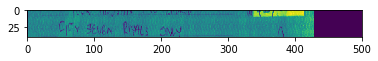

Iteration: 32300 at 2019-04-11 13:41:54.442290


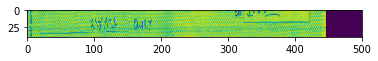

Iteration: 32350 at 2019-04-11 13:42:02.968890


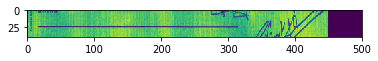

Iteration: 32400 at 2019-04-11 13:42:11.730155


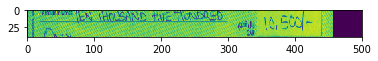

Iteration: 32450 at 2019-04-11 13:42:20.373955


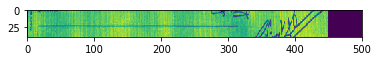

Iteration: 32500 at 2019-04-11 13:42:28.860103


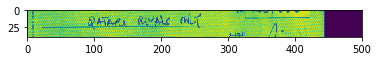

Iteration: 32550 at 2019-04-11 13:42:37.269208


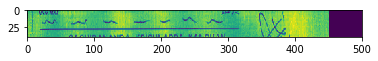

Iteration: 32600 at 2019-04-11 13:42:45.701045


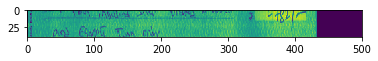

Iteration: 32650 at 2019-04-11 13:42:54.158701


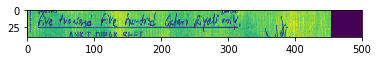

Iteration: 32700 at 2019-04-11 13:43:02.710335


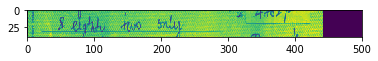

Iteration: 32750 at 2019-04-11 13:43:11.026453


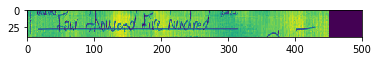

Iteration: 32800 at 2019-04-11 13:43:19.575677


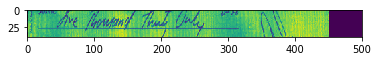

Iteration: 32850 at 2019-04-11 13:43:27.977401


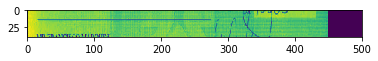

Iteration: 32900 at 2019-04-11 13:43:36.405694


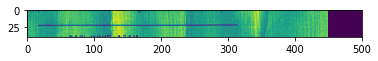

Iteration: 32950 at 2019-04-11 13:43:44.897748


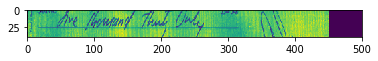

Iteration: 33000 at 2019-04-11 13:43:53.343256


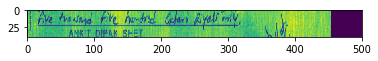

Iteration: 33050 at 2019-04-11 13:44:01.854641


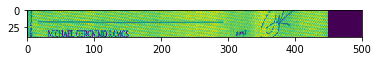

Iteration: 33100 at 2019-04-11 13:44:10.435232


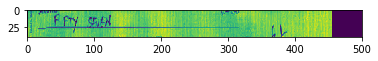

Iteration: 33150 at 2019-04-11 13:44:18.962796


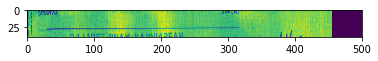

Iteration: 33200 at 2019-04-11 13:44:27.529031


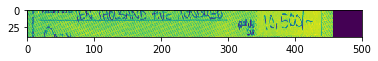

Iteration: 33250 at 2019-04-11 13:44:35.989009


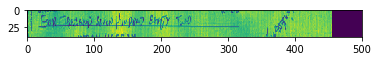

Iteration: 33300 at 2019-04-11 13:44:44.496700


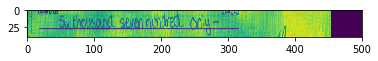

Iteration: 33350 at 2019-04-11 13:44:52.976024


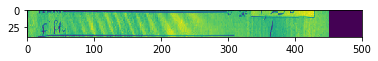

Iteration: 33400 at 2019-04-11 13:45:01.594874


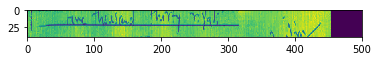

Iteration: 33450 at 2019-04-11 13:45:10.126517


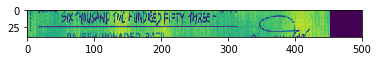

Iteration: 33500 at 2019-04-11 13:45:18.718535


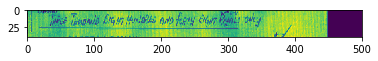

Iteration: 33550 at 2019-04-11 13:45:27.130909


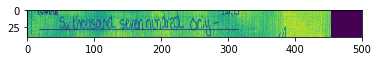

Iteration: 33600 at 2019-04-11 13:45:35.527122


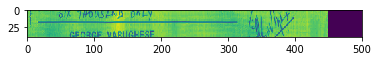

Iteration: 33650 at 2019-04-11 13:45:44.044055


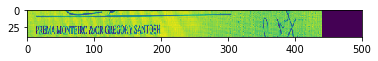

Iteration: 33700 at 2019-04-11 13:45:52.539944


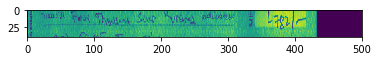

Iteration: 33750 at 2019-04-11 13:46:01.055853


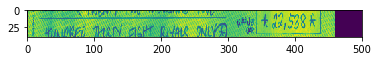

Iteration: 33800 at 2019-04-11 13:46:09.556706


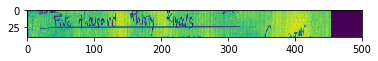

Iteration: 33850 at 2019-04-11 13:46:17.968722


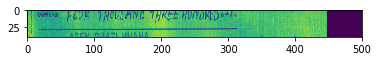

Iteration: 33900 at 2019-04-11 13:46:26.640659


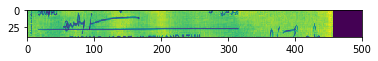

Iteration: 33950 at 2019-04-11 13:46:35.330106


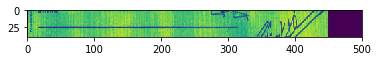

Iteration: 34000 at 2019-04-11 13:46:43.985683


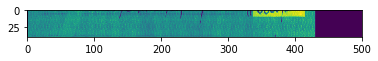

Iteration: 34050 at 2019-04-11 13:46:52.582717


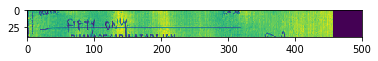

Iteration: 34100 at 2019-04-11 13:47:01.123403


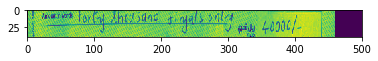

Iteration: 34150 at 2019-04-11 13:47:09.624977


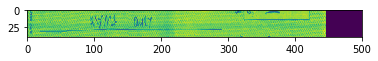

Iteration: 34200 at 2019-04-11 13:47:18.094112


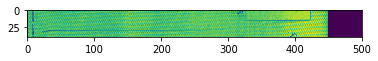

Iteration: 34250 at 2019-04-11 13:47:26.633947


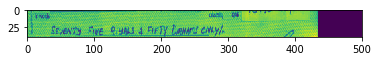

Iteration: 34300 at 2019-04-11 13:47:35.234608


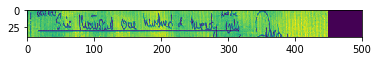

Iteration: 34350 at 2019-04-11 13:47:43.776227


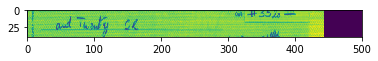

Iteration: 34400 at 2019-04-11 13:47:52.284628


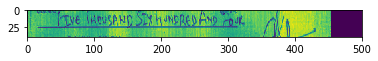

Iteration: 34450 at 2019-04-11 13:48:00.875712


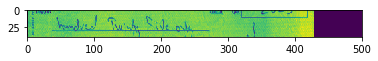

Iteration: 34500 at 2019-04-11 13:48:09.473780


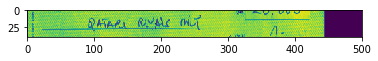

Iteration: 34550 at 2019-04-11 13:48:18.024672


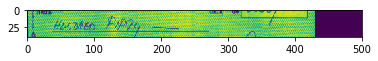

Iteration: 34600 at 2019-04-11 13:48:26.599453


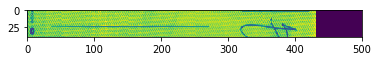

Iteration: 34650 at 2019-04-11 13:48:34.986766


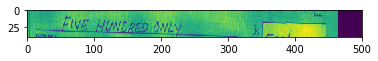

Iteration: 34700 at 2019-04-11 13:48:43.459063


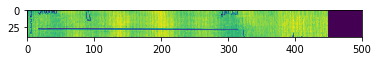

Iteration: 34750 at 2019-04-11 13:48:51.906820


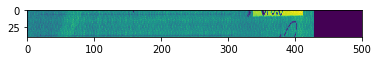

Iteration: 34800 at 2019-04-11 13:49:00.408230


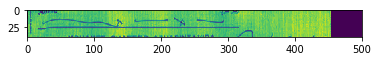

Iteration: 34850 at 2019-04-11 13:49:09.016658


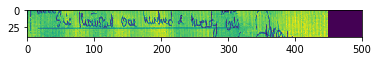

Iteration: 34900 at 2019-04-11 13:49:17.535953


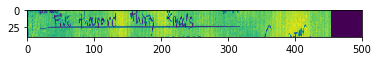

Iteration: 34950 at 2019-04-11 13:49:26.100321


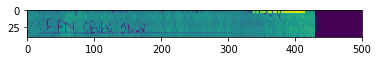

Iteration: 35000 at 2019-04-11 13:49:34.622134


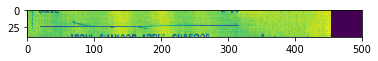

Iteration: 35050 at 2019-04-11 13:49:43.052161


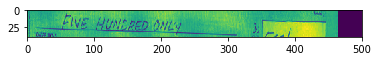

Iteration: 35100 at 2019-04-11 13:49:51.557479


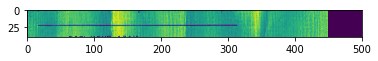

Iteration: 35150 at 2019-04-11 13:50:00.146628


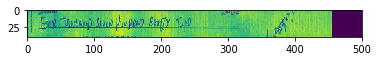

Iteration: 35200 at 2019-04-11 13:50:08.740452


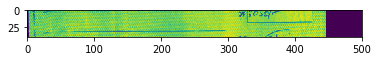

Iteration: 35250 at 2019-04-11 13:50:17.314808


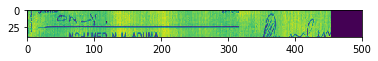

Iteration: 35300 at 2019-04-11 13:50:25.874376


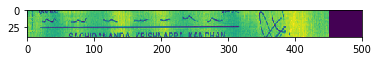

Iteration: 35350 at 2019-04-11 13:50:34.289801


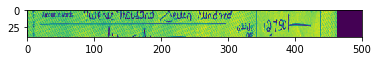

Iteration: 35400 at 2019-04-11 13:50:42.980428


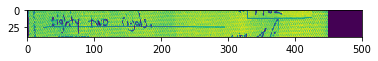

Iteration: 35450 at 2019-04-11 13:50:51.818870


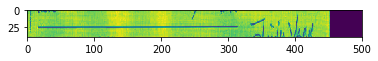

Iteration: 35500 at 2019-04-11 13:51:00.679279


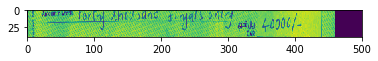

Iteration: 35550 at 2019-04-11 13:51:09.343580


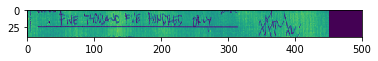

Iteration: 35600 at 2019-04-11 13:51:17.949084


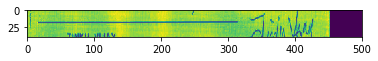

Iteration: 35650 at 2019-04-11 13:51:26.472624


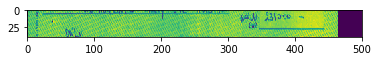

Iteration: 35700 at 2019-04-11 13:51:35.074616


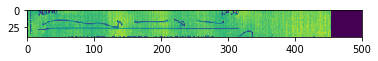

Iteration: 35750 at 2019-04-11 13:51:43.577049


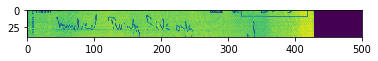

Iteration: 35800 at 2019-04-11 13:51:52.075524


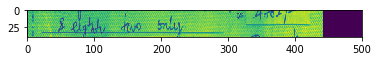

Iteration: 35850 at 2019-04-11 13:52:00.634852


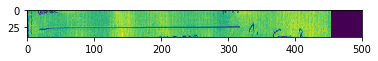

Iteration: 35900 at 2019-04-11 13:52:09.205235


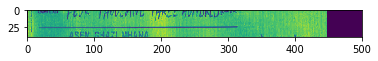

Iteration: 35950 at 2019-04-11 13:52:17.706922


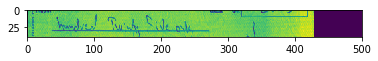

Iteration: 36000 at 2019-04-11 13:52:26.400584


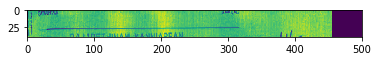

Iteration: 36050 at 2019-04-11 13:52:35.029788


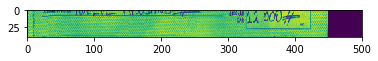

Iteration: 36100 at 2019-04-11 13:52:43.529474


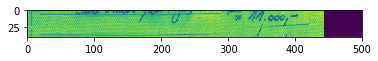

Iteration: 36150 at 2019-04-11 13:52:52.037068


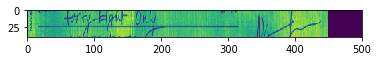

Iteration: 36200 at 2019-04-11 13:53:00.746849


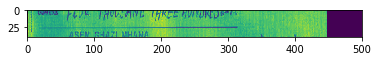

Iteration: 36250 at 2019-04-11 13:53:09.312762


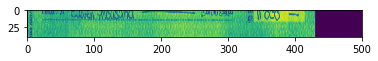

Iteration: 36300 at 2019-04-11 13:53:17.872857


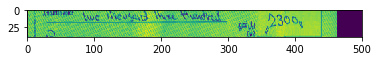

Iteration: 36350 at 2019-04-11 13:53:26.511809


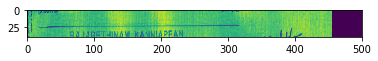

Iteration: 36400 at 2019-04-11 13:53:35.138128


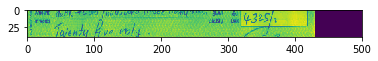

Iteration: 36450 at 2019-04-11 13:53:43.655538


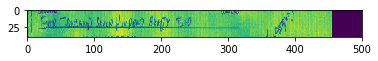

Iteration: 36500 at 2019-04-11 13:53:52.372139


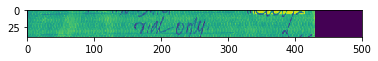

Iteration: 36550 at 2019-04-11 13:54:01.988334


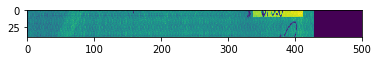

Iteration: 36600 at 2019-04-11 13:54:10.866306


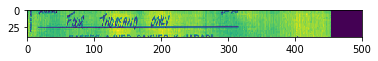

Iteration: 36650 at 2019-04-11 13:54:19.489328


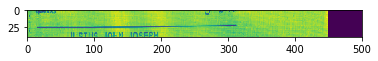

Iteration: 36700 at 2019-04-11 13:54:28.375535


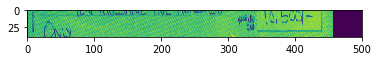

Iteration: 36750 at 2019-04-11 13:54:36.862021


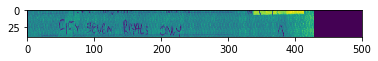

Iteration: 36800 at 2019-04-11 13:54:45.657079


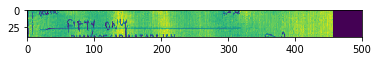

Iteration: 36850 at 2019-04-11 13:54:54.343844


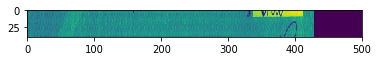

Iteration: 36900 at 2019-04-11 13:55:03.120960


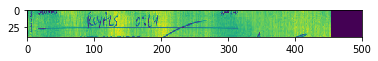

Iteration: 36950 at 2019-04-11 13:55:11.750400


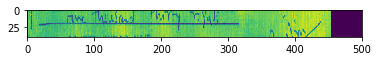

Iteration: 37000 at 2019-04-11 13:55:20.568715


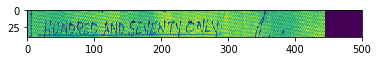

Iteration: 37050 at 2019-04-11 13:55:29.338796


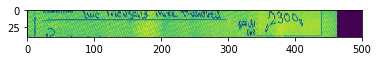

Iteration: 37100 at 2019-04-11 13:55:38.159770


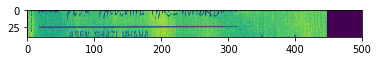

Iteration: 37150 at 2019-04-11 13:55:46.898190


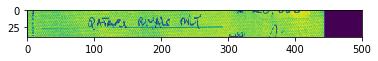

Iteration: 37200 at 2019-04-11 13:55:55.814135


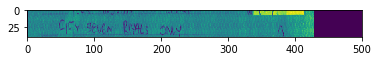

Iteration: 37250 at 2019-04-11 13:56:04.729619


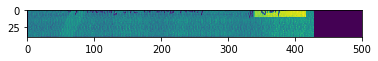

Iteration: 37300 at 2019-04-11 13:56:13.366874


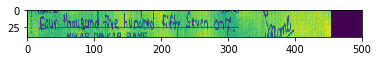

Iteration: 37350 at 2019-04-11 13:56:22.060425


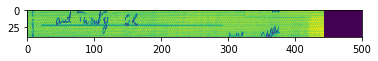

Iteration: 37400 at 2019-04-11 13:56:30.810644


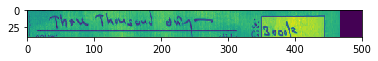

Iteration: 37450 at 2019-04-11 13:56:39.430161


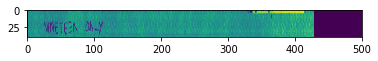

Iteration: 37500 at 2019-04-11 13:56:48.193321


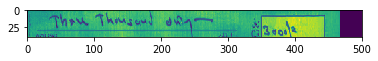

Iteration: 37550 at 2019-04-11 13:56:56.811257


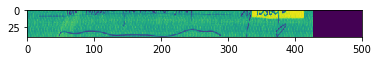

Iteration: 37600 at 2019-04-11 13:57:05.617366


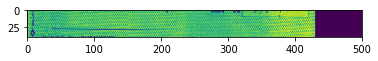

Iteration: 37650 at 2019-04-11 13:57:14.150653


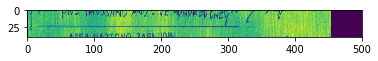

Iteration: 37700 at 2019-04-11 13:57:22.939845


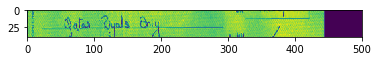

Iteration: 37750 at 2019-04-11 13:57:31.626876


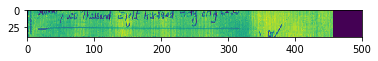

Iteration: 37800 at 2019-04-11 13:57:40.289278


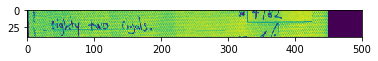

Iteration: 37850 at 2019-04-11 13:57:48.812018


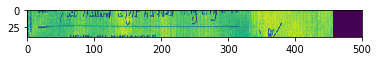

Iteration: 37900 at 2019-04-11 13:57:57.400454


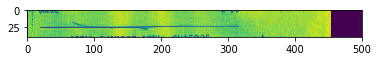

Iteration: 37950 at 2019-04-11 13:58:05.985611


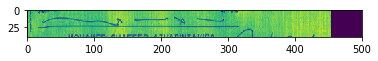

Iteration: 38000 at 2019-04-11 13:58:14.652812


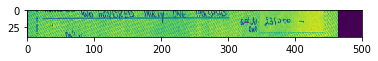

Iteration: 38050 at 2019-04-11 13:58:23.114891


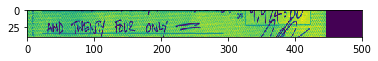

Iteration: 38100 at 2019-04-11 13:58:31.718731


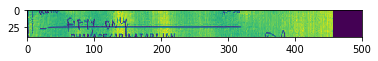

Iteration: 38150 at 2019-04-11 13:58:40.474723


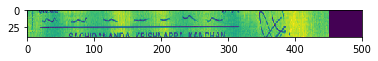

Iteration: 38200 at 2019-04-11 13:58:49.306551


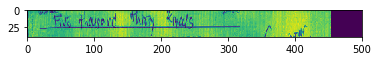

Iteration: 38250 at 2019-04-11 13:58:57.960671


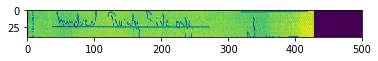

Iteration: 38300 at 2019-04-11 13:59:06.536197


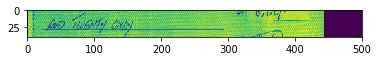

Iteration: 38350 at 2019-04-11 13:59:15.171109


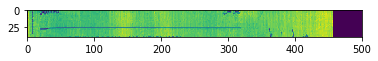

Iteration: 38400 at 2019-04-11 13:59:23.884686


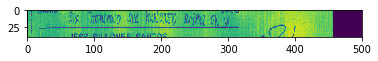

Iteration: 38450 at 2019-04-11 13:59:32.554171


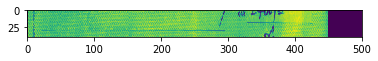

Iteration: 38500 at 2019-04-11 13:59:41.059708


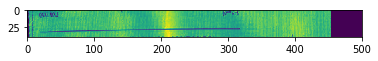

Iteration: 38550 at 2019-04-11 13:59:49.639319


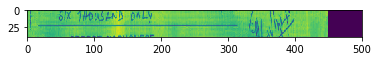

Iteration: 38600 at 2019-04-11 13:59:58.183510


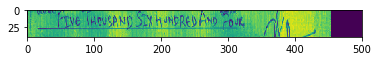

Iteration: 38650 at 2019-04-11 14:00:06.805625


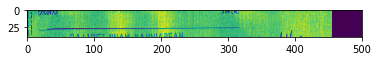

Iteration: 38700 at 2019-04-11 14:00:15.271722


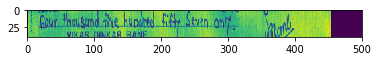

Iteration: 38750 at 2019-04-11 14:00:23.897402


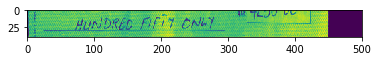

Iteration: 38800 at 2019-04-11 14:00:32.513715


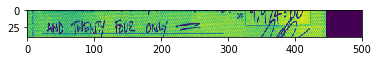

Iteration: 38850 at 2019-04-11 14:00:41.068611


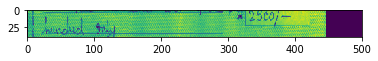

Iteration: 38900 at 2019-04-11 14:00:49.596175


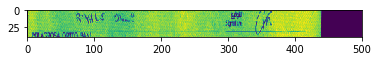

Iteration: 38950 at 2019-04-11 14:00:58.184272


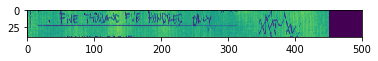

Iteration: 39000 at 2019-04-11 14:01:06.827192


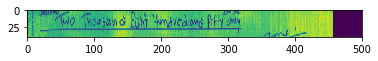

Iteration: 39050 at 2019-04-11 14:01:15.483214


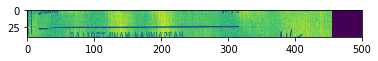

Iteration: 39100 at 2019-04-11 14:01:24.032122


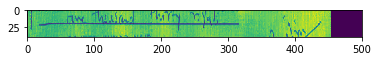

Iteration: 39150 at 2019-04-11 14:01:32.566269


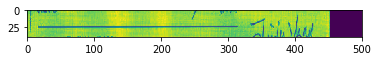

Iteration: 39200 at 2019-04-11 14:01:41.120827


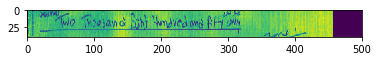

Iteration: 39250 at 2019-04-11 14:01:49.922890


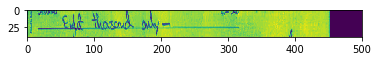

Iteration: 39300 at 2019-04-11 14:01:58.746409


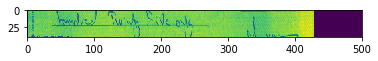

Iteration: 39350 at 2019-04-11 14:02:07.497174


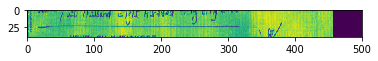

Iteration: 39400 at 2019-04-11 14:02:16.359650


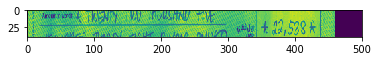

Iteration: 39450 at 2019-04-11 14:02:24.984774


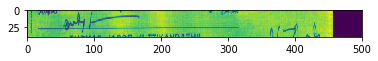

Iteration: 39500 at 2019-04-11 14:02:33.637299


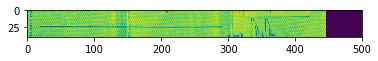

Iteration: 39550 at 2019-04-11 14:02:42.233162


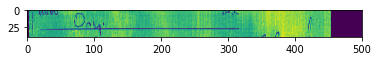

Iteration: 39600 at 2019-04-11 14:02:50.942484


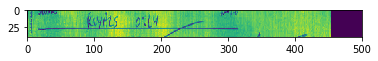

Iteration: 39650 at 2019-04-11 14:02:59.569457


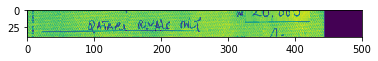

Iteration: 39700 at 2019-04-11 14:03:08.046784


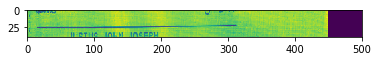

Iteration: 39750 at 2019-04-11 14:03:16.617464


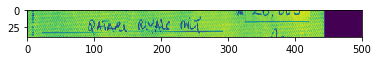

Iteration: 39800 at 2019-04-11 14:03:25.359552


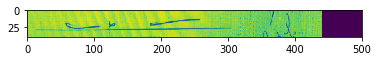

Iteration: 39850 at 2019-04-11 14:03:34.052025


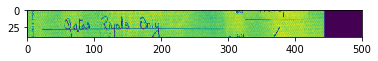

Iteration: 39900 at 2019-04-11 14:03:42.878987


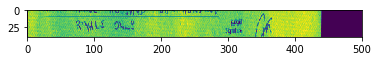

Iteration: 39950 at 2019-04-11 14:03:51.464539


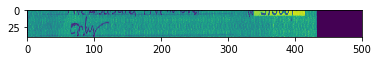

Iteration: 40000 at 2019-04-11 14:04:00.000049


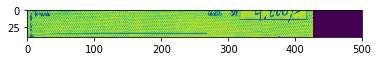

Iteration: 40050 at 2019-04-11 14:04:08.506842


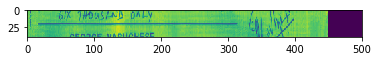

Iteration: 40100 at 2019-04-11 14:04:17.072973


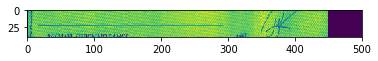

Iteration: 40150 at 2019-04-11 14:04:25.616258


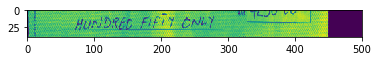

Iteration: 40200 at 2019-04-11 14:04:34.228515


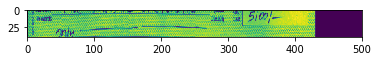

Iteration: 40250 at 2019-04-11 14:04:42.886801


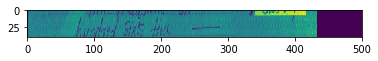

Iteration: 40300 at 2019-04-11 14:04:51.493358


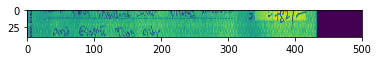

Iteration: 40350 at 2019-04-11 14:04:59.985592


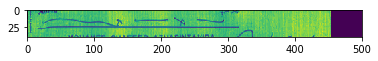

Iteration: 40400 at 2019-04-11 14:05:08.624426


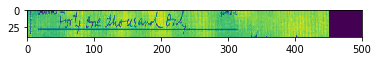

Iteration: 40450 at 2019-04-11 14:05:17.404473


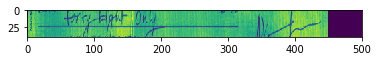

Iteration: 40500 at 2019-04-11 14:05:26.003564


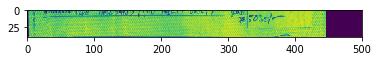

Iteration: 40550 at 2019-04-11 14:05:34.585278


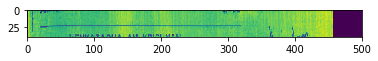

Iteration: 40600 at 2019-04-11 14:05:43.232156


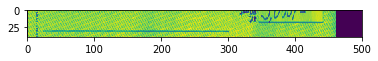

Iteration: 40650 at 2019-04-11 14:05:51.864537


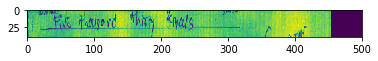

Iteration: 40700 at 2019-04-11 14:06:00.469930


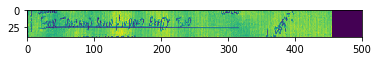

Iteration: 40750 at 2019-04-11 14:06:09.281394


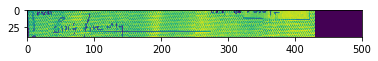

Iteration: 40800 at 2019-04-11 14:06:17.910739


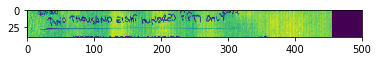

Iteration: 40850 at 2019-04-11 14:06:26.708665


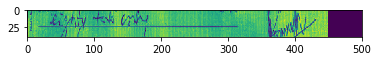

Iteration: 40900 at 2019-04-11 14:06:35.423540


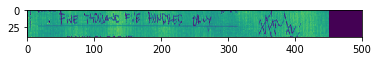

Iteration: 40950 at 2019-04-11 14:06:44.391440


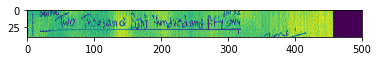

Iteration: 41000 at 2019-04-11 14:06:53.137529


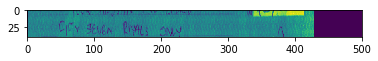

Iteration: 41050 at 2019-04-11 14:07:01.777816


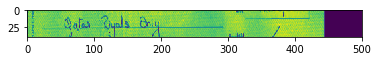

Iteration: 41100 at 2019-04-11 14:07:10.359176


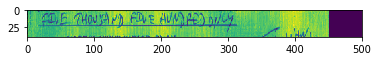

Iteration: 41150 at 2019-04-11 14:07:18.942414


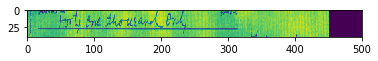

Iteration: 41200 at 2019-04-11 14:07:27.627580


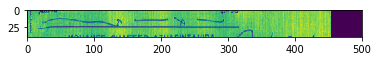

Iteration: 41250 at 2019-04-11 14:07:36.643099


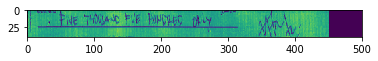

Iteration: 41300 at 2019-04-11 14:07:45.667411


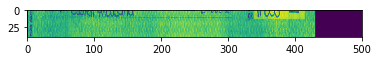

Iteration: 41350 at 2019-04-11 14:07:54.454420


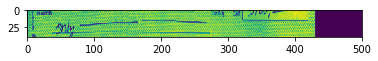

Iteration: 41400 at 2019-04-11 14:08:03.113391


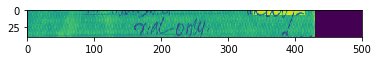

Iteration: 41450 at 2019-04-11 14:08:11.664560


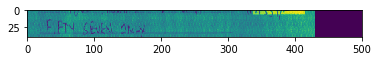

Iteration: 41500 at 2019-04-11 14:08:20.391403


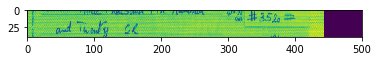

Iteration: 41550 at 2019-04-11 14:08:29.036283


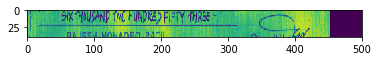

Iteration: 41600 at 2019-04-11 14:08:37.549766


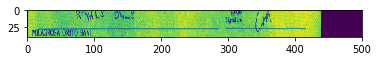

Iteration: 41650 at 2019-04-11 14:08:46.324860


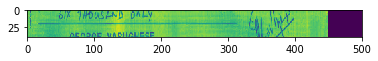

Iteration: 41700 at 2019-04-11 14:08:55.151929


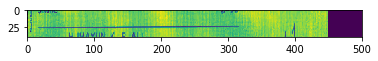

Iteration: 41750 at 2019-04-11 14:09:03.816375


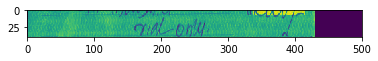

Iteration: 41800 at 2019-04-11 14:09:12.530733


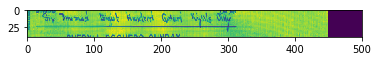

Iteration: 41850 at 2019-04-11 14:09:21.254277


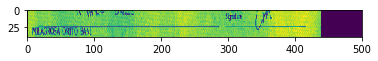

Iteration: 41900 at 2019-04-11 14:09:30.078166


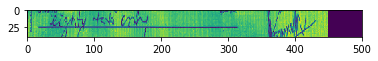

Iteration: 41950 at 2019-04-11 14:09:38.940909


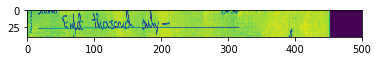

Iteration: 42000 at 2019-04-11 14:09:47.667371


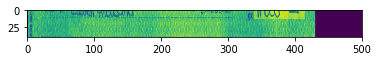

Iteration: 42050 at 2019-04-11 14:09:56.488766


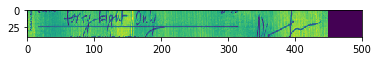

Iteration: 42100 at 2019-04-11 14:10:05.241367


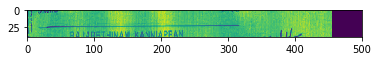

Iteration: 42150 at 2019-04-11 14:10:13.790220


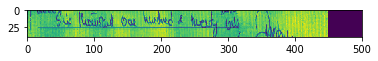

Iteration: 42200 at 2019-04-11 14:10:22.442176


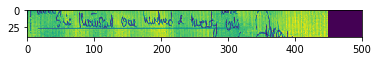

Iteration: 42250 at 2019-04-11 14:10:31.094254


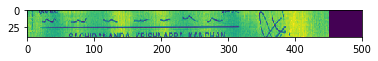

Iteration: 42300 at 2019-04-11 14:10:39.667748


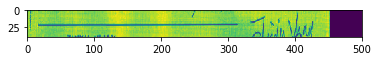

Iteration: 42350 at 2019-04-11 14:10:48.253160


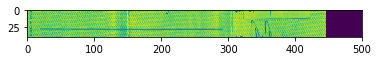

Iteration: 42400 at 2019-04-11 14:10:56.959390


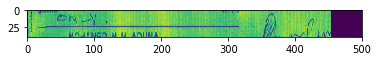

Iteration: 42450 at 2019-04-11 14:11:06.544912


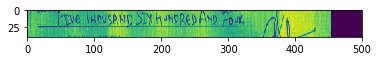

Iteration: 42500 at 2019-04-11 14:11:15.244355


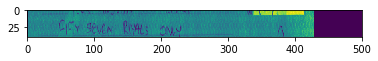

Iteration: 42550 at 2019-04-11 14:11:24.082291


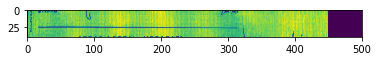

Iteration: 42600 at 2019-04-11 14:11:32.791743


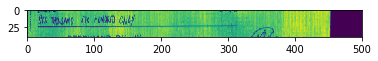

Iteration: 42650 at 2019-04-11 14:11:41.361346


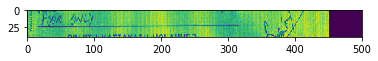

Iteration: 42700 at 2019-04-11 14:11:50.075686


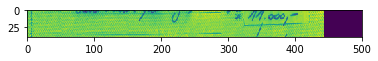

Iteration: 42750 at 2019-04-11 14:11:58.855382


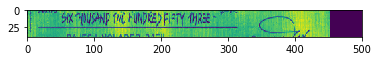

Iteration: 42800 at 2019-04-11 14:12:07.884535


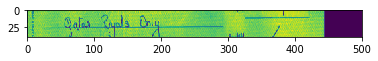

Iteration: 42850 at 2019-04-11 14:12:16.692107


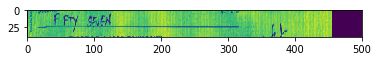

Iteration: 42900 at 2019-04-11 14:12:25.738378


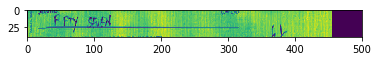

Iteration: 42950 at 2019-04-11 14:12:34.443432


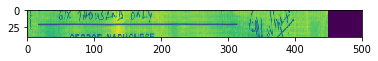

Iteration: 43000 at 2019-04-11 14:12:43.385483


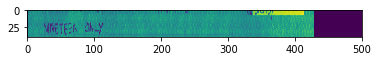

Iteration: 43050 at 2019-04-11 14:12:52.052599


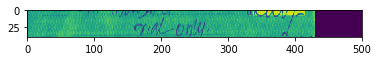

Iteration: 43100 at 2019-04-11 14:13:01.184168


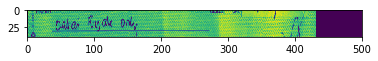

Iteration: 43150 at 2019-04-11 14:13:09.962322


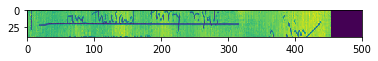

Iteration: 43200 at 2019-04-11 14:13:18.814663


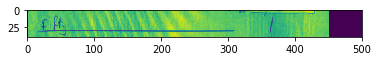

Iteration: 43250 at 2019-04-11 14:13:27.491030


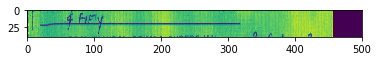

Iteration: 43300 at 2019-04-11 14:13:36.466694


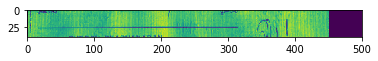

Iteration: 43350 at 2019-04-11 14:13:45.129037


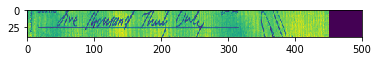

Iteration: 43400 at 2019-04-11 14:13:54.096825


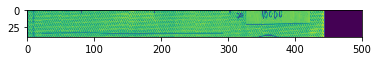

Iteration: 43450 at 2019-04-11 14:14:02.813746


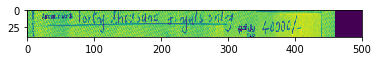

Iteration: 43500 at 2019-04-11 14:14:11.600366


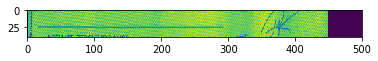

Iteration: 43550 at 2019-04-11 14:14:20.279265


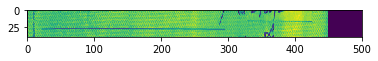

Iteration: 43600 at 2019-04-11 14:14:29.204383


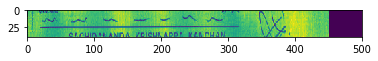

Iteration: 43650 at 2019-04-11 14:14:37.919329


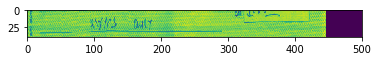

Iteration: 43700 at 2019-04-11 14:14:46.791285


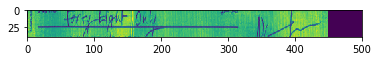

Iteration: 43750 at 2019-04-11 14:14:55.426623


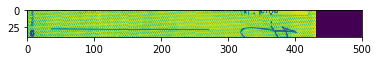

Iteration: 43800 at 2019-04-11 14:15:04.061422


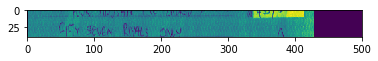

Iteration: 43850 at 2019-04-11 14:15:12.825016


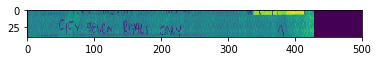

Iteration: 43900 at 2019-04-11 14:15:21.694416


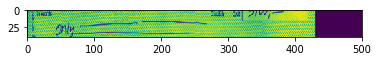

Iteration: 43950 at 2019-04-11 14:15:30.310363


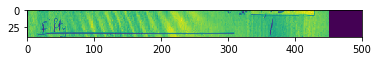

Iteration: 44000 at 2019-04-11 14:15:38.981586


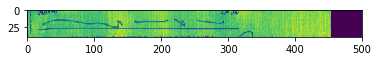

Iteration: 44050 at 2019-04-11 14:15:47.618890


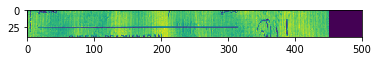

Iteration: 44100 at 2019-04-11 14:15:56.399478


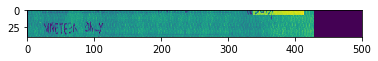

Iteration: 44150 at 2019-04-11 14:16:05.045291


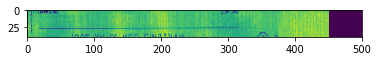

Iteration: 44200 at 2019-04-11 14:16:13.754022


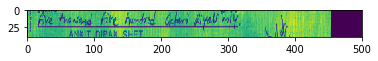

Iteration: 44250 at 2019-04-11 14:16:22.568847


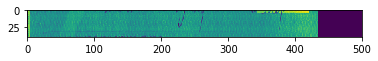

Iteration: 44300 at 2019-04-11 14:16:31.349123


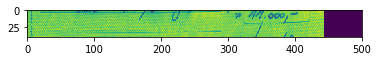

Iteration: 44350 at 2019-04-11 14:16:40.102270


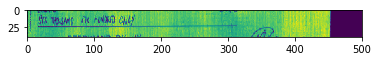

Iteration: 44400 at 2019-04-11 14:16:48.960736


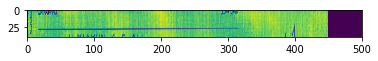

Iteration: 44450 at 2019-04-11 14:16:57.761430


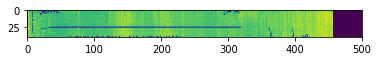

Iteration: 44500 at 2019-04-11 14:17:06.732141


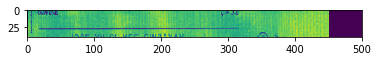

Iteration: 44550 at 2019-04-11 14:17:15.287530


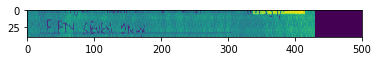

Iteration: 44600 at 2019-04-11 14:17:23.897057


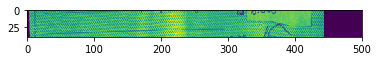

Iteration: 44650 at 2019-04-11 14:17:32.530968


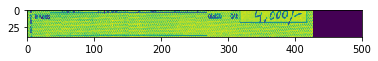

Iteration: 44700 at 2019-04-11 14:17:41.359377


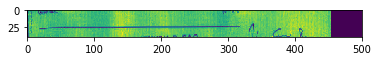

Iteration: 44750 at 2019-04-11 14:17:50.210768


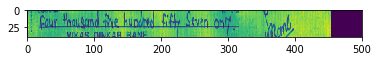

Iteration: 44800 at 2019-04-11 14:17:59.127980


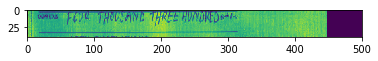

Iteration: 44850 at 2019-04-11 14:18:07.989316


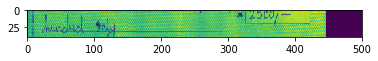

Iteration: 44900 at 2019-04-11 14:18:16.977499


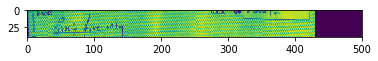

Iteration: 44950 at 2019-04-11 14:18:25.887949


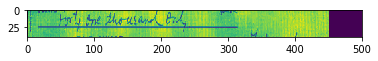

Iteration: 45000 at 2019-04-11 14:18:34.931767


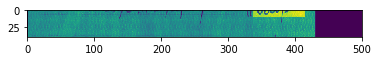

Iteration: 45050 at 2019-04-11 14:18:43.721845


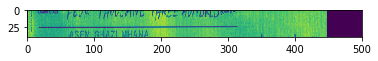

Iteration: 45100 at 2019-04-11 14:18:52.464887


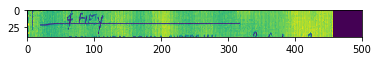

Iteration: 45150 at 2019-04-11 14:19:01.368629


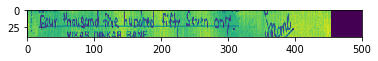

Iteration: 45200 at 2019-04-11 14:19:10.556301


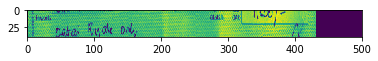

Iteration: 45250 at 2019-04-11 14:19:19.297934


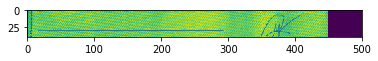

Iteration: 45300 at 2019-04-11 14:19:28.346002


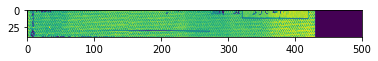

Iteration: 45350 at 2019-04-11 14:19:36.946702


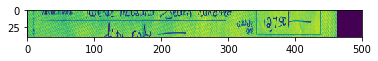

Iteration: 45400 at 2019-04-11 14:19:45.636489


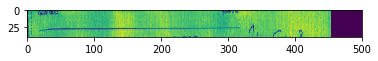

Iteration: 45450 at 2019-04-11 14:19:54.278676


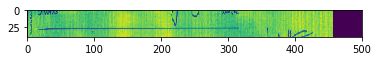

Iteration: 45500 at 2019-04-11 14:20:02.874248


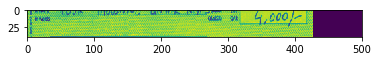

Iteration: 45550 at 2019-04-11 14:20:11.572007


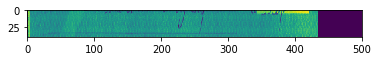

Iteration: 45600 at 2019-04-11 14:20:20.273525


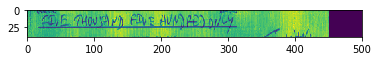

Iteration: 45650 at 2019-04-11 14:20:29.014846


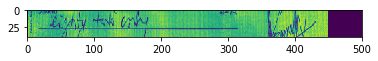

Iteration: 45700 at 2019-04-11 14:20:37.815792


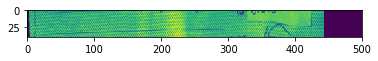

Iteration: 45750 at 2019-04-11 14:20:46.602976


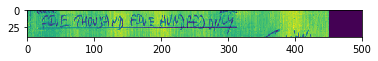

Iteration: 45800 at 2019-04-11 14:20:55.552515


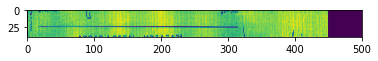

Iteration: 45850 at 2019-04-11 14:21:04.266142


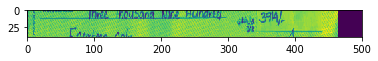

Iteration: 45900 at 2019-04-11 14:21:12.784058


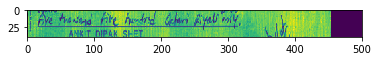

Iteration: 45950 at 2019-04-11 14:21:21.605941


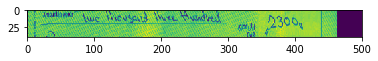

Iteration: 46000 at 2019-04-11 14:21:30.264393


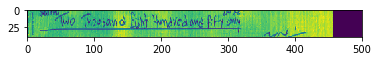

Iteration: 46050 at 2019-04-11 14:21:39.118343


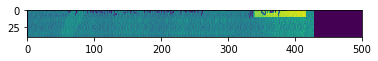

Iteration: 46100 at 2019-04-11 14:21:47.747544


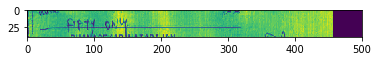

Iteration: 46150 at 2019-04-11 14:21:56.705189


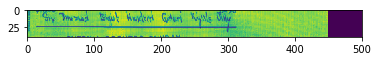

Iteration: 46200 at 2019-04-11 14:22:05.256800


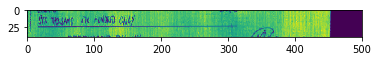

Iteration: 46250 at 2019-04-11 14:22:14.022022


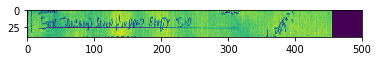

Iteration: 46300 at 2019-04-11 14:22:22.848508


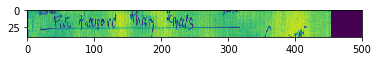

Iteration: 46350 at 2019-04-11 14:22:31.631161


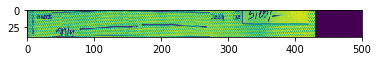

Iteration: 46400 at 2019-04-11 14:22:40.444769


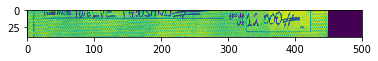

Iteration: 46450 at 2019-04-11 14:22:49.323345


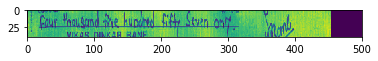

Iteration: 46500 at 2019-04-11 14:22:58.345547


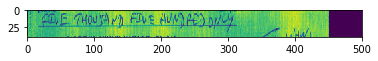

Iteration: 46550 at 2019-04-11 14:23:07.233135


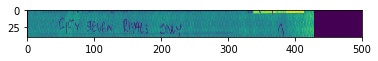

Iteration: 46600 at 2019-04-11 14:23:15.895114


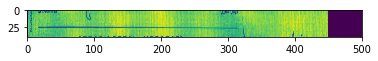

Iteration: 46650 at 2019-04-11 14:23:24.583829


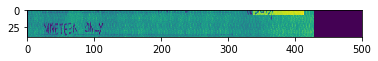

Iteration: 46700 at 2019-04-11 14:23:33.219734


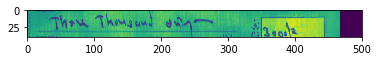

Iteration: 46750 at 2019-04-11 14:23:41.953501


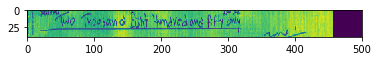

Iteration: 46800 at 2019-04-11 14:23:50.794618


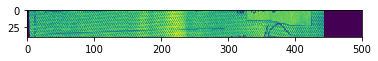

Iteration: 46850 at 2019-04-11 14:23:59.559529


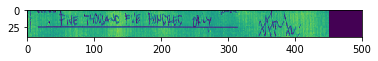

Iteration: 46900 at 2019-04-11 14:24:08.202292


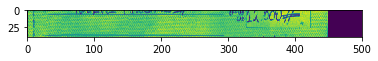

Iteration: 46950 at 2019-04-11 14:24:16.913943


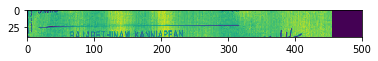

Iteration: 47000 at 2019-04-11 14:24:25.708506


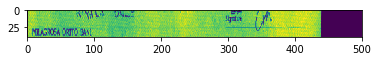

Iteration: 47050 at 2019-04-11 14:24:34.427487


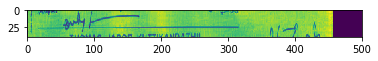

Iteration: 47100 at 2019-04-11 14:24:43.313640


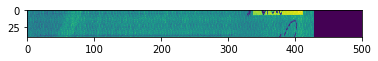

Iteration: 47150 at 2019-04-11 14:24:52.089884


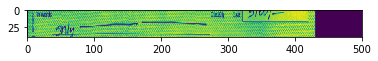

Iteration: 47200 at 2019-04-11 14:25:00.923892


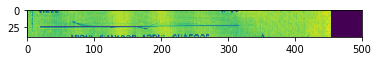

Iteration: 47250 at 2019-04-11 14:25:09.602010


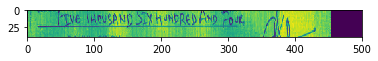

Iteration: 47300 at 2019-04-11 14:25:18.571989


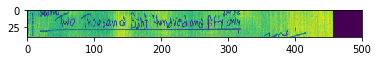

Iteration: 47350 at 2019-04-11 14:25:27.691820


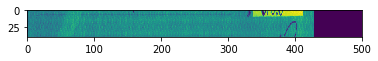

Iteration: 47400 at 2019-04-11 14:25:36.727704


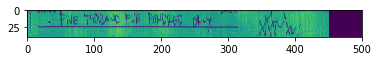

Iteration: 47450 at 2019-04-11 14:25:45.708583


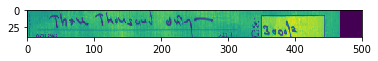

Iteration: 47500 at 2019-04-11 14:25:54.621664


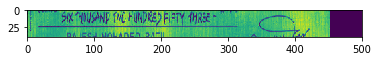

Iteration: 47550 at 2019-04-11 14:26:03.510343


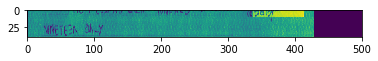

Iteration: 47600 at 2019-04-11 14:26:12.323413


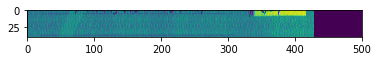

Iteration: 47650 at 2019-04-11 14:26:21.015782


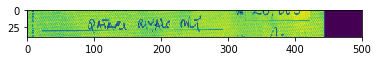

Iteration: 47700 at 2019-04-11 14:26:29.970190


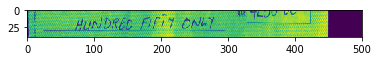

Iteration: 47750 at 2019-04-11 14:26:38.906785


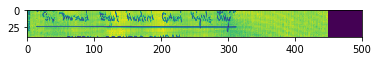

Iteration: 47800 at 2019-04-11 14:26:47.802254


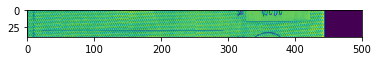

Iteration: 47850 at 2019-04-11 14:26:56.614475


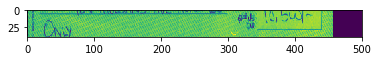

Iteration: 47900 at 2019-04-11 14:27:05.265973


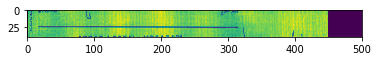

Iteration: 47950 at 2019-04-11 14:27:14.071898


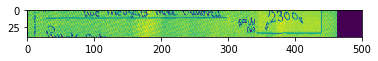

Iteration: 48000 at 2019-04-11 14:27:22.931285


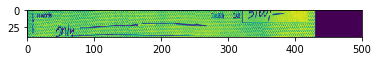

Iteration: 48050 at 2019-04-11 14:27:31.860372


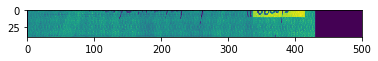

Iteration: 48100 at 2019-04-11 14:27:40.721895


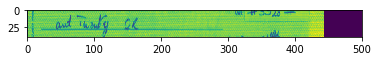

Iteration: 48150 at 2019-04-11 14:27:49.597821


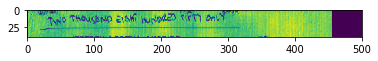

Iteration: 48200 at 2019-04-11 14:27:58.337166


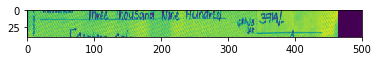

Iteration: 48250 at 2019-04-11 14:28:07.065882


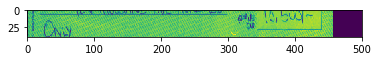

Iteration: 48300 at 2019-04-11 14:28:15.801975


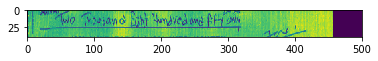

Iteration: 48350 at 2019-04-11 14:28:24.793399


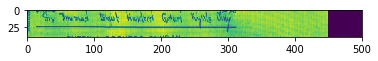

Iteration: 48400 at 2019-04-11 14:28:33.530073


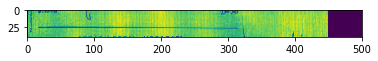

Iteration: 48450 at 2019-04-11 14:28:42.191013


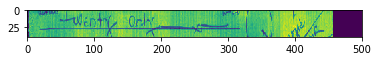

Iteration: 48500 at 2019-04-11 14:28:51.119574


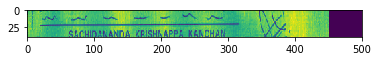

Iteration: 48550 at 2019-04-11 14:28:59.813184


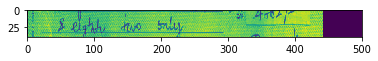

Iteration: 48600 at 2019-04-11 14:29:08.471641


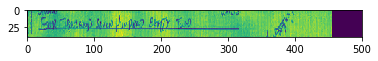

Iteration: 48650 at 2019-04-11 14:29:17.520638


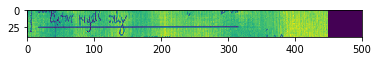

Iteration: 48700 at 2019-04-11 14:29:26.461001


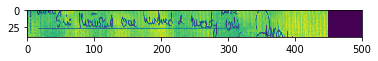

Iteration: 48750 at 2019-04-11 14:29:35.274810


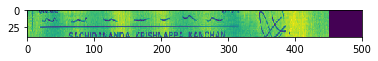

Iteration: 48800 at 2019-04-11 14:29:44.190586


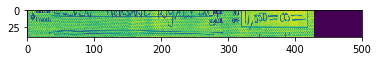

Iteration: 48850 at 2019-04-11 14:29:52.984595


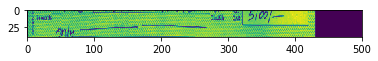

Iteration: 48900 at 2019-04-11 14:30:01.968623


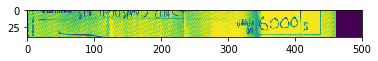

Iteration: 48950 at 2019-04-11 14:30:10.679314


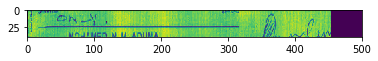

Iteration: 49000 at 2019-04-11 14:30:19.879524


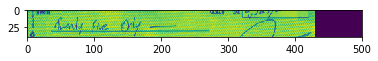

Iteration: 49050 at 2019-04-11 14:30:29.426205


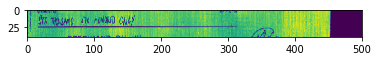

Iteration: 49100 at 2019-04-11 14:30:39.461756


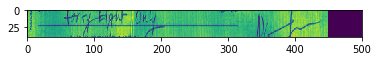

Iteration: 49150 at 2019-04-11 14:30:48.496269


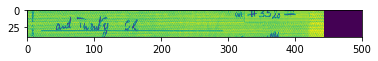

Iteration: 49200 at 2019-04-11 14:30:57.420764


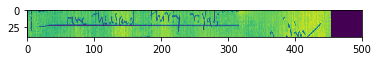

Iteration: 49250 at 2019-04-11 14:31:06.351404


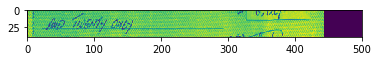

Iteration: 49300 at 2019-04-11 14:31:15.300333


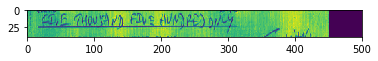

Iteration: 49350 at 2019-04-11 14:31:24.313148


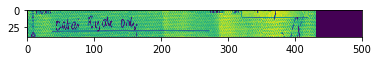

Iteration: 49400 at 2019-04-11 14:31:33.158004


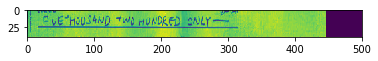

Iteration: 49450 at 2019-04-11 14:31:42.100290


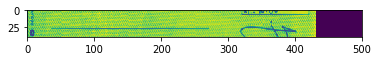

Iteration: 49500 at 2019-04-11 14:31:51.100541


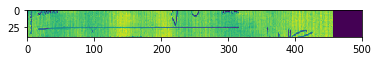

Iteration: 49550 at 2019-04-11 14:32:00.149630


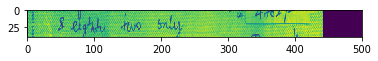

Iteration: 49600 at 2019-04-11 14:32:08.896066


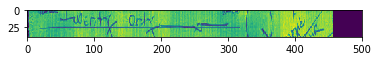

Iteration: 49650 at 2019-04-11 14:32:17.744340


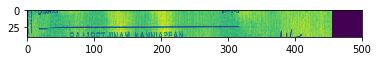

Iteration: 49700 at 2019-04-11 14:32:26.663804


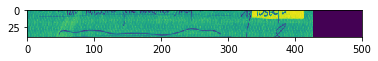

Iteration: 49750 at 2019-04-11 14:32:35.575578


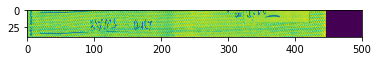

Iteration: 49800 at 2019-04-11 14:32:44.278322


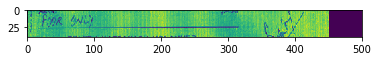

Iteration: 49850 at 2019-04-11 14:32:53.083927


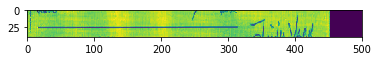

Iteration: 49900 at 2019-04-11 14:33:02.042854


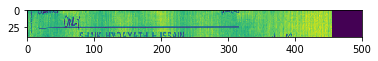

Iteration: 49950 at 2019-04-11 14:33:11.041667


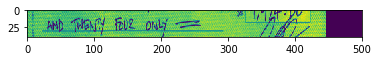

Iteration: 50000 at 2019-04-11 14:33:19.957112


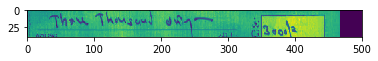

Iteration: 50050 at 2019-04-11 14:33:29.020122


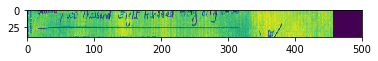

Iteration: 50100 at 2019-04-11 14:33:37.778467


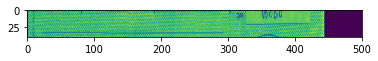

Iteration: 50150 at 2019-04-11 14:33:46.752363


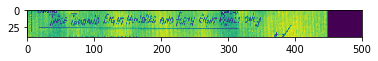

Iteration: 50200 at 2019-04-11 14:33:55.792268


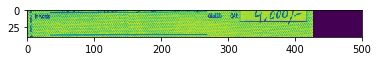

Iteration: 50250 at 2019-04-11 14:34:04.867902


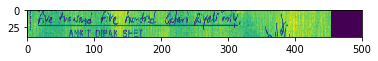

Iteration: 50300 at 2019-04-11 14:34:13.817316


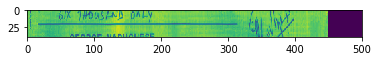

Iteration: 50350 at 2019-04-11 14:34:22.883502


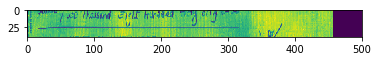

Iteration: 50400 at 2019-04-11 14:34:31.846795


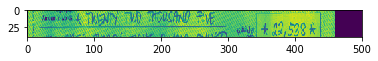

Iteration: 50450 at 2019-04-11 14:34:40.786208


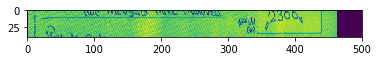

Iteration: 50500 at 2019-04-11 14:34:49.722393


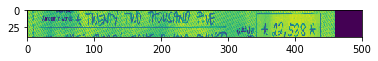

Iteration: 50550 at 2019-04-11 14:34:58.716989


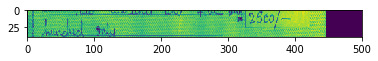

Iteration: 50600 at 2019-04-11 14:35:07.609365


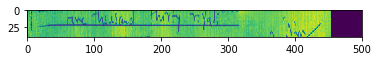

Iteration: 50650 at 2019-04-11 14:35:16.433495


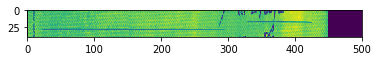

Iteration: 50700 at 2019-04-11 14:35:25.292306


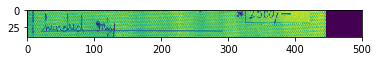

Iteration: 50750 at 2019-04-11 14:35:34.185676


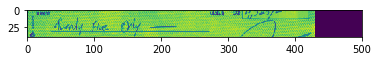

Iteration: 50800 at 2019-04-11 14:35:43.213020


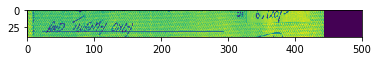

Iteration: 50850 at 2019-04-11 14:35:52.067291


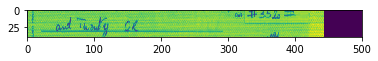

Iteration: 50900 at 2019-04-11 14:36:01.031322


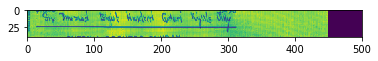

Iteration: 50950 at 2019-04-11 14:36:09.885330


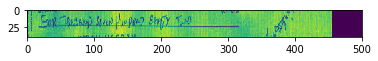

Iteration: 51000 at 2019-04-11 14:36:18.810285


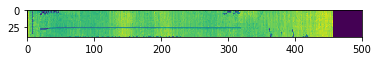

Iteration: 51050 at 2019-04-11 14:36:27.818904


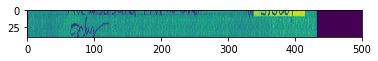

Iteration: 51100 at 2019-04-11 14:36:36.682795


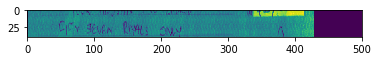

Iteration: 51150 at 2019-04-11 14:36:45.625433


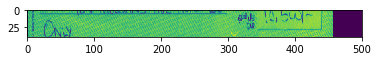

Iteration: 51200 at 2019-04-11 14:36:54.560771


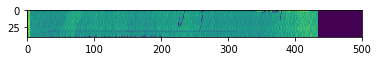

Iteration: 51250 at 2019-04-11 14:37:03.410978


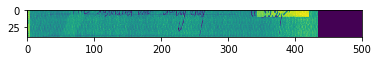

Iteration: 51300 at 2019-04-11 14:37:12.213479


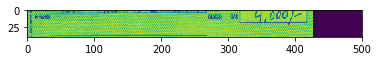

Iteration: 51350 at 2019-04-11 14:37:21.096291


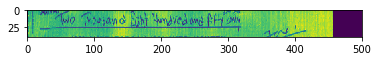

Iteration: 51400 at 2019-04-11 14:37:30.150100


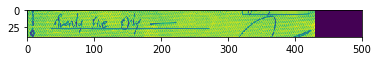

Iteration: 51450 at 2019-04-11 14:37:39.139572


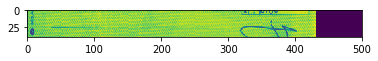

Iteration: 51500 at 2019-04-11 14:37:48.003521


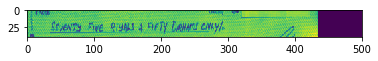

Iteration: 51550 at 2019-04-11 14:37:57.049601


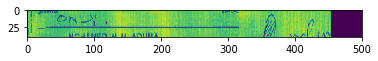

Iteration: 51600 at 2019-04-11 14:38:05.944083


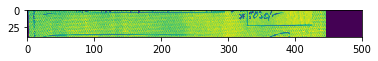

Iteration: 51650 at 2019-04-11 14:38:14.866074


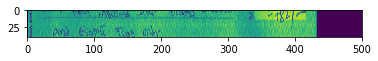

Iteration: 51700 at 2019-04-11 14:38:23.672772


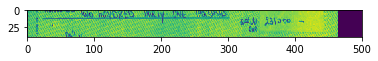

Iteration: 51750 at 2019-04-11 14:38:32.694946


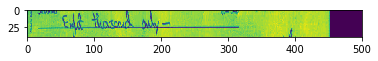

Iteration: 51800 at 2019-04-11 14:38:41.583550


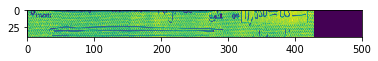

Iteration: 51850 at 2019-04-11 14:38:50.438674


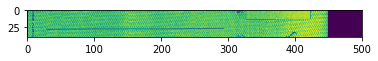

Iteration: 51900 at 2019-04-11 14:38:59.362216


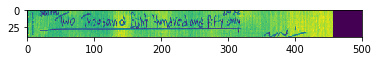

Iteration: 51950 at 2019-04-11 14:39:08.317501


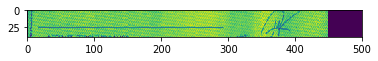

Iteration: 52000 at 2019-04-11 14:39:17.299043


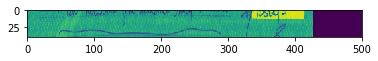

Iteration: 52050 at 2019-04-11 14:39:26.308889


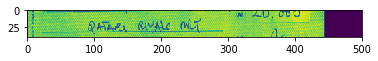

Iteration: 52100 at 2019-04-11 14:39:35.124860


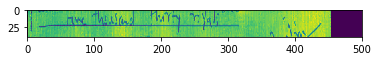

Iteration: 52150 at 2019-04-11 14:39:43.893605


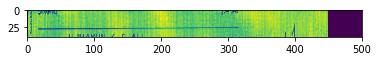

Iteration: 52200 at 2019-04-11 14:39:52.773359


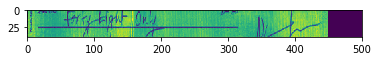

Iteration: 52250 at 2019-04-11 14:40:01.699793


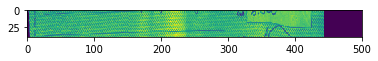

Iteration: 52300 at 2019-04-11 14:40:10.592138


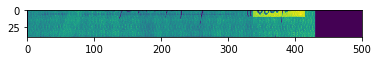

Iteration: 52350 at 2019-04-11 14:40:19.430710


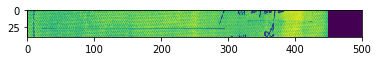

Iteration: 52400 at 2019-04-11 14:40:28.142937


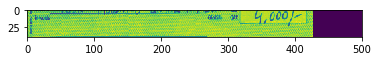

Iteration: 52450 at 2019-04-11 14:40:37.153490


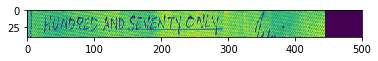

Iteration: 52500 at 2019-04-11 14:40:46.039478


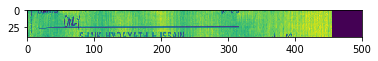

Iteration: 52550 at 2019-04-11 14:40:54.897429


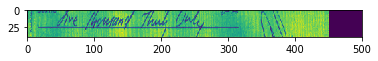

Iteration: 52600 at 2019-04-11 14:41:03.792139


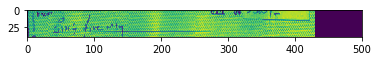

Iteration: 52650 at 2019-04-11 14:41:12.664484


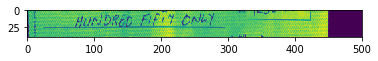

Iteration: 52700 at 2019-04-11 14:41:21.610052


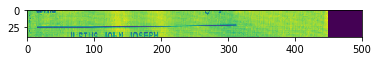

Iteration: 52750 at 2019-04-11 14:41:30.618049


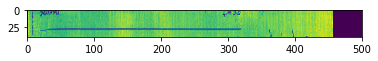

Iteration: 52800 at 2019-04-11 14:41:39.620603


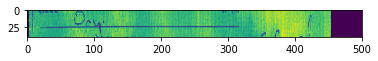

Iteration: 52850 at 2019-04-11 14:41:48.810849


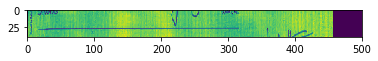

Iteration: 52900 at 2019-04-11 14:41:58.004940


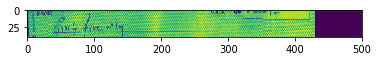

Iteration: 52950 at 2019-04-11 14:42:06.963744


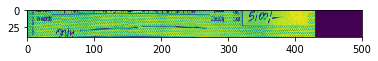

Iteration: 53000 at 2019-04-11 14:42:15.784112


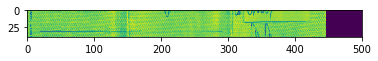

Iteration: 53050 at 2019-04-11 14:42:24.674534


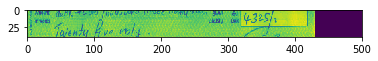

Iteration: 53100 at 2019-04-11 14:42:33.602133


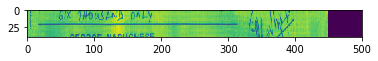

Iteration: 53150 at 2019-04-11 14:42:42.520676


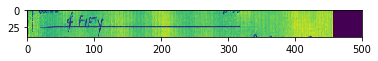

Iteration: 53200 at 2019-04-11 14:42:51.336209


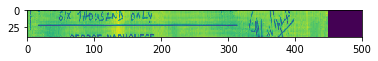

Iteration: 53250 at 2019-04-11 14:43:00.308680


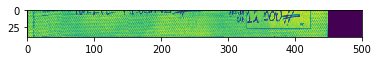

Iteration: 53300 at 2019-04-11 14:43:09.191517


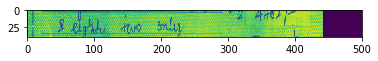

Iteration: 53350 at 2019-04-11 14:43:17.959588


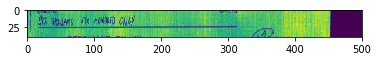

Iteration: 53400 at 2019-04-11 14:43:26.851394


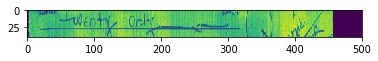

Iteration: 53450 at 2019-04-11 14:43:35.863531


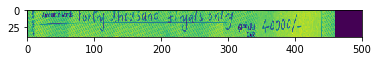

Iteration: 53500 at 2019-04-11 14:43:44.751824


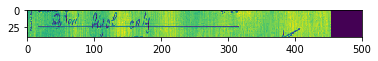

Iteration: 53550 at 2019-04-11 14:43:53.648526


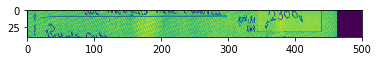

Iteration: 53600 at 2019-04-11 14:44:02.530175


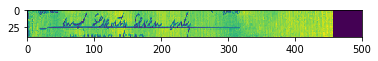

Iteration: 53650 at 2019-04-11 14:44:11.510195


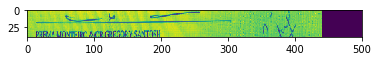

Iteration: 53700 at 2019-04-11 14:44:20.349188


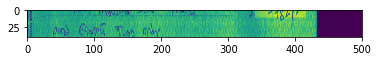

Iteration: 53750 at 2019-04-11 14:44:29.373818


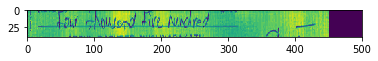

Iteration: 53800 at 2019-04-11 14:44:38.245338


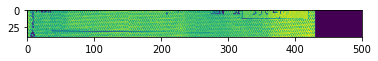

Iteration: 53850 at 2019-04-11 14:44:47.139841


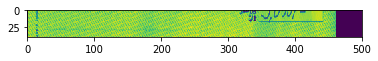

Iteration: 53900 at 2019-04-11 14:44:56.120357


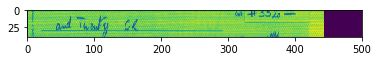

Iteration: 53950 at 2019-04-11 14:45:04.963978


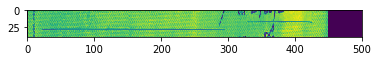

Iteration: 54000 at 2019-04-11 14:45:13.902485


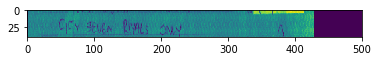

Iteration: 54050 at 2019-04-11 14:45:22.774847


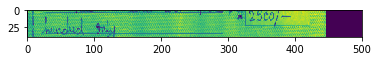

Iteration: 54100 at 2019-04-11 14:45:31.853442


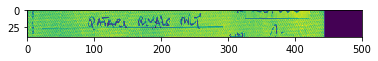

Iteration: 54150 at 2019-04-11 14:45:40.721293


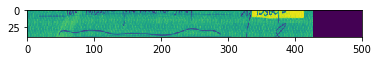

Iteration: 54200 at 2019-04-11 14:45:49.632034


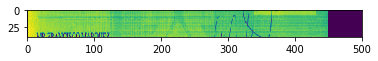

Iteration: 54250 at 2019-04-11 14:45:58.573833


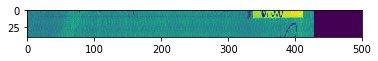

Iteration: 54300 at 2019-04-11 14:46:07.539264


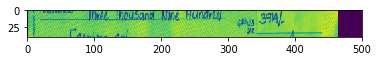

Iteration: 54350 at 2019-04-11 14:46:16.473310


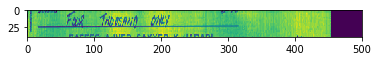

Iteration: 54400 at 2019-04-11 14:46:25.282391


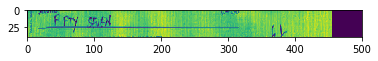

Iteration: 54450 at 2019-04-11 14:46:34.332059


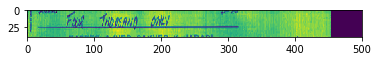

Iteration: 54500 at 2019-04-11 14:46:43.355096


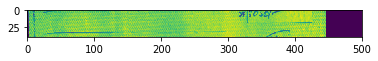

Iteration: 54550 at 2019-04-11 14:46:52.454299


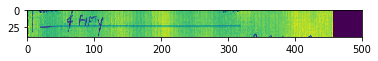

Iteration: 54600 at 2019-04-11 14:47:01.241426


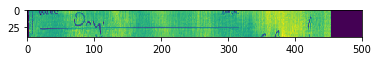

Iteration: 54650 at 2019-04-11 14:47:10.322925


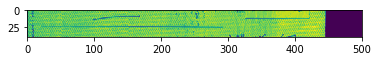

Iteration: 54700 at 2019-04-11 14:47:19.286140


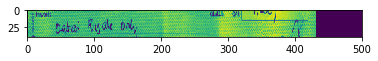

Iteration: 54750 at 2019-04-11 14:47:28.261161


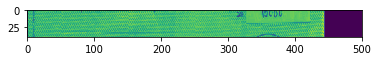

Iteration: 54800 at 2019-04-11 14:47:37.066192


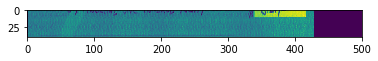

Iteration: 54850 at 2019-04-11 14:47:45.906210


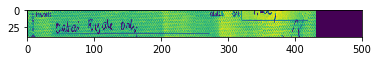

Iteration: 54900 at 2019-04-11 14:47:54.972849


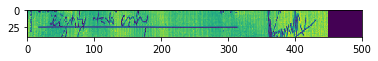

Iteration: 54950 at 2019-04-11 14:48:03.904572


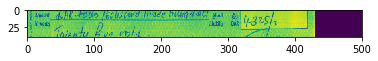

Iteration: 55000 at 2019-04-11 14:48:12.826315


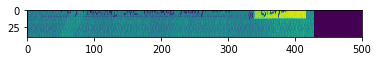

Iteration: 55050 at 2019-04-11 14:48:21.845829


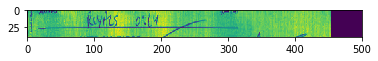

Iteration: 55100 at 2019-04-11 14:48:30.738967


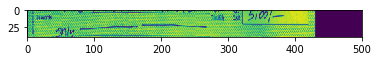

Iteration: 55150 at 2019-04-11 14:48:39.758748


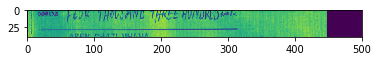

Iteration: 55200 at 2019-04-11 14:48:48.790085


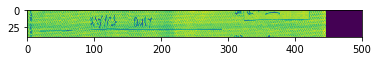

Iteration: 55250 at 2019-04-11 14:48:57.816752


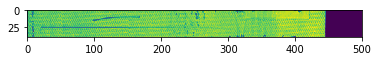

Iteration: 55300 at 2019-04-11 14:49:06.825593


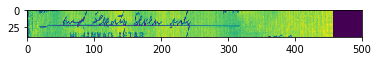

Iteration: 55350 at 2019-04-11 14:49:15.732703


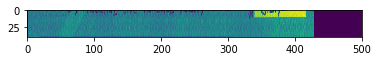

Iteration: 55400 at 2019-04-11 14:49:24.705131


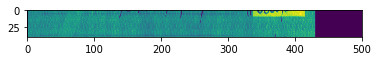

Iteration: 55450 at 2019-04-11 14:49:33.691972


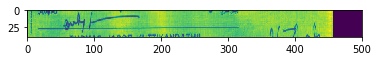

Iteration: 55500 at 2019-04-11 14:49:42.740135


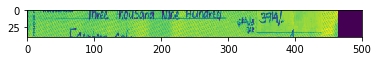

Iteration: 55550 at 2019-04-11 14:49:51.713197


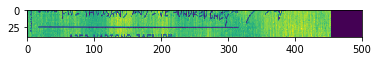

Iteration: 55600 at 2019-04-11 14:50:00.722160


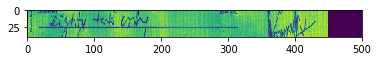

Iteration: 55650 at 2019-04-11 14:50:09.663761


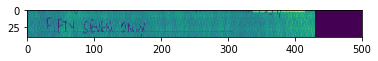

Iteration: 55700 at 2019-04-11 14:50:18.783882


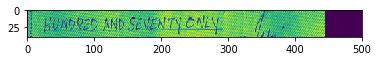

Iteration: 55750 at 2019-04-11 14:50:27.755453


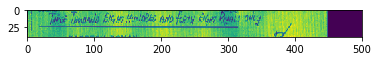

Iteration: 55800 at 2019-04-11 14:50:36.728155


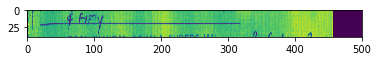

Iteration: 55850 at 2019-04-11 14:50:45.781241


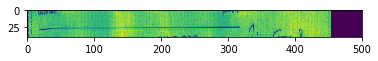

Iteration: 55900 at 2019-04-11 14:50:54.757798


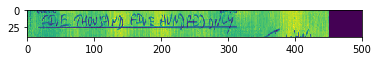

Iteration: 55950 at 2019-04-11 14:51:03.823133


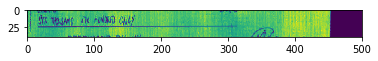

Iteration: 56000 at 2019-04-11 14:51:12.740165


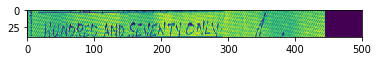

Iteration: 56050 at 2019-04-11 14:51:21.651677


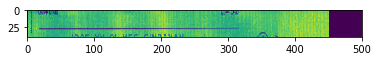

Iteration: 56100 at 2019-04-11 14:51:30.679766


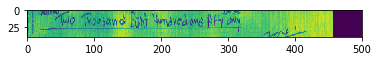

Iteration: 56150 at 2019-04-11 14:51:39.587642


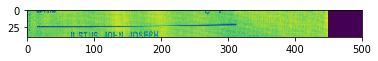

Iteration: 56200 at 2019-04-11 14:51:48.490963


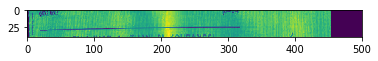

Iteration: 56250 at 2019-04-11 14:51:57.589082


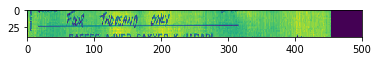

Iteration: 56300 at 2019-04-11 14:52:06.591387


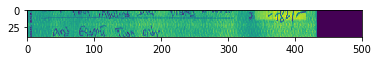

Iteration: 56350 at 2019-04-11 14:52:15.608555


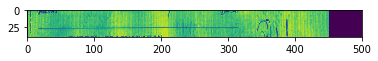

Iteration: 56400 at 2019-04-11 14:52:24.694496


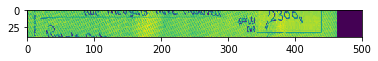

Iteration: 56450 at 2019-04-11 14:52:33.661109


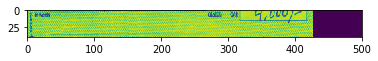

Iteration: 56500 at 2019-04-11 14:52:42.615307


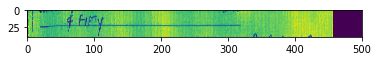

Iteration: 56550 at 2019-04-11 14:52:51.711091


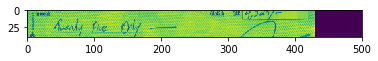

Iteration: 56600 at 2019-04-11 14:53:02.311063


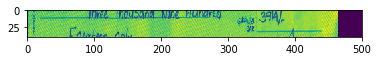

Iteration: 56650 at 2019-04-11 14:53:11.849208


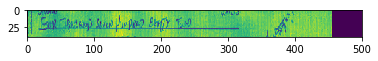

Iteration: 56700 at 2019-04-11 14:53:21.269553


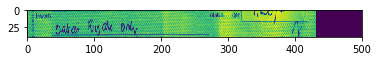

Iteration: 56750 at 2019-04-11 14:53:30.330877


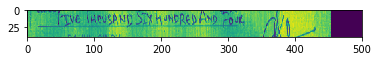

Iteration: 56800 at 2019-04-11 14:53:39.388539


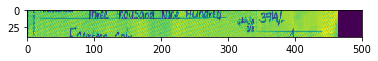

Iteration: 56850 at 2019-04-11 14:53:48.548302


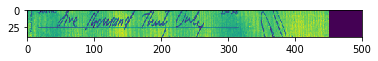

Iteration: 56900 at 2019-04-11 14:53:57.616584


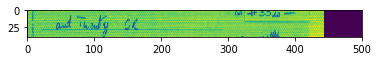

Iteration: 56950 at 2019-04-11 14:54:06.774060


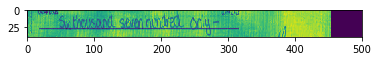

Iteration: 57000 at 2019-04-11 14:54:15.793254


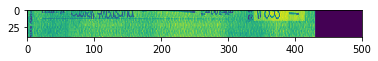

Iteration: 57050 at 2019-04-11 14:54:25.012819


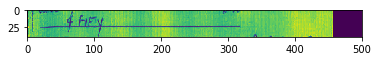

Iteration: 57100 at 2019-04-11 14:54:34.041658


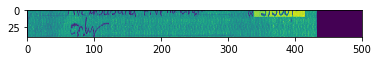

Iteration: 57150 at 2019-04-11 14:54:43.130153


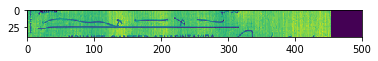

Iteration: 57200 at 2019-04-11 14:54:52.248875


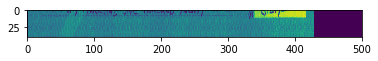

Iteration: 57250 at 2019-04-11 14:55:01.576177


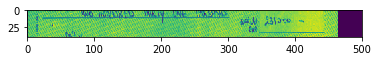

Iteration: 57300 at 2019-04-11 14:55:10.654056


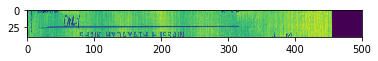

Iteration: 57350 at 2019-04-11 14:55:19.898464


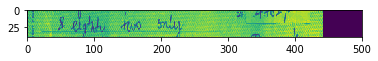

Iteration: 57400 at 2019-04-11 14:55:29.065809


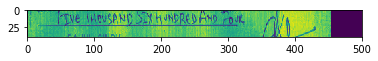

Iteration: 57450 at 2019-04-11 14:55:38.259006


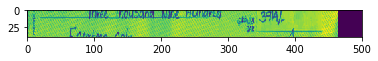

Iteration: 57500 at 2019-04-11 14:55:47.368825


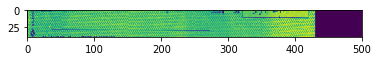

Iteration: 57550 at 2019-04-11 14:55:56.568623


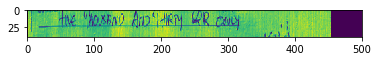

Iteration: 57600 at 2019-04-11 14:56:05.712493


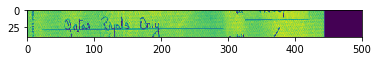

Iteration: 57650 at 2019-04-11 14:56:14.830382


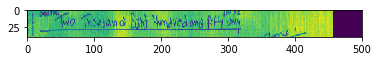

Iteration: 57700 at 2019-04-11 14:56:23.878549


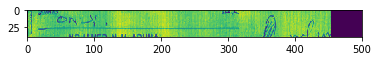

Iteration: 57750 at 2019-04-11 14:56:33.129836


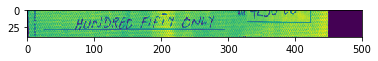

Iteration: 57800 at 2019-04-11 14:56:42.247823


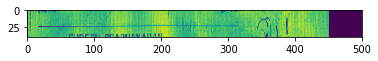

Iteration: 57850 at 2019-04-11 14:56:51.418264


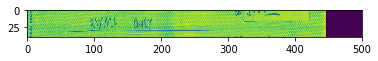

Iteration: 57900 at 2019-04-11 14:57:00.712241


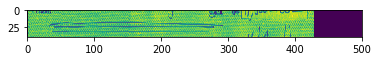

Iteration: 57950 at 2019-04-11 14:57:09.880426


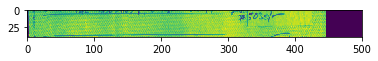

Iteration: 58000 at 2019-04-11 14:57:18.922708


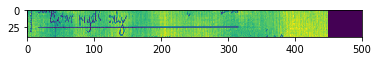

Iteration: 58050 at 2019-04-11 14:57:28.181262


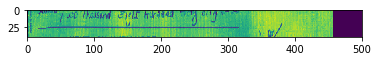

Iteration: 58100 at 2019-04-11 14:57:37.272787


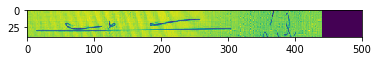

Iteration: 58150 at 2019-04-11 14:57:46.455944


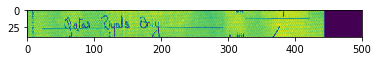

Iteration: 58200 at 2019-04-11 14:57:55.596734


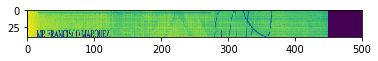

Iteration: 58250 at 2019-04-11 14:58:04.623495


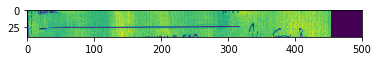

Iteration: 58300 at 2019-04-11 14:58:13.796724


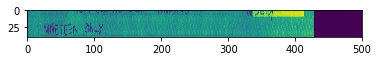

Iteration: 58350 at 2019-04-11 14:58:22.825984


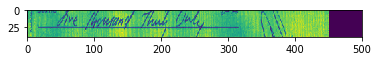

Iteration: 58400 at 2019-04-11 14:58:31.956193


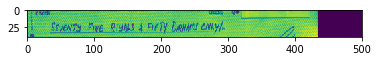

Iteration: 58450 at 2019-04-11 14:58:41.042404


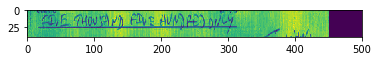

Iteration: 58500 at 2019-04-11 14:58:50.093019


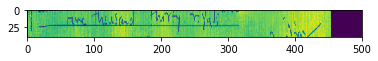

Iteration: 58550 at 2019-04-11 14:58:59.326942


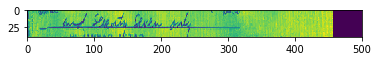

Iteration: 58600 at 2019-04-11 14:59:08.425650


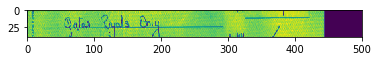

Iteration: 58650 at 2019-04-11 14:59:17.550701


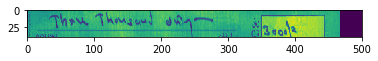

Iteration: 58700 at 2019-04-11 14:59:26.804349


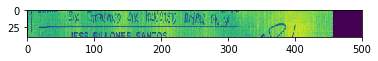

Iteration: 58750 at 2019-04-11 14:59:35.925202


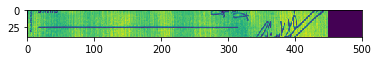

Iteration: 58800 at 2019-04-11 14:59:45.115874


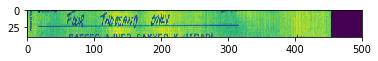

Iteration: 58850 at 2019-04-11 14:59:54.212861


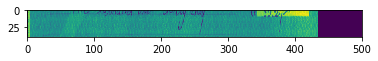

Iteration: 58900 at 2019-04-11 15:00:03.287557


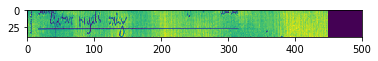

Iteration: 58950 at 2019-04-11 15:00:12.506391


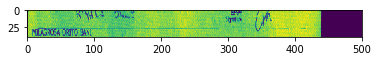

Iteration: 59000 at 2019-04-11 15:00:21.626684


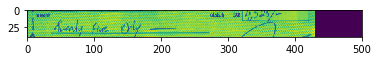

Iteration: 59050 at 2019-04-11 15:00:30.674705


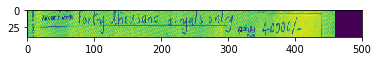

Iteration: 59100 at 2019-04-11 15:00:39.790570


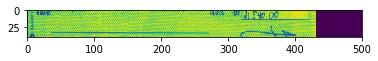

Iteration: 59150 at 2019-04-11 15:00:48.910982


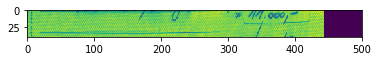

Iteration: 59200 at 2019-04-11 15:00:58.197632


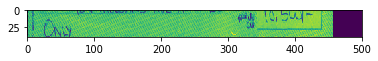

Iteration: 59250 at 2019-04-11 15:01:07.615768


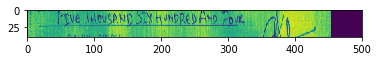

Iteration: 59300 at 2019-04-11 15:01:16.754900


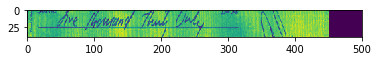

Iteration: 59350 at 2019-04-11 15:01:25.991284


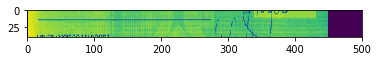

Iteration: 59400 at 2019-04-11 15:01:35.153124


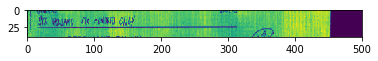

Iteration: 59450 at 2019-04-11 15:01:44.353471


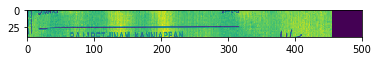

Iteration: 59500 at 2019-04-11 15:01:53.442358


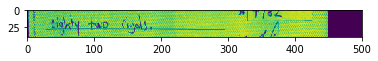

Iteration: 59550 at 2019-04-11 15:02:02.627531


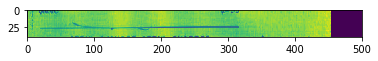

Iteration: 59600 at 2019-04-11 15:02:11.717159


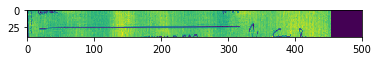

Iteration: 59650 at 2019-04-11 15:02:20.924034


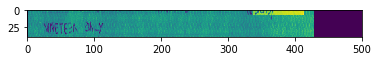

Iteration: 59700 at 2019-04-11 15:02:30.026308


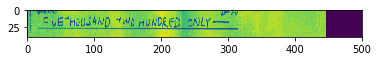

Iteration: 59750 at 2019-04-11 15:02:39.180362


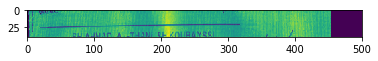

Iteration: 59800 at 2019-04-11 15:02:48.162264


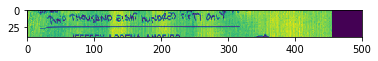

Iteration: 59850 at 2019-04-11 15:02:57.295133


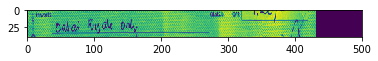

Iteration: 59900 at 2019-04-11 15:03:06.342409


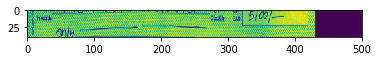

Iteration: 59950 at 2019-04-11 15:03:15.465822


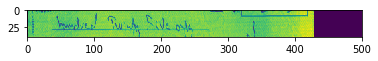

Iteration: 60000 at 2019-04-11 15:03:24.456051


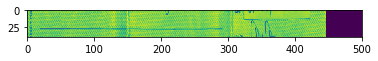

Iteration: 60050 at 2019-04-11 15:03:33.574960


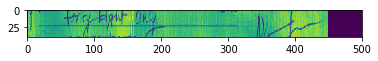

Iteration: 60100 at 2019-04-11 15:03:42.688632


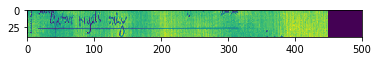

Iteration: 60150 at 2019-04-11 15:03:51.816820


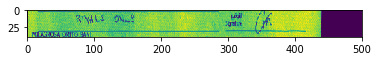

Iteration: 60200 at 2019-04-11 15:04:00.934847


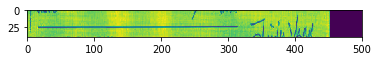

Iteration: 60250 at 2019-04-11 15:04:09.992007


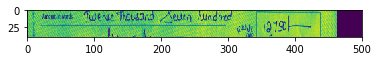

Iteration: 60300 at 2019-04-11 15:04:19.369274


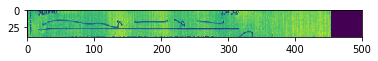

Iteration: 60350 at 2019-04-11 15:04:28.764740


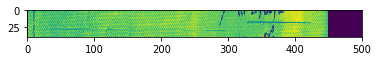

Iteration: 60400 at 2019-04-11 15:04:38.152899


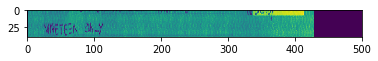

Iteration: 60450 at 2019-04-11 15:04:47.314175


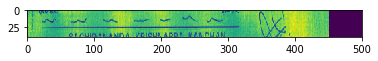

Iteration: 60500 at 2019-04-11 15:04:56.465425


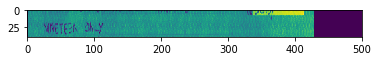

Iteration: 60550 at 2019-04-11 15:05:05.589708


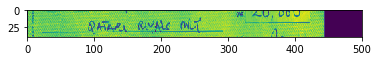

Iteration: 60600 at 2019-04-11 15:05:14.605640


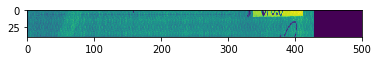

Iteration: 60650 at 2019-04-11 15:05:23.779258


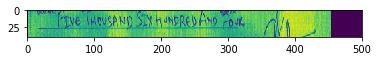

Iteration: 60700 at 2019-04-11 15:05:33.012314


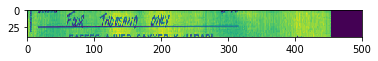

Iteration: 60750 at 2019-04-11 15:05:42.112820


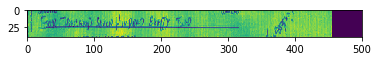

Iteration: 60800 at 2019-04-11 15:05:51.263525


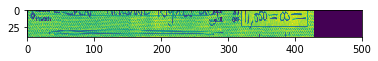

Iteration: 60850 at 2019-04-11 15:06:00.456918


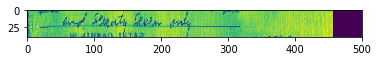

Iteration: 60900 at 2019-04-11 15:06:09.516994


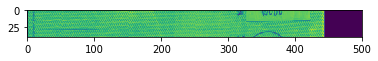

Iteration: 60950 at 2019-04-11 15:06:18.698835


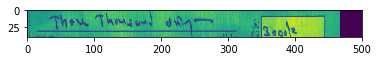

Iteration: 61000 at 2019-04-11 15:06:27.896000


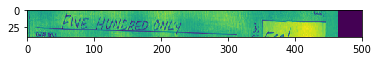

Iteration: 61050 at 2019-04-11 15:06:37.084404


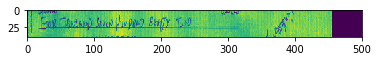

Iteration: 61100 at 2019-04-11 15:06:46.192144


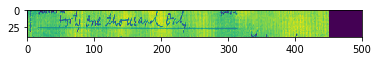

Iteration: 61150 at 2019-04-11 15:06:55.413797


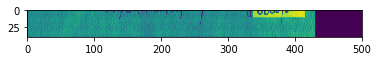

Iteration: 61200 at 2019-04-11 15:07:04.569255


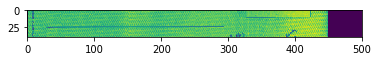

Iteration: 61250 at 2019-04-11 15:07:13.692606


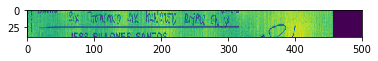

Iteration: 61300 at 2019-04-11 15:07:22.837234


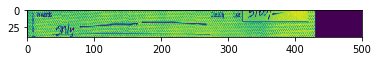

Iteration: 61350 at 2019-04-11 15:07:32.080980


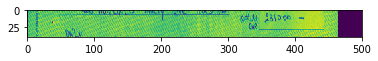

Iteration: 61400 at 2019-04-11 15:07:41.146518


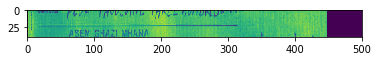

Iteration: 61450 at 2019-04-11 15:07:50.278188


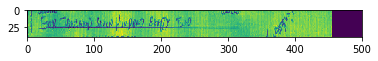

Iteration: 61500 at 2019-04-11 15:07:59.470128


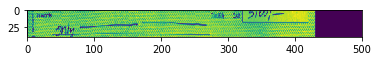

Iteration: 61550 at 2019-04-11 15:08:08.697463


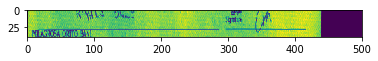

Iteration: 61600 at 2019-04-11 15:08:17.811678


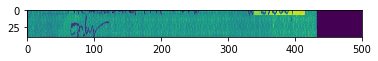

Iteration: 61650 at 2019-04-11 15:08:26.939840


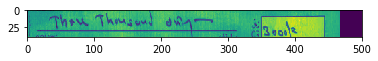

Iteration: 61700 at 2019-04-11 15:08:36.069434


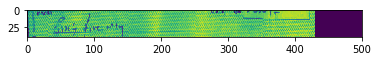

Iteration: 61750 at 2019-04-11 15:08:45.213326


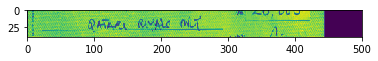

Iteration: 61800 at 2019-04-11 15:08:54.506904


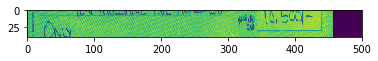

Iteration: 61850 at 2019-04-11 15:09:03.636868


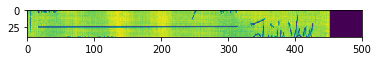

Iteration: 61900 at 2019-04-11 15:09:12.744522


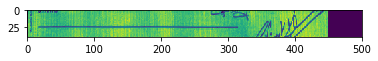

Iteration: 61950 at 2019-04-11 15:09:21.884674


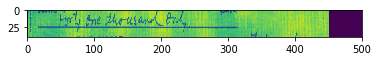

Iteration: 62000 at 2019-04-11 15:09:31.014051


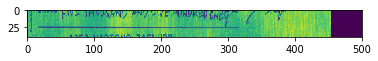

Iteration: 62050 at 2019-04-11 15:09:40.195054


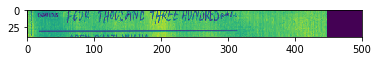

Iteration: 62100 at 2019-04-11 15:09:49.377582


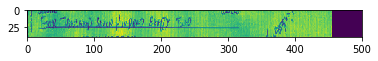

Iteration: 62150 at 2019-04-11 15:09:58.642712


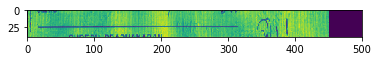

Iteration: 62200 at 2019-04-11 15:10:07.801527


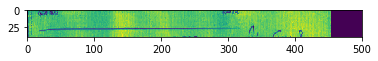

Iteration: 62250 at 2019-04-11 15:10:16.999708


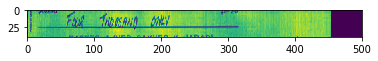

Iteration: 62300 at 2019-04-11 15:10:26.196479


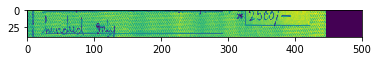

Iteration: 62350 at 2019-04-11 15:10:35.469699


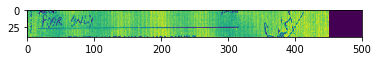

Iteration: 62400 at 2019-04-11 15:10:44.572662


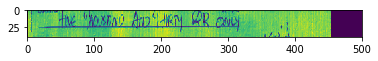

Iteration: 62450 at 2019-04-11 15:10:53.763198


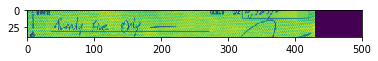

Iteration: 62500 at 2019-04-11 15:11:02.976057


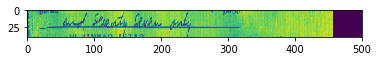

Iteration: 62550 at 2019-04-11 15:11:12.174245


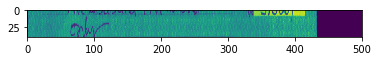

Iteration: 62600 at 2019-04-11 15:11:21.275410


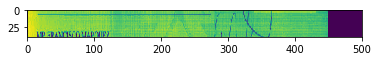

Iteration: 62650 at 2019-04-11 15:11:30.479393


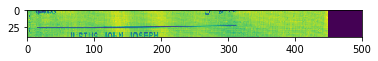

Iteration: 62700 at 2019-04-11 15:11:39.747807


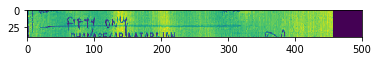

Iteration: 62750 at 2019-04-11 15:11:48.873444


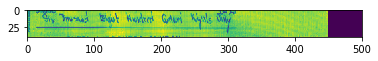

Iteration: 62800 at 2019-04-11 15:11:58.099856


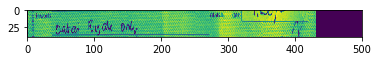

Iteration: 62850 at 2019-04-11 15:12:07.339573


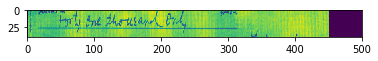

Iteration: 62900 at 2019-04-11 15:12:16.570842


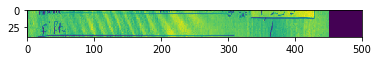

Iteration: 62950 at 2019-04-11 15:12:26.014521


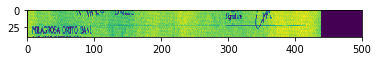

Iteration: 63000 at 2019-04-11 15:12:35.215269


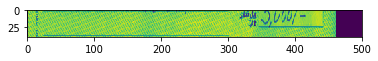

Iteration: 63050 at 2019-04-11 15:12:44.379299


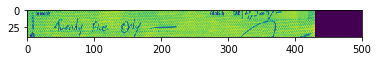

Iteration: 63100 at 2019-04-11 15:12:53.472051


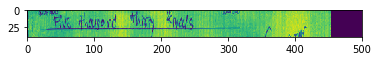

Iteration: 63150 at 2019-04-11 15:13:02.756220


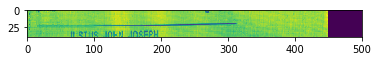

Iteration: 63200 at 2019-04-11 15:13:11.916544


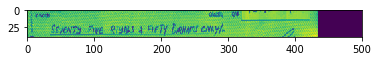

Iteration: 63250 at 2019-04-11 15:13:21.266403


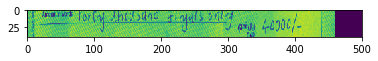

Iteration: 63300 at 2019-04-11 15:13:30.494404


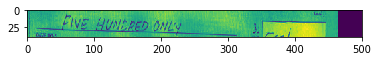

Iteration: 63350 at 2019-04-11 15:13:39.675767


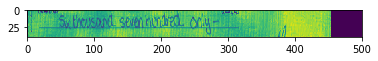

Iteration: 63400 at 2019-04-11 15:13:48.966605


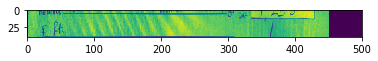

Iteration: 63450 at 2019-04-11 15:13:58.152374


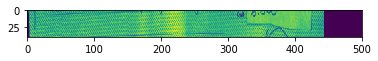

Iteration: 63500 at 2019-04-11 15:14:07.356674


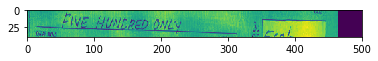

Iteration: 63550 at 2019-04-11 15:14:16.453268


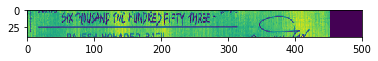

Iteration: 63600 at 2019-04-11 15:14:25.612777


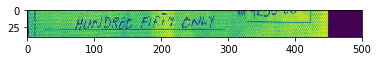

Iteration: 63650 at 2019-04-11 15:14:34.809182


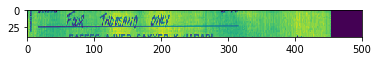

Iteration: 63700 at 2019-04-11 15:14:43.805515


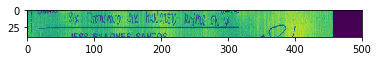

Iteration: 63750 at 2019-04-11 15:14:53.107146


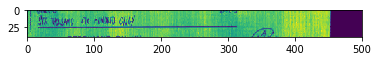

Iteration: 63800 at 2019-04-11 15:15:02.335000


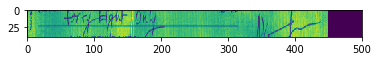

Iteration: 63850 at 2019-04-11 15:15:11.495704


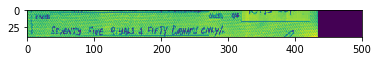

Iteration: 63900 at 2019-04-11 15:15:20.625734


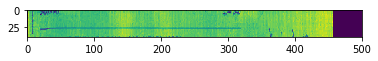

Iteration: 63950 at 2019-04-11 15:15:29.900445


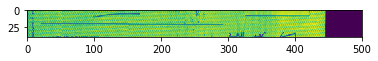

Iteration: 64000 at 2019-04-11 15:15:39.379867


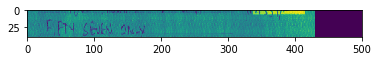

Iteration: 64050 at 2019-04-11 15:15:48.932000


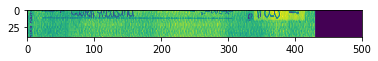

Iteration: 64100 at 2019-04-11 15:15:58.431249


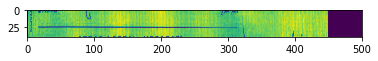

Iteration: 64150 at 2019-04-11 15:16:07.920477


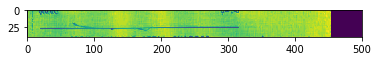

Iteration: 64200 at 2019-04-11 15:16:17.112464


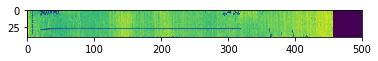

Iteration: 64250 at 2019-04-11 15:16:26.531808


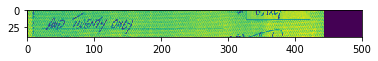

Iteration: 64300 at 2019-04-11 15:16:35.696315


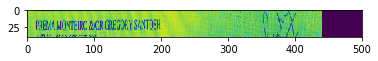

Iteration: 64350 at 2019-04-11 15:16:44.841469


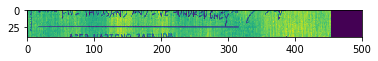

Iteration: 64400 at 2019-04-11 15:16:54.191519


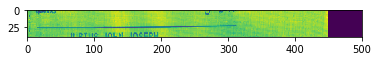

Iteration: 64450 at 2019-04-11 15:17:03.359077


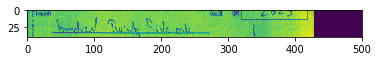

Iteration: 64500 at 2019-04-11 15:17:12.600006


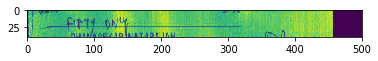

Iteration: 64550 at 2019-04-11 15:17:21.782495


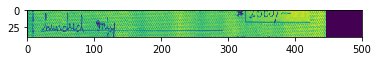

Iteration: 64600 at 2019-04-11 15:17:30.993438


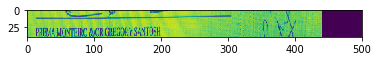

Iteration: 64650 at 2019-04-11 15:17:40.189445


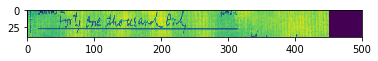

Iteration: 64700 at 2019-04-11 15:17:49.436061


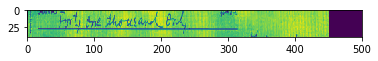

Iteration: 64750 at 2019-04-11 15:17:58.722640


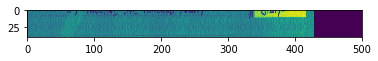

Iteration: 64800 at 2019-04-11 15:18:07.972051


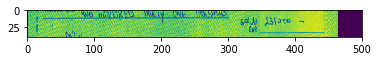

Iteration: 64850 at 2019-04-11 15:18:17.212018


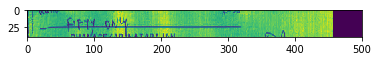

Iteration: 64900 at 2019-04-11 15:18:26.533188


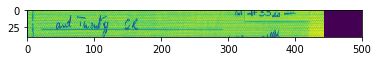

Iteration: 64950 at 2019-04-11 15:18:35.904871


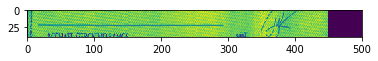

Iteration: 65000 at 2019-04-11 15:18:45.127606


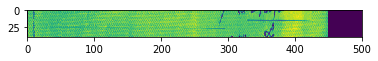

Iteration: 65050 at 2019-04-11 15:18:54.462153


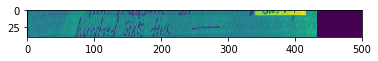

Iteration: 65100 at 2019-04-11 15:19:05.045491


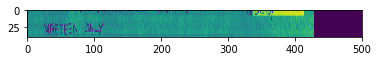

Iteration: 65150 at 2019-04-11 15:19:14.417734


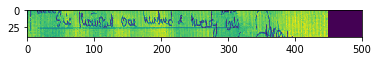

Iteration: 65200 at 2019-04-11 15:19:23.829993


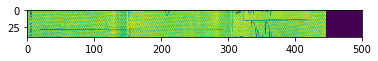

Iteration: 65250 at 2019-04-11 15:19:33.378497


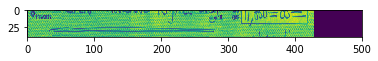

Iteration: 65300 at 2019-04-11 15:19:42.760921


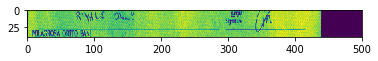

Iteration: 65350 at 2019-04-11 15:19:52.353592


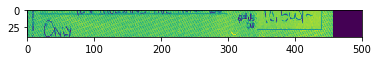

Iteration: 65400 at 2019-04-11 15:20:01.762853


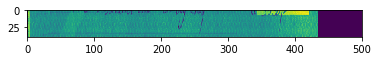

Iteration: 65450 at 2019-04-11 15:20:11.214645


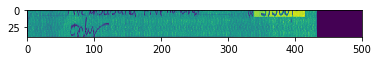

Iteration: 65500 at 2019-04-11 15:20:20.487222


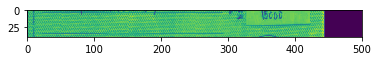

Iteration: 65550 at 2019-04-11 15:20:29.985013


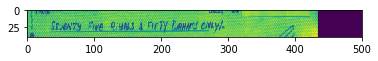

Iteration: 65600 at 2019-04-11 15:20:39.253980


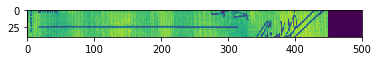

Iteration: 65650 at 2019-04-11 15:20:48.721829


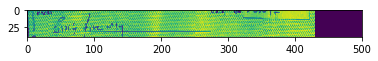

Iteration: 65700 at 2019-04-11 15:20:58.090632


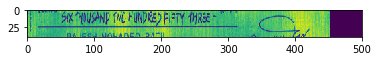

Iteration: 65750 at 2019-04-11 15:21:07.525968


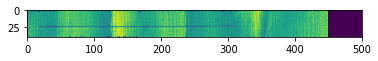

Iteration: 65800 at 2019-04-11 15:21:16.808764


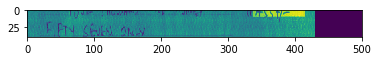

Iteration: 65850 at 2019-04-11 15:21:26.321122


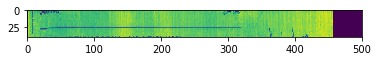

Iteration: 65900 at 2019-04-11 15:21:35.645415


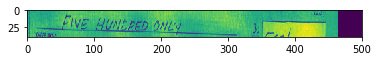

Iteration: 65950 at 2019-04-11 15:21:45.108472


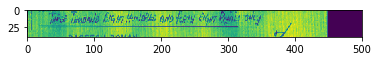

In [6]:

# Train ltm_predictor and discriminator together
for i in range(66000):
    #images, lines , ids = next(train_gen)
    #images = np.array(images)
    #ltm_images, l_true = ltm_img_processor(images,lines)
    #real_images =  real_images_processor(images, lines)
    
    
    # Train discriminator on both real and fake images
    ##_, __, dLossReal, dLossFake = sess.run([d_trainer_real, d_trainer_fake, d_loss_real, d_loss_fake],
    ##                                       {real_images_ph:real_images ,images_ph:images, ltm_images_ph:ltm_images })
                                           

    # Train ltm_predictor
    
    images, heights, widths, lines , ids = next(train_gen)
    images = np.array(images)
    ltm_images, l_true = ltm_img_processor(images, heights, widths, lines)
    _ = sess.run(p_mse_trainer, feed_dict={images_ph:images, ltm_images_ph:ltm_images, l_true_ph:l_true })

    if i % 10 == 0:
        # Update TensorBoard with summary statistics
        images, heights, widths, lines , ids = next(train_gen)
        images = np.array(images)
        ltm_images, l_true = ltm_img_processor(images, heights, widths, lines)
        #real_images =  real_images_processor(images, lines)
        
        #summary = sess.run(merged, {real_images_ph:real_images ,images_ph:images, ltm_images_ph:ltm_images, l_true_ph:l_true })
        summary = sess.run(merged, {images_ph:images, ltm_images_ph:ltm_images, l_true_ph:l_true })
        writer.add_summary(summary, i)
        
        
        
        images, heights, widths, lines , ids = next(valid_gen)
        images = np.array(images)
        ltm_images, l_true = ltm_img_processor(images, heights, widths, lines)
        summary= sess.run(merged_valid, {images_ph:images, ltm_images_ph:ltm_images, l_true_ph:l_true })
        writer.add_summary(summary, i)
        #summary= sess.run(merged_valid2, {images_ph:images, ltm_images_ph:ltm_images, l_true_ph:l_true })
        #writer.add_summary(summary, i)

    if i % 50 == 0:
        # Every 100 iterations, show a predicted image
        print("Iteration:", i, "at", datetime.datetime.now())
        images, heights, widths, lines , ids = next(valid_gen)
        images = np.array(images)
        ltm_images, l_true = ltm_img_processor(images, heights, widths, lines)
        
        fake_images, _  = fake_images_generator(images_ph,l_pred,1)
        
        images = sess.run(fake_images, {images_ph:images, ltm_images_ph:ltm_images,l_true_ph:l_true})
        plt.imshow(np.squeeze(images[0]))#, cmap='Greys')
        plt.show()

        # Show discriminator's estimate
        #im = images[0].reshape([1, 40, 500, 1])
        #result = discriminator(real_images_ph)
        #estimate = sess.run(result, {real_images_ph: im})
        #print("Estimate:", estimate)

In [7]:
saver = tf.train.Saver(var_list=p_vars)


In [8]:
saver.save(sess, "./ltm_predictor_vanila", global_step=1000, write_meta_graph=True)

'./ltm_predictor_vanila-1000'

In [8]:
import tensorflow as tf
from  tensorflow.python.tools import inspect_checkpoint as chkp

chkp.print_tensors_in_checkpoint_file("./ltm_predictor_vanila-1000", tensor_name='',all_tensor_names='', all_tensors=True)


tensor_name:  p_b1
[ 0.0074508  -0.00078802 -0.00053457  0.00909576  0.01070373 -0.02089691
  0.02473869 -0.01640569  0.01051898 -0.00191547 -0.01712941 -0.00151812
 -0.00916917  0.03065042  0.03089344  0.02270448  0.00605121 -0.00699794
  0.03408359 -0.00420109 -0.02609763 -0.00100669  0.00757781  0.00477456
  0.02199164 -0.00407383  0.01188228 -0.00490951 -0.0075067  -0.03457584
 -0.02346218  0.01234476  0.02006726 -0.0251112   0.00473836 -0.00762497
 -0.01133773 -0.02834242 -0.03648968  0.03126654  0.01164471  0.01431818
  0.01595562 -0.00301629  0.00523891  0.02278407 -0.0083625   0.02199083
 -0.03634609  0.01643132  0.01244347  0.00307014  0.00787309 -0.03273728
  0.001212    0.00755512 -0.00491975 -0.01332611 -0.01408172 -0.00032074
  0.0148878   0.00065071  0.03920543  0.02941069]
tensor_name:  p_b2
[ 3.3213094e-02  1.1543469e-02 -2.5019189e-02 -8.5467650e-03
 -1.7024692e-02  7.0509611e-04  2.3408096e-02 -2.4197206e-03
 -3.3713257e-04  9.0118665e-03 -3.1368339e-03  1.4224228e-02

In [1]:
from dataset import load_dataset,main_generator
from models import ltm_predictor
from modelsUtils import fake_images_generator
from image_processor import ltm_img_processor
import numpy as np
import tensorflow as tf
import  matplotlib.pyplot as plt
batch_size=2
db,  train_db, valid_db = load_dataset()
train_gen = main_generator(batch_size=batch_size,db=train_db)
valid_gen = main_generator(batch_size=batch_size,db=valid_db)


/home/paperspace/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


Total # of images in the dataset:  1492
Go for training 1372
Go for validating 120


In [2]:
tf.reset_default_graph()

# Create some variables.

batch_size= 2

#ltm ltm_predictor placeholders
ltm_images_ph = tf.placeholder(tf.float32,[None, 124,124,1])
l_true_ph = tf.placeholder(tf.float32,[None, 3])

#discriminator placeholders
real_images_ph = tf.placeholder(tf.float32,[None, 40,500,1])
images_ph =tf.placeholder(tf.float32,[None, 750,1600,1])



l_pred = ltm_predictor(ltm_images_ph)
fake_images, _  = fake_images_generator(images_ph,l_pred,batch_size)


tvars = tf.trainable_variables()

d_vars = [var for var in tvars if 'd_' in var.name]
p_vars = [var for var in tvars if 'p_' in var.name]




Instructions for updating:
Use the retry module or similar alternatives.


INFO:tensorflow:Restoring parameters from ./ltm_predictor_vanila-1000
Model restored.
[[0.37499112 0.49636006 0.6252075 ]
 [0.43948358 0.52918386 0.64351475]]


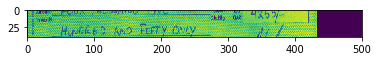

In [3]:
images, heights, widths, lines , ids = next(valid_gen)
images = np.array(images)
ltm_images, l_true = ltm_img_processor(images, heights, widths,lines)
# Add ops to save and restore all the variables.
saver = tf.train.Saver(p_vars)
ops =tf.global_variables_initializer()

# Later, launch the model, use the saver to restore variables from disk, and
# do some work with the model.
with tf.Session() as sess:
    # Restore variables from disk.
    sess.run(ops)
    saver.restore(sess, "./ltm_predictor_vanila-1000",)
    print("Model restored.")
    # Check the values of the variables
    l_pred_v, images = sess.run([l_pred,fake_images], {images_ph:images, ltm_images_ph:ltm_images})
    print(l_pred_v)
    plt.imshow(np.squeeze(images[0]))#, cmap='Greys')
    plt.show()
